# Bidirectional Recurrent Neural Network

Đặc ra vấn đề ở ngôn ngữ không chỉ việc dựa từ trước để dự đoán từ tiếp theo, mà nó cũng có vai trò ngược lại

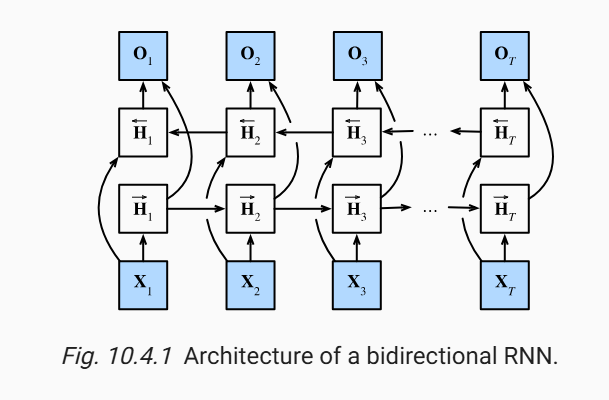

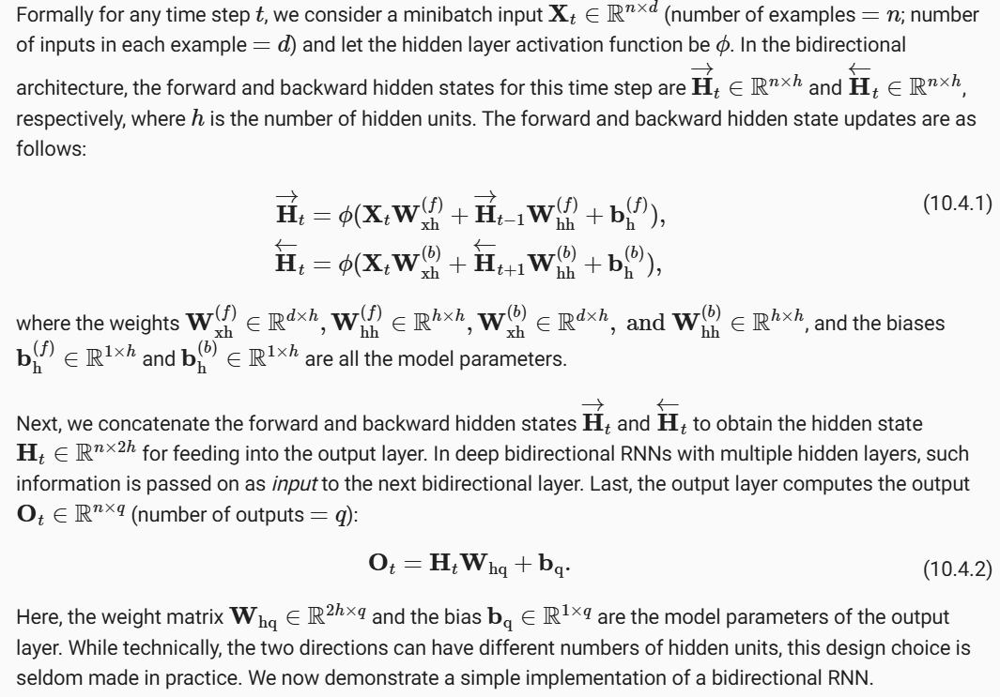

Trong thực tế, các tầng hai chiều được sử dụng rất ít và chỉ dành cho một số ít ứng dụng, chẳng hạn như **điền từ còn thiếu**, **chú thích token** (ví dụ cho nhận dạng thực thể có tên) hoặc **mã hóa nguyên chuỗi tại một bước trong pipeline xử lý chuỗi** (ví dụ trong dịch máy). Tóm lại, hãy sử dụng nó một cách cẩn thận!

In [ ]:
!pip install d2l

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.9/58.9 kB 1.3 MB/s eta 0:00:00
  Using cached jedi-0.19.1-py2.py3-none-any.whl.metadata (22 kB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 111.7/111.7 kB 2.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.6/11.6 MB 21.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.1/17.1 MB 19.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.3/12.3 MB 37.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.6/62.6 kB 3.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 34.4/34.4 MB 12.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 98.3/98.3 kB 3.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 124.7/124.7 kB 5.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 93.5/93.5 kB 3.6 MB/s eta 0:00:00
Using cached jedi-0.19.1-py2.py3-none-any.whl (1.6 MB)
  Attempting uninstall: requests
    Found existing installation: requests 2.32.3
    Unin

In [ ]:
import torch
from torch import nn
from d2l import torch as d2l

In [ ]:
class BiRNNScratch(d2l.Module):
  def __init__(self, num_inputs, num_hiddens, sigma=0.01):
    super().__init__()
    self.save_hyperparameters()
    self.f_rnn = d2l.RNNScratch(num_inputs, num_hiddens, sigma)
    self.b_rnn = d2l.RNNScratch(num_inputs, num_hiddens, sigma)
    self.num_hiddens *= 2
  def forward(self, inputs, Hs=None):
    f_H, b_H = Hs if Hs is not None else (None, None)
    f_outputs, f_H = self.f_rnn(inputs, f_H)
    b_outputs, b_H = self.b_rnn(reversed(inputs), b_H) # reversed dao nguoc input
    outputs = [torch.cat((f, b), -1) for f, b in zip(
        f_outputs, reversed(b_outputs))]
    return outputs, (f_H, b_H)

In [ ]:
class BiGRU(d2l.RNN):
    def __init__(self, num_inputs, num_hiddens):
        d2l.Module.__init__(self)
        self.save_hyperparameters()
        self.rnn = nn.GRU(num_inputs, num_hiddens, bidirectional=True)
        self.num_hiddens *= 2

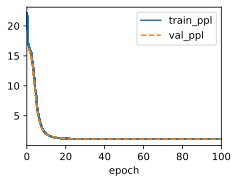

In [ ]:
data = d2l.TimeMachine(batch_size=1024, num_steps=32)
gru = BiGRU(num_inputs=len(data.vocab), num_hiddens=32)
model = d2l.RNNLM(gru, vocab_size=len(data.vocab), lr=2)
trainer = d2l.Trainer(max_epochs=100, gradient_clip_val=1, num_gpus=1)
trainer.fit(model, data)

In [ ]:
model.predict('it has', 20, data.vocab, d2l.try_gpu())


'it hasasasasasasasasasasas'

Exercise:

3. Polysemy là phổ biến trong các ngôn ngữ tự nhiên. Ví dụ: từ "ngân hàng" có nghĩa khác nhau trong ngữ cảnh "tôi đã đến ngân hàng để gửi tiền mặt" và "tôi đã đến ngân hàng để ngồi xuống". Làm thế nào chúng ta có thể thiết kế một mô hình mạng nơ-ron sao cho một chuỗi ngữ cảnh và một từ, một biểu diễn vectơ của từ trong ngữ cảnh chính xác sẽ được trả về? Loại kiến trúc thần kinh nào được ưa thích để xử lý đa nghĩa?
Một cách khả thi để **thiết kế mô hình mạng nơ-ron cho định hướng ý nghĩa từ là sử dụng nhúng từ theo ngữ cảnh (CWE)**. CWE là biểu diễn vectơ của các từ nhạy cảm với ngữ cảnh xung quanh, có nghĩa là cùng một từ có thể có các nhúng khác nhau tùy thuộc vào cách nó được sử dụng trong câu. Ví dụ: từ "ngân hàng" sẽ có các cách nhúng khác nhau trong ngữ cảnh "Tôi đã đến ngân hàng để gửi tiền mặt" và "Tôi đã đến ngân hàng để ngồi xuống". CWE có thể thu được bằng cách sử dụng các mô hình ngôn ngữ thần kinh được đào tạo trên kho văn bản lớn, chẳng hạn như BERT, ELMo hoặc XLNet¹.

Để sử dụng CWE để định hướng nghĩa từ, chúng ta có thể làm theo một cách tiếp cận đơn giản nhưng hiệu quả dựa trên phân loại hàng xóm gần nhất². Ý tưởng là tính toán trước các CWE cho mỗi nghĩa từ trong một tài nguyên từ vựng nhất định, chẳng hạn như WordNet, sử dụng các định nghĩa bóng và câu ví dụ. Sau đó, cho một chuỗi ngữ cảnh và một từ, chúng ta có thể tính toán CWE cho từ trong ngữ cảnh đó bằng cách sử dụng mô hình ngôn ngữ thần kinh. Cuối cùng, chúng ta có thể so sánh CWE của từ này với các CWE được tính toán trước về các giác quan có thể có của nó và chọn nghĩa gần nhất làm nghĩa dự đoán. Phương pháp này có thể đạt được kết quả hiện đại trên một số điểm chuẩn WSD².

Loại kiến trúc thần kinh được ưa thích để xử lý đa nghĩa thường dựa trên các mạng thần kinh tái phát (RNN), đặc biệt là những mạng có tế bào bộ nhớ ngắn hạn dài (LSTM). RNN có thể nắm bắt bản chất tuần tự của ngôn ngữ và mô hình hóa sự phụ thuộc đường dài giữa các từ. Các tế bào LSTM là một loại đơn vị RNN đặc biệt có thể học cách lưu trữ và quên thông tin theo thời gian, rất hữu ích để xử lý các bối cảnh phức tạp và mơ hồ. RNN với các tế bào LSTM có thể được sử dụng làm xương sống của các mô hình ngôn ngữ thần kinh tạo ra CWE, chẳng hạn như ELMo³ hoặc XLNet¹.

# Machine Translation and the Dataset

In [ ]:
!pip install d2l

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.9/58.9 kB 796.7 kB/s eta 0:00:00
  Using cached jedi-0.19.1-py2.py3-none-any.whl.metadata (22 kB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 111.7/111.7 kB 1.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.6/11.6 MB 21.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.1/17.1 MB 31.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.3/12.3 MB 27.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.6/62.6 kB 2.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 34.4/34.4 MB 10.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 98.3/98.3 kB 3.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 124.7/124.7 kB 5.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 93.5/93.5 kB 3.9 MB/s eta 0:00:00
Using cached jedi-0.19.1-py2.py3-none-any.whl (1.6 MB)
  Attempting uninstall: requests
    Found existing installation: requests 2.32.3
    Un

In [ ]:
import os
import torch
from d2l import torch as d2l

In [ ]:
print(d2l.DATA_URL)

http://d2l-data.s3-accelerate.amazonaws.com/


xem thêm https://docs.python.org/3/library/urllib.request.html thư viện urlib.request

Dưới đây là bảng tóm tắt về thư viện `urllib.request` với cột cú pháp bổ sung:

| Thành phần              | Mô tả                                                                                                                | Cú pháp                                                             |
|-------------------------|----------------------------------------------------------------------------------------------------------------------|---------------------------------------------------------------------|
| `urlopen()`              | Mở một URL để đọc hoặc gửi dữ liệu, trả về một đối tượng giống như file.                                              | `urllib.request.urlopen(url, data=None, [timeout])`                 |
| `Request`                | Đối tượng đại diện cho một yêu cầu HTTP, cho phép tùy chỉnh các thông tin như headers và phương thức.                 | `urllib.request.Request(url, data=None, headers={}, method=None)`   |
| `urlretrieve()`          | Tải về và lưu trữ nội dung từ một URL vào file cục bộ.                                                               | `urllib.request.urlretrieve(url, filename=None, reporthook=None)`    |
| `build_opener()`         | Tạo một đối tượng opener tùy chỉnh, có thể thêm handlers đặc biệt để xử lý HTTP, HTTPS, cookies, proxies.             | `urllib.request.build_opener([handlers])`                           |
| `install_opener()`       | Cài đặt một opener tùy chỉnh làm mặc định cho tất cả các yêu cầu HTTP.                                                | `urllib.request.install_opener(opener)`                             |
| `ProxyHandler`           | Được sử dụng để cấu hình proxy khi gửi các yêu cầu HTTP.                                                              | `urllib.request.ProxyHandler(proxies)`                              |
| `HTTPBasicAuthHandler`   | Sử dụng để xử lý xác thực HTTP bằng tên người dùng và mật khẩu.                                                       | `urllib.request.HTTPBasicAuthHandler(password_mgr=None)`            |
| `HTTPCookieProcessor`    | Xử lý cookie trong các yêu cầu HTTP.                                                                                  | `urllib.request.HTTPCookieProcessor(cookiejar=None)`                |
| `getproxies()`           | Trả về một từ điển các proxy hiện có trong hệ thống.                                                                  | `urllib.request.getproxies()`                                       |

Bảng này cung cấp thông tin về cách sử dụng các hàm và lớp quan trọng trong thư viện `urllib.request`.

In [ ]:
import urllib.request
import zipfile

url = 'https://www.manythings.org/anki/vie-eng.zip'
filename = 'vie-eng.zip'

# Add a User-Agent header to mimic a web browser
headers = {'User-Agent': 'Mozilla/5.0 (X11; Linux x86_64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/114.0.0.0 Safari/537.36'}
req = urllib.request.Request(url, headers=headers)

# Use the request object with urlopen
with urllib.request.urlopen(req) as response:
    with open(filename, 'wb') as f:
        f.write(response.read())
        print(f.write(response.read()))
with zipfile.ZipFile(filename, 'r') as zf:
  file_names = zf.namelist()
  # Open the file within the zip archive
  with zf.open(file_names[1]) as file:
    t = file.read().decode('utf-8') # Decode the bytes to string
print(t)

Zipfile library : https://docs.python.org/3/library/zipfile.html

Thư viện `zipfile` trong Python cung cấp các công cụ để làm việc với các tập tin ZIP. Dưới đây là bảng tóm tắt các thành phần chính của thư viện `zipfile`, cùng với cú pháp của chúng:

| Thành phần              | Mô tả                                                                                                   | Cú pháp                                                              |
|-------------------------|---------------------------------------------------------------------------------------------------------|----------------------------------------------------------------------|
| `ZipFile`               | Lớp chính để đọc và ghi tập tin ZIP.                                                                   | `zipfile.ZipFile(file, mode='r', compression=ZIP_STORED)`             |
| `ZipFile.extractall()`   | Giải nén tất cả các tập tin trong ZIP đến thư mục đích.                                                | `zipfile.ZipFile.extractall(path=None, members=None, pwd=None)`       |
| `ZipFile.extract()`      | Giải nén một tập tin cụ thể trong ZIP đến thư mục đích.                                                | `zipfile.ZipFile.extract(member, path=None, pwd=None)`               |
| `ZipFile.write()`        | Ghi một tập tin vào ZIP.                                                                              | `zipfile.ZipFile.write(filename, arcname=None, compress_type=None)`   |
| `ZipFile.open()`         | Mở một tập tin trong ZIP để đọc hoặc ghi dữ liệu.                                                       | `zipfile.ZipFile.open(name, mode='r', pwd=None)`                     |
| `ZipFile.close()`        | Đóng tập tin ZIP, giải phóng các tài nguyên.                                                             | `zipfile.ZipFile.close()`                                            |
| `ZipFile.getinfo()`      | Lấy thông tin về một tập tin trong ZIP.                                                                 | `zipfile.ZipFile.getinfo(name)`                                      |
| `ZipFile.namelist()`     | Trả về danh sách các tên tập tin trong ZIP.                                                             | `zipfile.ZipFile.namelist()`                                         |
| `ZipFile.printdir()`     | In danh sách các tên tập tin trong ZIP và thông tin của chúng.                                          | `zipfile.ZipFile.printdir()`                                         |
| `ZipFile.testzip()`      | Kiểm tra tính toàn vẹn của các tập tin trong ZIP và trả về tên tập tin đầu tiên bị hỏng.                  | `zipfile.ZipFile.testzip()`                                          |
| `ZIP_STORED`            | Phương pháp nén không nén trong ZIP.                                                                    | `zipfile.ZIP_STORED`                                                |
| `ZIP_DEFLATED`          | Phương pháp nén sử dụng thuật toán DEFLATE.                                                            | `zipfile.ZIP_DEFLATED`                                              |



Tạo và ghi dữ liệu vào tập tin ZIP:


In [ ]:
import zipfile

with zipfile.ZipFile('example.zip', 'w') as zipf:
    zipf.write('file1.txt') # ghi và .zip
    zipf.write('file2.txt', arcname='new_file2.txt') # đổi tên file trong .zip


Giải nén tập tin ZIP:


In [ ]:
import zipfile

with zipfile.ZipFile('example.zip', 'r') as zipf:
    zipf.extractall('extracted_files')


Đọc nội dung của một tập tin trong ZIP:


In [ ]:
import zipfile

with zipfile.ZipFile('example.zip', 'r') as zipf:
    with zipf.open('file1.txt') as file:
        content = file.read()
        print(content.decode('utf-8'))

Tuyen Machine learning Engineer


In [ ]:
import urllib.request
import zipfile

url = 'https://www.manythings.org/anki/vie-eng.zip'
filename = 'vie-eng.zip'

# Add a User-Agent header to mimic a web browser
headers = {'User-Agent': 'Mozilla/5.0 (X11; Linux x86_64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/114.0.0.0 Safari/537.36'}
req = urllib.request.Request(url, headers=headers)

# Use the request object with urlopen
with urllib.request.urlopen(req) as response:
    with open(filename, 'wb') as f:
        f.write(response.read())
        print(f.write(response.read()))
with zipfile.ZipFile(filename, 'r') as zf:
  file_names = zf.namelist()
  # Open the file within the zip archive
  with zf.open(file_names[1]) as file:
    t = file.read().decode('utf-8') # Decode the bytes to string
print(t)

0
Run!	Chạy!	CC-BY 2.0 (France) Attribution: tatoeba.org #906328 (papabear) & #1541945 (Aomori)
Run!	Chạy đi!	CC-BY 2.0 (France) Attribution: tatoeba.org #906328 (papabear) & #10257565 (hothuyhien)
Help!	Giúp tôi với!	CC-BY 2.0 (France) Attribution: tatoeba.org #435084 (lukaszpp) & #5489308 (phuc)
Help!	Cứu tôi!	CC-BY 2.0 (France) Attribution: tatoeba.org #435084 (lukaszpp) & #11534962 (OneJanuary)
Jump!	Nhảy đi!	CC-BY 2.0 (France) Attribution: tatoeba.org #1102981 (jamessilver) & #11535008 (OneJanuary)
Stop!	Dừng lại!	CC-BY 2.0 (France) Attribution: tatoeba.org #448320 (CM) & #6216673 (letuananh)
Wait!	Đợi đã!	CC-BY 2.0 (France) Attribution: tatoeba.org #1744314 (belgavox) & #11535054 (OneJanuary)
Go on.	Tiếp tục đi.	CC-BY 2.0 (France) Attribution: tatoeba.org #2230774 (CK) & #9203952 (dotheduyet1999)
Hello!	Chào bạn.	CC-BY 2.0 (France) Attribution: tatoeba.org #373330 (CK) & #510482 (tucm)
Hello!	Chào bạn!	CC-BY 2.0 (France) Attribution: tatoeba.org #373330 (CK) & #11534958 (OneJanua

In [ ]:
import urllib.request
import zipfile

In [ ]:
class MTVieEng(d2l.DataModule):
  def _download(self):
    url = 'https://www.manythings.org/anki/vie-eng.zip'
    filename = 'vie-eng.zip'

    # Add a User-Agent header to mimic a web browser (tạo một web giả để download)
    headers = {'User-Agent': 'Mozilla/5.0 (X11; Linux x86_64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/114.0.0.0 Safari/537.36'}
    req = urllib.request.Request(url, headers=headers)

    # Use the request object with urlopen
    with urllib.request.urlopen(req) as response:
        with open(filename, 'wb') as f:
            f.write(response.read())
    with zipfile.ZipFile(filename, 'r') as zf:
      file_names = zf.namelist()
      # Open the file within the zip archive
      with zf.open(file_names[1]) as file:
        content = file.read().decode('utf-8')
        lines = content.splitlines()
        processed_lines = [line.strip() for line in lines if line.strip()]
        return '\n'.join(processed_lines)


In [ ]:
data = MTVieEng()
raw_text = data._download()
print(raw_text[:200])
# Kiểm tra nếu có ký tự xuống hàng
raw_text = data._download()

# Đếm số lần xuất hiện của ký tự xuống hàng (\n)
line_break_count = raw_text.count('\n')

print(f"Số lượng ký tự xuống hàng: {line_break_count}")

if '\n' in raw_text:
    print("Dữ liệu có xuống hàng.")
else:
    print("Dữ liệu không có xuống hàng.")


Run!	Chạy!	CC-BY 2.0 (France) Attribution: tatoeba.org #906328 (papabear) & #1541945 (Aomori)
Run!	Chạy đi!	CC-BY 2.0 (France) Attribution: tatoeba.org #906328 (papabear) & #10257565 (hothuyhien)
Help
Số lượng ký tự xuống hàng: 9427
Dữ liệu có xuống hàng.


In [ ]:
line = """
Run!    Chạy!    CC-BY 2.0 (France) Attribution: tatoeba.org #906328 (papabear) & #1541945 (Aomori)
"""

# Tách các dòng thành danh sách
lines = line.splitlines()
print(lines)
# Loại bỏ phần dư thừa "CC-BY 2.0 (France) Attribution: tatoeba.org"
# cleaned_lines = [line.split("CC-BY 2.0 (France) Attribution: tatoeba.org")[0].strip() for line in lines if line]
print(line.split("CC-BY 2.0"))
print(line.split("CC-BY 2.0")[1])
lines = line.split("CC-BY 2.0")[0].strip()
# Gộp lại thành đoạn văn bản mới

print(lines)



['', 'Run!    Chạy!    CC-BY 2.0 (France) Attribution: tatoeba.org #906328 (papabear) & #1541945 (Aomori)']
['\nRun!    Chạy!    ', ' (France) Attribution: tatoeba.org #906328 (papabear) & #1541945 (Aomori)\n']
 (France) Attribution: tatoeba.org #906328 (papabear) & #1541945 (Aomori)

Run!    Chạy!


In [ ]:
@d2l.add_to_class(MTVieEng)
def _preprocess(self, text):
  # tách từng line thành các danh sách

  lines = text.splitlines()
  print(lines)
  cleaned_lines = [line.split("CC-BY 2.0 (France) Attribution: tatoeba.org")[0].strip() for line in lines if line]
  cleaned_text = "\n".join(cleaned_lines)
  no_space = lambda char, prev_char: char in ',.!?' and prev_char != ' '
  out = [' ' + char if i > 0 and no_space(char, text[i - 1]) else char
          for i, char in enumerate(cleaned_text.lower())]
  return ''.join(out)
text = data._preprocess(raw_text)
print(text[:75])

['Run!\tChạy!\tCC-BY 2.0 (France) Attribution: tatoeba.org #906328 (papabear) & #1541945 (Aomori)', 'Run!\tChạy đi!\tCC-BY 2.0 (France) Attribution: tatoeba.org #906328 (papabear) & #10257565 (hothuyhien)', 'Help!\tGiúp tôi với!\tCC-BY 2.0 (France) Attribution: tatoeba.org #435084 (lukaszpp) & #5489308 (phuc)', 'Help!\tCứu tôi!\tCC-BY 2.0 (France) Attribution: tatoeba.org #435084 (lukaszpp) & #11534962 (OneJanuary)', 'Jump!\tNhảy đi!\tCC-BY 2.0 (France) Attribution: tatoeba.org #1102981 (jamessilver) & #11535008 (OneJanuary)', 'Stop!\tDừng lại!\tCC-BY 2.0 (France) Attribution: tatoeba.org #448320 (CM) & #6216673 (letuananh)', 'Wait!\tĐợi đã!\tCC-BY 2.0 (France) Attribution: tatoeba.org #1744314 (belgavox) & #11535054 (OneJanuary)', 'Go on.\tTiếp tục đi.\tCC-BY 2.0 (France) Attribution: tatoeba.org #2230774 (CK) & #9203952 (dotheduyet1999)', 'Hello!\tChào bạn.\tCC-BY 2.0 (France) Attribution: tatoeba.org #373330 (CK) & #510482 (tucm)', 'Hello!\tChào bạn!\tCC-BY 2.0 (France) Attribution:

tôi gắn thêm mã thông báo “<eos>” đặc biệt vào cuối mỗi chuỗi để biểu thị phần cuối của chuỗi

Cụ thể, src[i] là danh sách các mã thông báo từ chuỗi văn bản trong ngôn ngữ nguồn (tiếng Anh ở đây) và tgt[i] là ngôn ngữ đích (tiếng viet ở đây)]

In [ ]:
@d2l.add_to_class(MTVieEng)
def _tokenize(self, text, max_examples=None):
  src, tgt = [], []
  for i, line in enumerate(text.split('\n')):
    if max_examples and i > max_examples: break
    parts = line.split('\t')
    if len(parts) == 2:
      src.append([t for t in f'{parts[0]} <eos>'.split(' ') if t])
      tgt.append([t for t in f'{parts[1]} <eos>'.split(' ') if t])
  return src, tgt

source, target = data._tokenize(text)
source[:6], target[:6]

([['run', '!', '<eos>'],
  ['run', '!', '<eos>'],
  ['help', '!', '<eos>'],
  ['help', '!', '<eos>'],
  ['jump', '!', '<eos>'],
  ['stop', '!', '<eos>']],
 [['chạy', '!', '<eos>'],
  ['chạy', 'đi', '!', '<eos>'],
  ['giúp', 'tôi', 'với!', '<eos>'],
  ['cứu', 'tôi', '!', '<eos>'],
  ['nhảy', 'đi', '!', '<eos>'],
  ['dừng', 'lại', '!', '<eos>']])

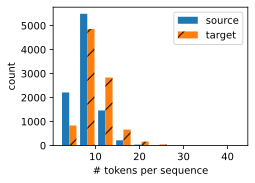

In [ ]:
def show_list_len_pair_hist(legend, xlabel, ylabel, xlist, ylist):
    """Plot the histogram for list length pairs."""
    d2l.set_figsize()
    _, _, patches = d2l.plt.hist(
        [[len(l) for l in xlist], [len(l) for l in ylist]]
    )
    d2l.plt.xlabel(xlabel)
    d2l.plt.ylabel(ylabel)
    for patch in patches[1].patches:
        patch.set_hatch('/')
    d2l.plt.legend(legend)

show_list_len_pair_hist(['source', 'target'], '# tokens per sequence',
                       'count', source, target)

Trong các mô hình ngôn ngữ, mỗi mẫu là một chuỗi có độ dài num_steps từ kho ngữ liệu, mà có thể là một phân đoạn của một câu hoặc trải dài trên nhiều câu. Trong dịch máy, một mẫu bao gồm một cặp câu nguồn và câu đích. Những câu này có thể có độ dài khác nhau, trong khi đó ta cần các mẫu có cùng độ dài để tạo minibatch.

Một cách giải quyết vấn đề này là nếu một câu dài hơn num_steps, ta sẽ cắt bớt độ dài của nó, ngược lại nếu một câu ngắn hơn num_steps, thì ta sẽ đệm thêm token <pad>. Bằng cách này, ta có thể chuyển bất cứ câu nào về một độ dài cố định.



Vì các token trong ngôn ngữ nguồn có thể khác với các token trong ngôn ngữ đích, ta cần xây dựng một bộ từ vựng cho mỗi ngôn ngữ. Do ta đang sử dụng các từ để làm token chứ không dùng ký tự, kích thước bộ từ vựng sẽ lớn hơn đáng kể. Ở đây ta sẽ ánh xạ mọi token xuất hiện ít hơn 3 lần vào token <unk> như trong Section 8.2. Ngoài ra, ta cần các token đặc biệt khác như token đệm <pad>, hay token bắt đầu câu <bos>.

In [ ]:
@d2l.add_to_class(MTVieEng)
def __init__(self, batch_size, num_steps=9, num_train=512, num_val=128):
    super(MTVieEng, self).__init__()
    self.save_hyperparameters()
    self.arrays, self.src_vocab, self.tgt_vocab = self._build_arrays(
        self._download())

@d2l.add_to_class(MTVieEng)
def _build_arrays(self, raw_text, src_vocab=None, tgt_vocab=None):
    def _build_array(sentences, vocab, is_tgt=False):
        pad_or_trim = lambda seq, t: (
            seq[:t] if len(seq) > t else seq + ['<pad>'] * (t - len(seq)))
        sentences = [pad_or_trim(s, self.num_steps) for s in sentences]
        if is_tgt:
            sentences = [['<bos>'] + s for s in sentences]
        if vocab is None:
            vocab = d2l.Vocab(sentences, min_freq=2)
        array = torch.tensor([vocab[s] for s in sentences])
        valid_len = (array != vocab['<pad>']).type(torch.int32).sum(1)
        return array, vocab, valid_len
    src, tgt = self._tokenize(self._preprocess(raw_text),
                              self.num_train + self.num_val)
    src_array, src_vocab, src_valid_len = _build_array(src, src_vocab)
    tgt_array, tgt_vocab, _ = _build_array(tgt, tgt_vocab, True)
    return ((src_array, tgt_array[:,:-1], src_valid_len, tgt_array[:,1:]),
            src_vocab, tgt_vocab)

In [ ]:
@d2l.add_to_class(MTVieEng)
def get_dataloader(self, train):
    idx = slice(0, self.num_train) if train else slice(self.num_train, None)
    return self.get_tensorloader(self.arrays, train, idx)

In [ ]:
data = MTVieEng(batch_size=3)
src, tgt, src_valid_len, label = next(iter(data.train_dataloader()))
print('source:', src.type(torch.int32))
print('decoder input:', tgt.type(torch.int32))
print('source len excluding pad:', src_valid_len.type(torch.int32))
print('label:', label.type(torch.int32))

['Run!\tChạy!\tCC-BY 2.0 (France) Attribution: tatoeba.org #906328 (papabear) & #1541945 (Aomori)', 'Run!\tChạy đi!\tCC-BY 2.0 (France) Attribution: tatoeba.org #906328 (papabear) & #10257565 (hothuyhien)', 'Help!\tGiúp tôi với!\tCC-BY 2.0 (France) Attribution: tatoeba.org #435084 (lukaszpp) & #5489308 (phuc)', 'Help!\tCứu tôi!\tCC-BY 2.0 (France) Attribution: tatoeba.org #435084 (lukaszpp) & #11534962 (OneJanuary)', 'Jump!\tNhảy đi!\tCC-BY 2.0 (France) Attribution: tatoeba.org #1102981 (jamessilver) & #11535008 (OneJanuary)', 'Stop!\tDừng lại!\tCC-BY 2.0 (France) Attribution: tatoeba.org #448320 (CM) & #6216673 (letuananh)', 'Wait!\tĐợi đã!\tCC-BY 2.0 (France) Attribution: tatoeba.org #1744314 (belgavox) & #11535054 (OneJanuary)', 'Go on.\tTiếp tục đi.\tCC-BY 2.0 (France) Attribution: tatoeba.org #2230774 (CK) & #9203952 (dotheduyet1999)', 'Hello!\tChào bạn.\tCC-BY 2.0 (France) Attribution: tatoeba.org #373330 (CK) & #510482 (tucm)', 'Hello!\tChào bạn!\tCC-BY 2.0 (France) Attribution:

In [ ]:
@d2l.add_to_class(MTVieEng)
def build(self, src_sentences, tgt_sentences):
    raw_text = '\n'.join([src + '\t' + tgt for src, tgt in zip(
        src_sentences, tgt_sentences)])
    arrays, _, _ = self._build_arrays(
        raw_text, self.src_vocab, self.tgt_vocab)
    return arrays

src, tgt, _,  _ = data.build(['run !'], ['Chạy !'])
print('source:', data.src_vocab.to_tokens(src[0].type(torch.int32)))
print('target:', data.tgt_vocab.to_tokens(tgt[0].type(torch.int32)))

['run !\tChạy !']
source: ['run', '!', '<eos>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>']
target: ['<bos>', 'chạy', '!', '<eos>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>']


Tổng kết Machine Translation dataset

In natural language processing, machine translation refers to the task of automatically mapping from a sequence representing a string of text in a source language to a string representing a plausible translation in a target language. Using **word-level tokenization**, the vocabulary size will be significantly larger than that using **character-level tokenization**, but the sequence lengths will be much shorter. To mitigate the large vocabulary size, we can treat infrequent tokens as some “unknown” token. We can truncate and pad text sequences so that all of them will have the same length to be loaded in minibatches. Modern implementations often bucket sequences with similar lengths to avoid wasting excessive computation on padding. [Trong xử lý ngôn ngữ tự nhiên, dịch máy đề cập đến nhiệm vụ tự động ánh xạ từ một chuỗi biểu thị một chuỗi văn bản trong ngôn ngữ nguồn sang chuỗi biểu thị bản dịch hợp lý trong ngôn ngữ đích. Sử dụng mã thông báo cấp độ từ, kích thước từ vựng sẽ lớn hơn đáng kể so với sử dụng mã thông báo cấp ký tự, nhưng độ dài chuỗi sẽ ngắn hơn nhiều. Để giảm thiểu kích thước từ vựng lớn, chúng ta có thể coi các mã thông báo không thường xuyên là một số mã thông báo “không xác định”. Chúng ta có thể cắt ngắn và đệm các chuỗi văn bản để tất cả chúng có cùng độ dài để tải thành các lô nhỏ. Việc triển khai hiện đại thường chứa các chuỗi có độ dài tương tự nhau để tránh lãng phí tính toán quá mức trên phần đệm.]

Exercise:

1. Try different values of the max_examples argument in the _tokenize method. How does this affect the vocabulary sizes of the source language and the target language? [Hãy thử các giá trị khác nhau của đối số max_examples trong phương thức _tokenize. Điều này ảnh hưởng thế nào đến lượng từ vựng của ngôn ngữ nguồn và ngôn ngữ đích?

In [ ]:
import matplotlib.pyplot as plt

num_trains = [100, 1000, 2000, 3000]
src_lens, tgt_lens = [], []
for num_train in num_trains:
    data = MTVieEng(batch_size=3, num_train=num_train)
    src_lens.append(len(data.src_vocab))
    tgt_lens.append(len(data.tgt_vocab))

d2l.plot(num_trains, [src_lens, tgt_lens], 'max_examples', 'vocab size', legend=['src', 'tgt'])
plt.show()


Output hidden; open in https://colab.research.google.com to view.

# The Encoder- Decoder Architecture

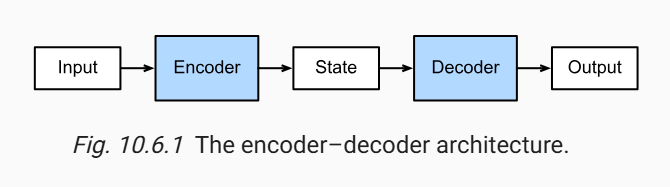

Trong các ứng dụng các đầu vào và đầu ra có kích thước khác nhau vì vậy kiến trúc Encoder-Decoder được giới thiệu

In [ ]:
!pip install d2l

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.9/58.9 kB 1.4 MB/s eta 0:00:00
  Using cached jedi-0.19.1-py2.py3-none-any.whl.metadata (22 kB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 111.7/111.7 kB 1.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.6/11.6 MB 49.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.1/17.1 MB 28.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.3/12.3 MB 62.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.6/62.6 kB 4.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 34.4/34.4 MB 11.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 98.3/98.3 kB 3.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 124.7/124.7 kB 6.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 93.5/93.5 kB 5.3 MB/s eta 0:00:00
Using cached jedi-0.19.1-py2.py3-none-any.whl (1.6 MB)
  Attempting uninstall: requests
    Found existing installation: requests 2.32.3
    Unin

In [ ]:
from torch import nn
from d2l import torch as d2l


## Encoder

Trong giao diện bộ mã hóa, chúng tôi chỉ xác định rằng bộ mã hóa lấy các chuỗi có độ dài thay đổi làm đầu vào X. Việc triển khai sẽ được cung cấp bởi bất kỳ mô hình nào kế thừa lớp Bộ mã hóa cơ sở này.

In [ ]:
class Encoder(nn.Module):
  def __init__(self, **kwargs):
    super().__init__()

  def forward(self, X, *args):
    raise NotImplemented


## Decoder

In [ ]:
class Decoder(nn.Module):
  def __init__(self):
    super().__init__()

  def init_state(self, enc_all_outputs, *args):
      raise NotImplementedError
  def forward(self, X, state):
      raise NotImplemented


In [ ]:
class EncoderDecoder(d2l.classifier):
  def __init(self, encoder, decoder):
    super().__init__()
    self.encoder = encoder
    self.decoder = decoder

  def forward(self, enc_X, dec_X, *args):
    enc_all_outputs = self.encoder(enc_X, *args)
    dec_state = self.decoder.init_state(enc_all_outputs, *args)
    # Return decoder output only
    return self.decoder(dec_X, dec_state)



SUmmary : Kiến trúc bộ mã hóa-giải mã có thể xử lý đầu vào và đầu ra đều bao gồm các chuỗi có độ dài thay đổi và do đó phù hợp với các vấn đề từ chuỗi này sang chuỗi khác như dịch máy. Bộ mã hóa lấy một chuỗi có độ dài thay đổi làm đầu vào và biến nó thành trạng thái có hình dạng cố định. Bộ giải mã ánh xạ trạng thái được mã hóa của một hình dạng cố định thành một chuỗi có độ dài thay đổi

Besides machine translation, can you think of another application where the encoder–decoder architecture can be applied?
There are many other applications where the encoder–decoder architecture can be applied, such as:

Text summarization: The encoder can encode a long text into a vector representation, and the decoder can generate a short summary based on the vector. For example, see 2 for a tutorial on how to use encoder-decoder models for text summarization.

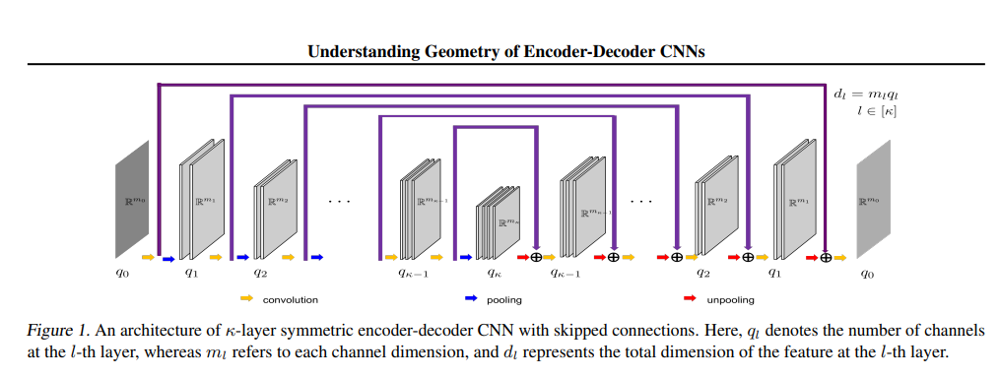

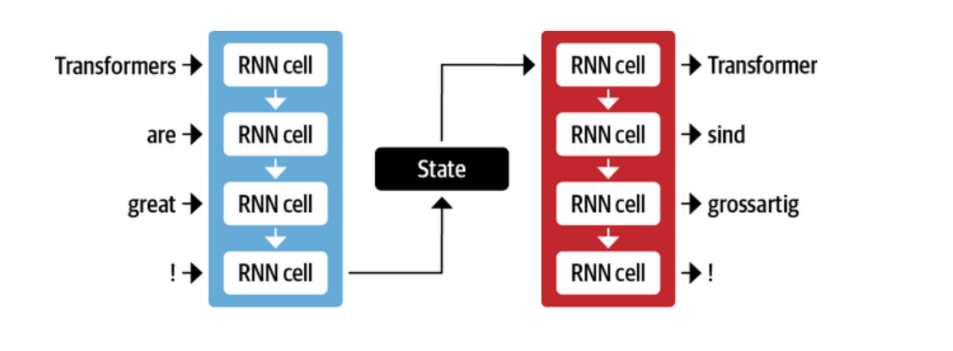

Giả sử rằng chúng ta sử dụng các mạng thần kinh để thực hiện kiến trúc bộ mã hóa-giải mã. Bộ mã hóa và bộ giải mã có phải là cùng một loại mạng thần kinh không?
Không, bộ mã hóa và bộ giải mã không nhất thiết phải là cùng một loại mạng thần kinh. Trên thực tế, các loại mạng thần kinh khác nhau có thể có những ưu điểm và nhược điểm khác nhau để mã hóa và giải mã các tác vụ. Ví dụ, các mạng thần kinh tái phát (RNN) rất tốt trong việc nắm bắt thông tin tuần tự và sự phụ thuộc dài hạn, nhưng chúng cũng dễ bị biến mất hoặc bùng nổ gradient và có chi phí tính toán cao. Mạng nơ-ron tích chập (CNN) rất tốt trong việc trích xuất các tính năng cục bộ và tính toán song song, nhưng chúng có thể mất thông tin toàn cầu và gặp khó khăn trong việc xử lý các chuỗi độ dài thay đổi. Mạng máy biến áp rất tốt trong việc mô hình hóa các phụ thuộc tầm xa và tự chú ý, nhưng chúng cũng đòi hỏi một lượng lớn dữ liệu và bộ nhớ. Do đó, tùy thuộc vào miền sự cố và đặc điểm dữ liệu, chúng ta có thể chọn các loại mạng thần kinh khác nhau cho bộ mã hóa và bộ giải mã để đạt được hiệu suất tốt nhất. Ví dụ, trong 4, các tác giả đã đề xuất một kiến trúc bộ mã hóa-giải mã lai kết hợp CNN và RNN để chú thích hình ảnh.

# Sequence-to-Sequence Learning for Machine Translation

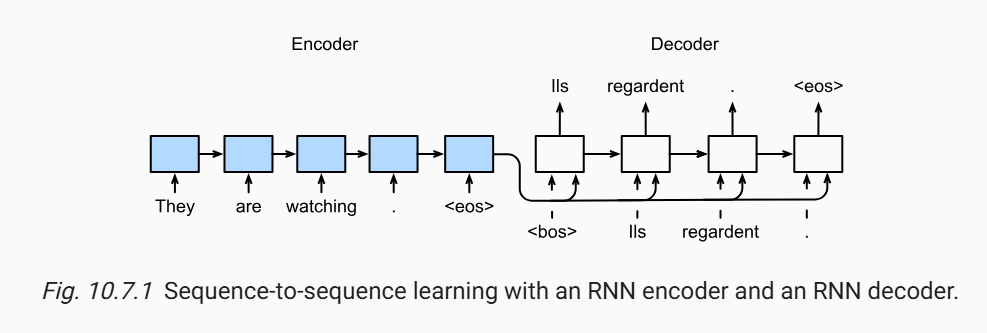

In [ ]:
!pip install d2l

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.9/58.9 kB 1.3 MB/s eta 0:00:00
  Using cached jedi-0.19.1-py2.py3-none-any.whl.metadata (22 kB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 111.7/111.7 kB 2.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.6/11.6 MB 24.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.1/17.1 MB 27.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.3/12.3 MB 36.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.6/62.6 kB 1.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 34.4/34.4 MB 8.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 98.3/98.3 kB 4.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 124.7/124.7 kB 7.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 93.5/93.5 kB 4.9 MB/s eta 0:00:00
Using cached jedi-0.19.1-py2.py3-none-any.whl (1.6 MB)
  Attempting uninstall: requests
    Found existing installation: requests 2.32.3
    Unins

## Teaching forcing

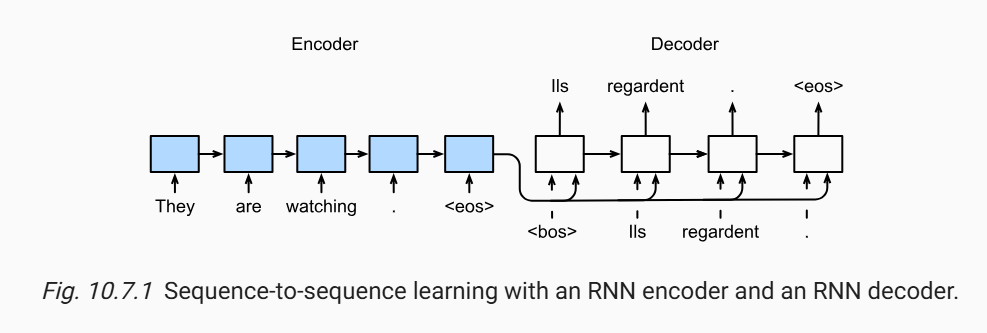

Cách tiếp cận phổ biến nhất đôi khi được gọi là "teacher forcing". Ở đây, chuỗi mục tiêu ban đầu (nhãn token) được đưa vào bộ giải mã làm đầu vào. Cụ thể hơn, token đặc biệt đánh dấu bắt đầu chuỗi và chuỗi mục tiêu ban đầu, ngoại trừ token cuối cùng, được nối lại làm đầu vào cho bộ giải mã. Trong khi đó, đầu ra của bộ giải mã (nhãn để huấn luyện) là chuỗi mục tiêu ban đầu, được dịch chuyển một token: “<bos>”, “Ils”, “regardent”, “.” “Ils”, “regardent”, “.”, “<eos>”

In [ ]:
import collections
import math
import torch
from torch import nn
from torch.nn import functional as F
from d2l import torch as d2l

## Encoder

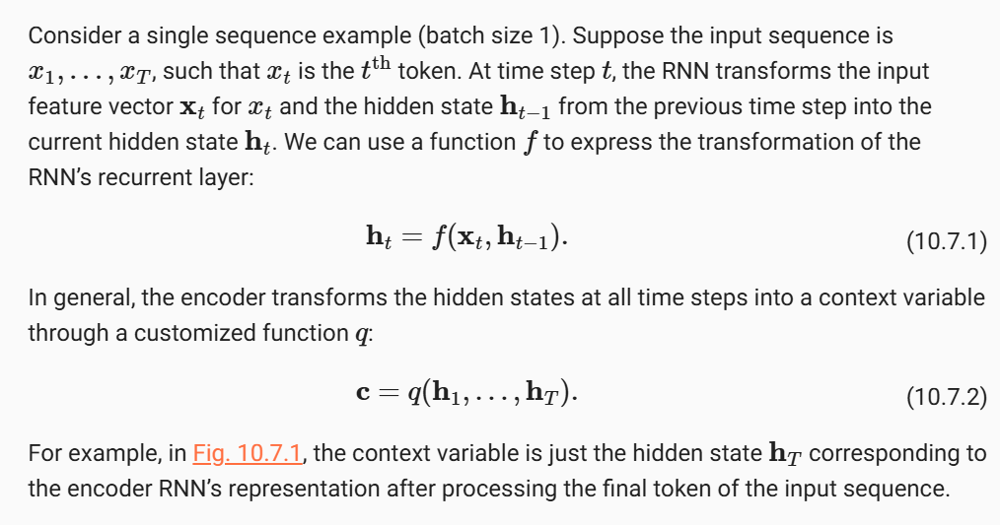

![image.png]()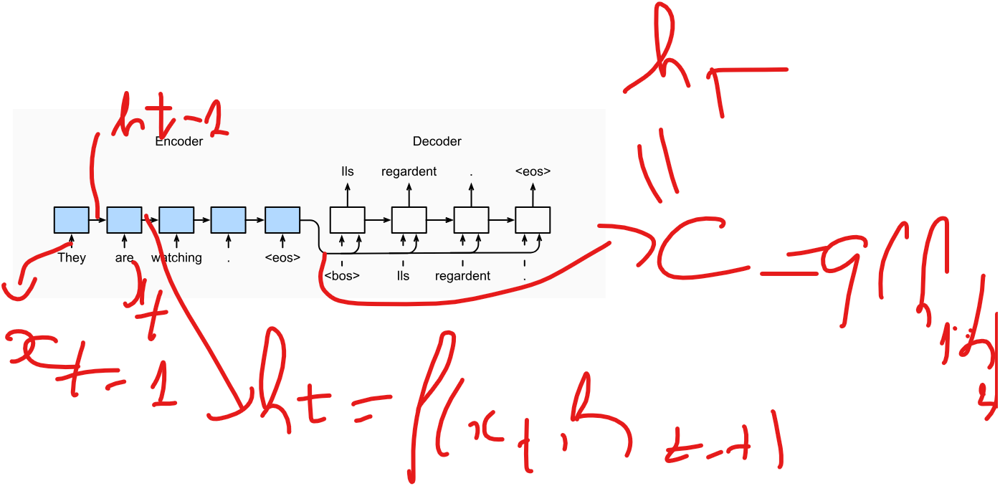

Bây giờ hãy lập trình bộ mã hóa của mô hình seq2seq. Ta sử dụng một tầng embedding từ ngữ để lấy vector đặc trưng tương ứng với chỉ số từ trong ngôn ngữ nguồn. Những vector đặc trưng này sẽ được truyền vào một mạng LSTM đa tầng. **Batch đầu vào của bộ mã hóa là tensor 2 chiều có kích thước là (kích thước batch, độ dài chuỗi)**, với số lượng chuỗi bằng kích thước batch. Bộ mã hóa trả về cả đầu ra của LSTM, gồm các trạng thái ẩn của tất cả các bước thời gian, cùng với trạng thái ẩn và ô nhớ ở bước thời gian cuối cùng.

The weight of an embedding layer is a matrix, where the number of rows corresponds to the size of the input vocabulary (vocab_size) and number of columns corresponds to the feature vector’s dimension (embed_size) [Trọng số của lớp nhúng là một ma trận, trong đó số hàng tương ứng với kích thước của từ vựng đầu vào (vocab_size) và số cột tương ứng với kích thước của vectơ đặc trưng (embed_size)]

In [ ]:
def init_seq2seq(module):
    """Initialize weights for sequence-to-sequence learning."""
    if type(module) == nn.Linear:
         nn.init.xavier_uniform_(module.weight)
    if type(module) == nn.LSTM:
        for param in module._flat_weights_names:
            if "weight" in param:
                nn.init.xavier_uniform_(module._parameters[param])

class Seq2SeqEncoder(d2l.Encoder):
    """The RNN encoder for sequence-to-sequence learning."""
    def __init__(self, vocab_size, embed_size, num_hiddens, num_layers,
                 dropout=0):
        super().__init__()
        self.embedding = nn.Embedding(vocab_size, embed_size)
        self.rnn = d2l.LSTM(embed_size, num_hiddens, num_layers, dropout)
        self.apply(init_seq2seq)

    def forward(self, X, *args):
        # X shape: (batch_size, num_steps)
        embs = self.embedding(X.t().type(torch.int64))
        # embs shape: (num_steps, batch_size, embed_size)
        outputs, state = self.rnn(embs)
        # outputs shape: (num_steps, batch_size, num_hiddens)
        # state shape: (num_layers, batch_size, num_hiddens)
        return outputs, state

 Dưới đây, chúng tôi khởi tạo bộ mã hóa GRU hai lớp có số đơn vị ẩn là 16. Cho một lô nhỏ gồm các đầu vào chuỗi X (kích thước lô = 4; số bước thời gian (độ dài chuỗi) = 9), trạng thái ẩn của lớp cuối cùng ở tất cả các bước thời gian (enc_outputs được trả về bởi các lớp lặp lại của bộ mã hóa) là một tensor có hình dạng (số bước thời gian, kích thước lô, số lượng đơn vị ẩn).]

In [ ]:
vocab_size, embed_size, num_hiddens, num_layers = 10, 8, 16, 2
batch_size, num_steps = 4, 9
encoder = Seq2SeqEncoder(vocab_size, embed_size, num_hiddens, num_layers)
X = torch.zeros((batch_size, num_steps))
enc_outputs, enc_state = encoder(X)
d2l.check_shape(enc_outputs, (num_steps, batch_size, num_hiddens))

AttributeError: module 'd2l.torch' has no attribute 'LSTM'

In [ ]:
d2l.check_shape(enc_state, (num_layers, batch_size, num_hiddens))

## Decoder

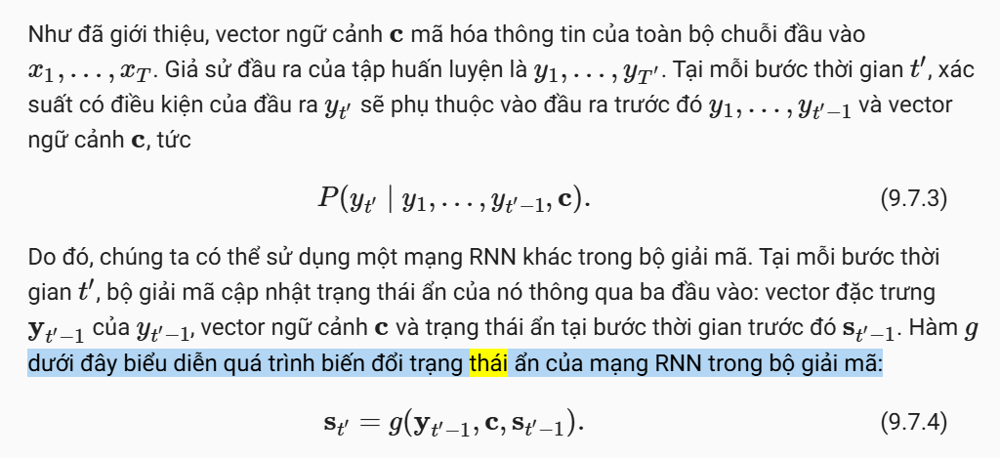

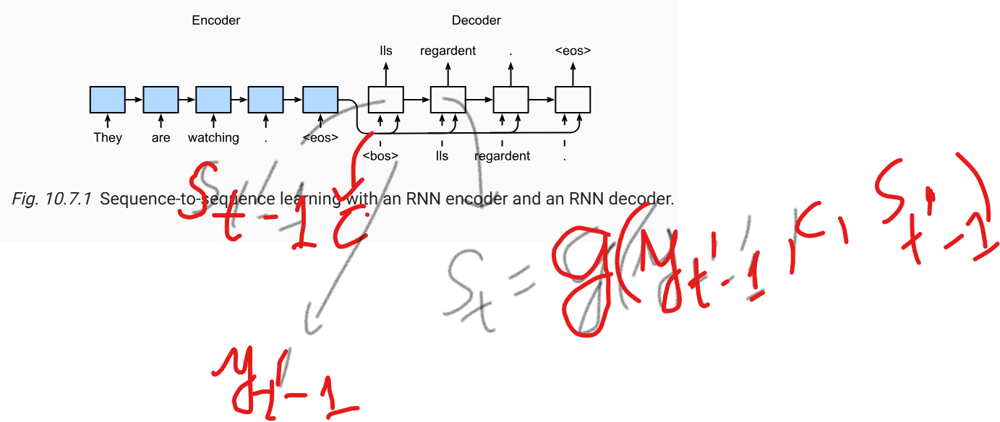

Tức là Ht =  c

Khi lập trình, ta sử dụng trực tiếp trạng thái ẩn của bộ mã hóa ở bước thời gian cuối cùng để khởi tạo trạng thái ẩn của bộ giải mã. Điều này đòi hỏi bộ mã hóa và bộ giải mã phải có cùng số tầng và số nút ẩn. Các bước tính toán lượt truyền xuôi trong bộ giải mã gần giống trong bộ mã hóa. Điểm khác biệt duy nhất là có thêm một tầng kết nối dày đặc với kích thước bằng kích thước bộ từ vựng được đặt ở sau các tầng LSTM. Tầng này sẽ dự đoán điểm tin cậy cho mỗi từ.

In [ ]:
class Seq2SeqDecoder(d2l.Decoder):
    """The RNN decoder for sequence to sequence learning."""
    def __init__(self, vocab_size, embed_size, num_hiddens, num_layers,
                 dropout=0):
        super().__init__()
        self.embedding = nn.Embedding(vocab_size, embed_size)
        self.rnn = d2l.LSTM(embed_size+num_hiddens, num_hiddens,
                           num_layers, dropout)
        self.dense = nn.LazyLinear(vocab_size)
        self.apply(init_seq2seq)

    def init_state(self, enc_all_outputs, *args):
        return enc_all_outputs

    def forward(self, X, state):
        # X shape: (batch_size, num_steps)
        # embs shape: (num_steps, batch_size, embed_size)
        embs = self.embedding(X.t().type(torch.int32))
        enc_output, hidden_state = state
        # context shape: (batch_size, num_hiddens)
        context = enc_output[-1]
        # Broadcast context to (num_steps, batch_size, num_hiddens)
        context = context.repeat(embs.shape[0], 1, 1)
        # Concat at the feature dimension
        embs_and_context = torch.cat((embs, context), -1)
        outputs, hidden_state = self.rnn(embs_and_context, hidden_state)
        outputs = self.dense(outputs).swapaxes(0, 1)
        # outputs shape: (batch_size, num_steps, vocab_size)
        # hidden_state shape: (num_layers, batch_size, num_hiddens)
        return outputs, [enc_output, hidden_state]

In [ ]:
decoder = Seq2SeqDecoder(vocab_size, embed_size, num_hiddens, num_layers)
state = decoder.init_state(encoder(X))
dec_outputs, state = decoder(X, state)
d2l.check_shape(dec_outputs, (batch_size, num_steps, vocab_size))
d2l.check_shape(state[1], (num_layers, batch_size, num_hiddens))

AttributeError: module 'd2l.torch' has no attribute 'LSTM'

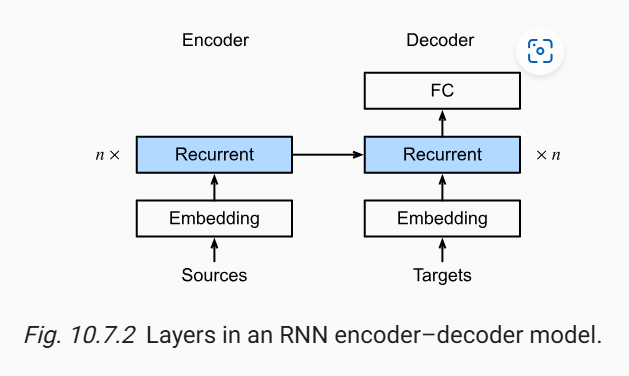

##  Encoder–Decoder for Sequence-to-Sequence Learning


In [ ]:
class Seq2Seq(d2l.EncoderDecoder):
    """The RNN encoder--decoder for sequence to sequence learning."""
    def __init__(self, encoder, decoder, tgt_pad, lr):
        super().__init__(encoder, decoder)
        self.save_hyperparameters()

    def validation_step(self, batch):
        Y_hat = self(*batch[:-1])
        self.plot('loss', self.loss(Y_hat, batch[-1]), train=False)

    def configure_optimizers(self):
        # Adam optimizer is used here
        return torch.optim.Adam(self.parameters(), lr=self.lr)

In [ ]:
@d2l.add_to_class(Seq2Seq)
def loss(self, Y_hat, Y):
    l = super(Seq2Seq, self).loss(Y_hat, Y, averaged=False)
    mask = (Y.reshape(-1) != self.tgt_pad).type(torch.float32)
    return (l * mask).sum() / mask.sum()

## Evaluation of Predicted Sequences

Bilingual Evaluation Understudy (BLEU) score

Câu hỏi đặt ra ở đây :
One of the challenges of machine translation is that, given a French sentence, there could be multiple English translations that are equally good translations of that French sentence. So how do you evaluate a machine translation system if there are multiple equally good answers? The most commonly used approach is the BLEU score. BLEU stands for Bilingual Evaluation Understanding.

[Một trong những thách thức của dịch máy là, với một câu tiếng Pháp, có thể có nhiều bản dịch tiếng Anh có chất lượng tương đương cho câu tiếng Pháp đó. Vậy làm thế nào để bạn đánh giá một hệ thống dịch máy nếu có nhiều câu trả lời tốt như nhau? Cách tiếp cận được sử dụng phổ biến nhất là điểm BLEU. BLEU có nghĩa là Hiểu biết đánh giá song ngữ.]

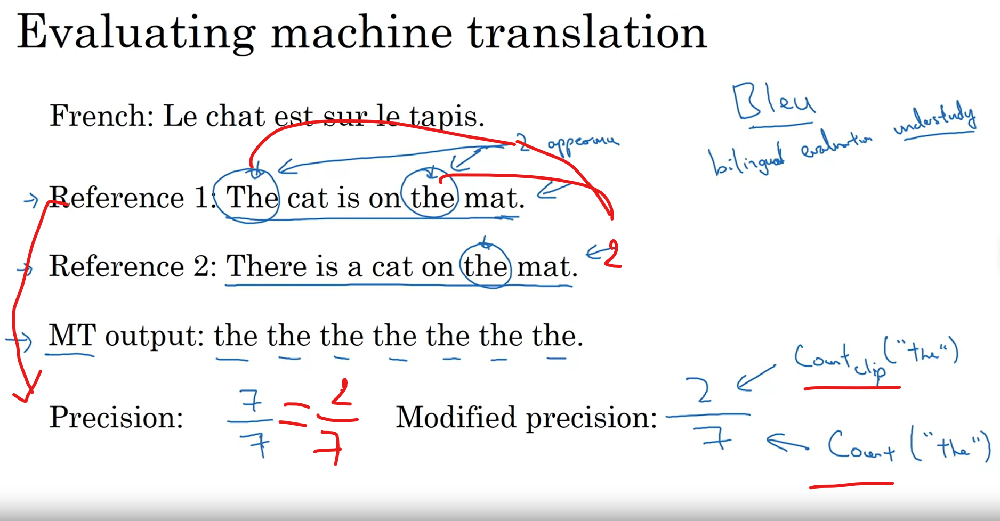

Việc sử dụng score thông thường không thể đánh giá được các trường hợp đó trong thực tế:

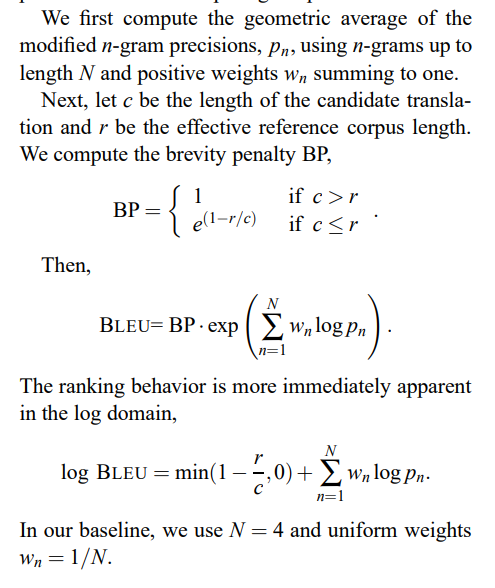

Trước tiên, chúng tôi tính trung bình hình học của độ chính xác n-gram đã sửa đổi, pn, sử dụng n-gram có chiều dài N và trọng số dương wn có tổng bằng một.                                                                             
   ngoài ra, gọi c là độ dài của bản dịch dự kiến ​​và r là độ dài kho ngữ liệu tham chiếu hiệu quả.  Chúng tôi tính toán hình phạt ngắn gọn BP,

Biểu thức tổng quát để tính **BLEU** score được định nghĩa như sau:

\[
\text{BLEU} = BP \times \exp\left( \frac{1}{N} \sum_{n=1}^{N} \log p_n \right)
\]

Trong đó:

- \( BP \) là **Brevity Penalty** (hệ số phạt độ dài), tính theo công thức:
  \[
  BP = \begin{cases}
  1, & \text{nếu } c > r \\
  e^{(1 - \frac{r}{c})}, & \text{nếu } c \leq r
  \end{cases}
  \]
  - \( c \) là độ dài chuỗi dự đoán.
  - \( r \) là độ dài chuỗi tham chiếu.

- \( N \) là số bậc n-gram bạn muốn tính (ví dụ \( N = 4 \) cho 1-gram, 2-gram, 3-gram, và 4-gram).
- \( p_n \) là **precision** của n-gram, được tính như sau:
  \[
  p_n = \frac{\text{số n-gram chính xác}}{\text{số n-gram dự đoán}}
  \]
  \(\log p_n\) là logarit tự nhiên của độ chính xác (precision) của n-gram thứ \( n \).

Ví dụ với \( N = 2 \) (1-gram và 2-gram):

Giả sử bạn có:

- **Chuỗi tham chiếu**: "the cat is on the mat"
- **Chuỗi dự đoán**: "the cat is on mat"

1. **Tính Unigram Precision (p1)**:
   - Số unigram đúng: 5/5 (tất cả từ đều khớp).
   \[
   p_1 = 1.0
   \]

2. **Tính Bigram Precision (p2)**:
   - Số bigram đúng: 3/4 (chỉ có 3 bigram khớp).
   \[
   p_2 = 0.75
   \]

3. **Tính Brevity Penalty (BP)**:
   - Độ dài tham chiếu \( r = 6 \), độ dài dự đoán \( c = 5 \), nên:
   \[
   BP = e^{(1 - \frac{6}{5})} \approx 0.82
   \]

4. **Tính BLEU Score**:
   \[
   \text{BLEU} = 0.82 \times \exp\left( \frac{1}{2} \times (\log(1.0) + \log(0.75)) \right)
   \]
   \[
   = 0.82 \times \exp\left( \frac{1}{2} \times (0 + \log(0.75)) \right)
   \]
   \[
   = 0.82 \times \exp\left( \frac{1}{2} \times (-0.2877) \right)
   \]
   \[
   = 0.82 \times \exp(-0.14385) = 0.82 \times 0.866 = 0.71
   \]

Kết quả BLEU score là **0.71**.

Điểm BLEU cao: Bản dịch có nhiều từ ngữ và cấu trúc ngữ pháp tương tự như bản dịch gốc, thể hiện rằng mô hình dịch chính xác và tự nhiên hơn.

Điểm BLEU thấp: Bản dịch không khớp nhiều với bản dịch tham chiếu, cho thấy mô hình có thể dịch sai, thiếu tự nhiên hoặc không đúng ngữ cảnh.

In [ ]:
data = MTVieEng(batch_size=128)
embed_size, num_hiddens, num_layers, dropout = 256, 256, 2, 0.2
encoder = Seq2SeqEncoder(
    len(data.src_vocab), embed_size, num_hiddens, num_layers, dropout)
decoder = Seq2SeqDecoder(
    len(data.tgt_vocab), embed_size, num_hiddens, num_layers, dropout)
model = Seq2Seq(encoder, decoder, tgt_pad=data.tgt_vocab['<pad>'],
                lr=0.005)
trainer = d2l.Trainer(max_epochs=30, gradient_clip_val=1, num_gpus=1)
trainer.fit(model, data)

['Run!\tChạy!\tCC-BY 2.0 (France) Attribution: tatoeba.org #906328 (papabear) & #1541945 (Aomori)', 'Run!\tChạy đi!\tCC-BY 2.0 (France) Attribution: tatoeba.org #906328 (papabear) & #10257565 (hothuyhien)', 'Help!\tGiúp tôi với!\tCC-BY 2.0 (France) Attribution: tatoeba.org #435084 (lukaszpp) & #5489308 (phuc)', 'Help!\tCứu tôi!\tCC-BY 2.0 (France) Attribution: tatoeba.org #435084 (lukaszpp) & #11534962 (OneJanuary)', 'Jump!\tNhảy đi!\tCC-BY 2.0 (France) Attribution: tatoeba.org #1102981 (jamessilver) & #11535008 (OneJanuary)', 'Stop!\tDừng lại!\tCC-BY 2.0 (France) Attribution: tatoeba.org #448320 (CM) & #6216673 (letuananh)', 'Wait!\tĐợi đã!\tCC-BY 2.0 (France) Attribution: tatoeba.org #1744314 (belgavox) & #11535054 (OneJanuary)', 'Go on.\tTiếp tục đi.\tCC-BY 2.0 (France) Attribution: tatoeba.org #2230774 (CK) & #9203952 (dotheduyet1999)', 'Hello!\tChào bạn.\tCC-BY 2.0 (France) Attribution: tatoeba.org #373330 (CK) & #510482 (tucm)', 'Hello!\tChào bạn!\tCC-BY 2.0 (France) Attribution:

AttributeError: module 'd2l.torch' has no attribute 'LSTM'

In [ ]:
@d2l.add_to_class(d2l.EncoderDecoder)
def predict_step(self, batch, device, num_steps,
                 save_attention_weights=False):
    batch = [a.to(device) for a in batch]
    src, tgt, src_valid_len, _ = batch
    enc_all_outputs = self.encoder(src, src_valid_len)
    dec_state = self.decoder.init_state(enc_all_outputs, src_valid_len)
    outputs, attention_weights = [tgt[:, (0)].unsqueeze(1), ], []
    for _ in range(num_steps):
        Y, dec_state = self.decoder(outputs[-1], dec_state)
        outputs.append(Y.argmax(2))
        # Save attention weights (to be covered later)
        if save_attention_weights:
            attention_weights.append(self.decoder.attention_weights)
    return torch.cat(outputs[1:], 1), attention_weights

In [ ]:
def bleu(pred_seq, label_seq, k):
    """Compute the BLEU."""
    pred_tokens, label_tokens = pred_seq.split(' '), label_seq.split(' ')
    len_pred, len_label = len(pred_tokens), len(label_tokens)
    score = math.exp(min(0, 1 - len_label / len_pred))
    for n in range(1, min(k, len_pred) + 1):
        num_matches, label_subs = 0, collections.defaultdict(int)
        for i in range(len_label - n + 1):
            label_subs[' '.join(label_tokens[i: i + n])] += 1
        for i in range(len_pred - n + 1):
            if label_subs[' '.join(pred_tokens[i: i + n])] > 0:
                num_matches += 1
                label_subs[' '.join(pred_tokens[i: i + n])] -= 1
        score *= math.pow(num_matches / (len_pred - n + 1), math.pow(0.5, n))
    return score

In [ ]:
engs = ['go .', 'i lost .']
fras = ['chạy !', 'Tôi mất .']
preds, _ = model.predict_step(
    data.build(engs, fras), d2l.try_gpu(), data.num_steps)
for en, fr, p in zip(engs, fras, preds):
    translation = []
    for token in data.tgt_vocab.to_tokens(p):
        if token == '<eos>':
            break
        translation.append(token)
    print(f'{en} => {translation}, bleu,'
          f'{bleu(" ".join(translation), fr, k=2):.3f}')

['go .\tchạy !', 'i lost .\tTôi mất .']
go . => ['đi', 'ngủ', 'đi', '.'], bleu,0.000
i lost . => ['tôi', 'cảm', 'thấy', 'cô', '<unk>', '.'], bleu,0.000


https://pandalab.me/archives/seq2seq

# Type of Searchs

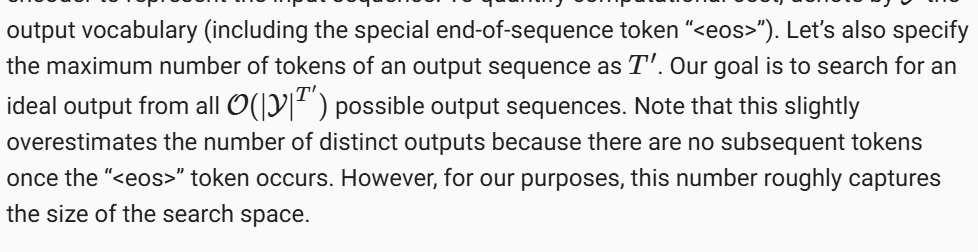

##  Greedy Search

Được sử dụng cho hầu hết các bài toán trước đây:

Ưu điểm dễ dàng

Nhược điểm yêu cầu nhiều sự tính toán, hao phí tài nguyên, không đảm bảo chuỗi tìm được là chuỗi tối ưuu

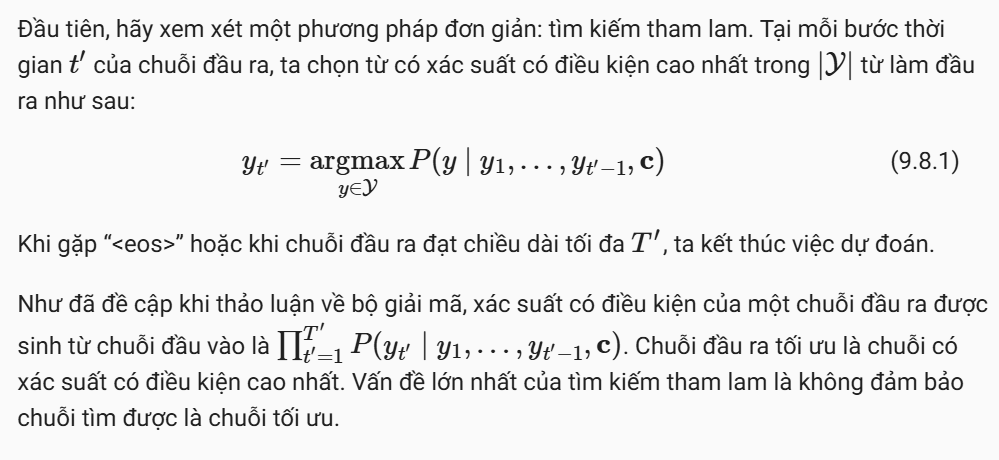

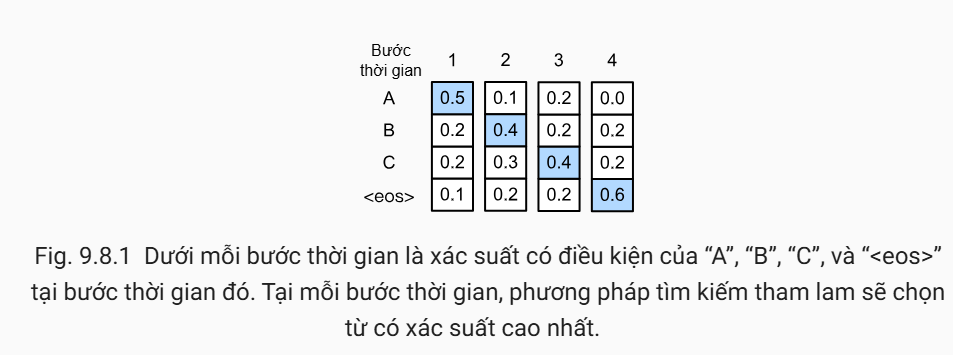

Hình 9.8.1 là trường hợp mà Tìm kiếm tham lam tìm ra chuỗi đúng nhất.


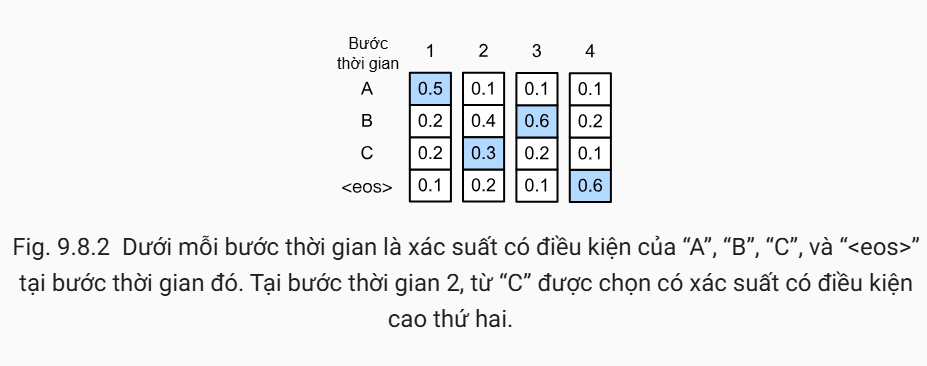

Hình 9.8.2 là trường hợp khác của tìm kiếm tham lam, đặc tính của tìm kiếm tham lam các trường hợp vì vậy có những trường sai nhưng xác suất nó có thể cao hơn trường hợp đúng. Như ở trong hình trên 9.8.2 có xác suất 0.054 > xác suất ở trong hình 9.8.1 là 0.048

## Exhaustive Search

Vét cạn

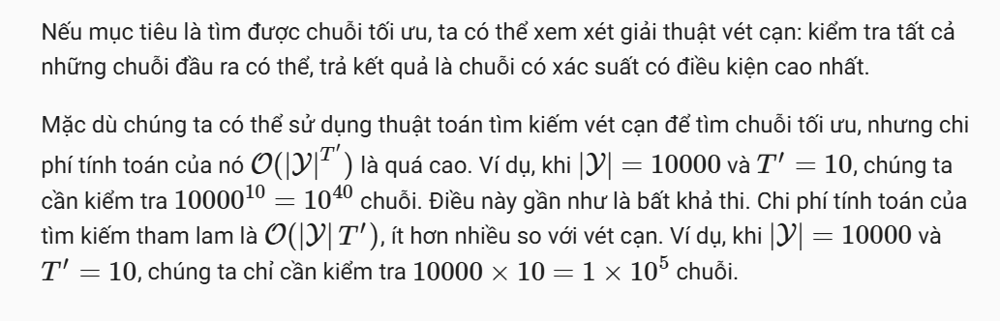

## Beam Search

Một thuật toán tìm kiếm tối ưu khắc phục được nhược điểm của các thứ trên

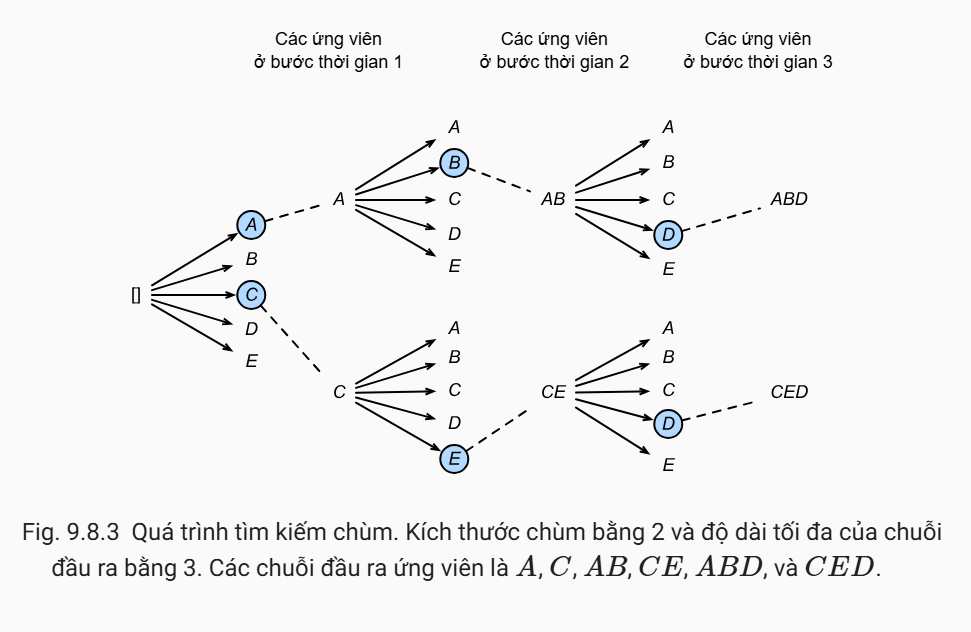

Đây là biểu đồ minh họa thuật toán **Beam Search** với một beam width (độ rộng chùm) bằng 2, nghĩa là tại mỗi bước thời gian, chỉ giữ lại 2 ứng viên tốt nhất.

- Ở bước thời gian 1, có 5 ứng viên là A, B, C, D, và E.
- Ở bước thời gian 2, các ứng viên AB và CE được giữ lại (do beam width = 2).
- Ở bước thời gian 3, 2 ứng viên ABD và CED là kết quả của beam search, tương ứng với beam width là 2 tại mỗi thời điểm.

Với beam width bằng 2, ta thấy tại mỗi bước, thuật toán chỉ giữ lại 2 ứng viên tốt nhất, giúp giảm thiểu không gian tìm kiếm so với việc xét tất cả các khả năng.

tại bước đầu ta thấy đước A và C là chuỗi có xác suất cao nhất chọn P(y1|c) A, C

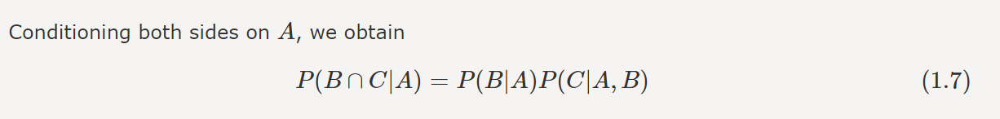
tại bước thứ 2 với A thì B là chuỗi có xác suất cao nhất với xác suất
P(A ∩ là giống gia có nghĩa là and B) =
P(A, y2|c) = P(A|c)P(y2|A,c)

Tại bước thứ 3 P(A,B|c) = P(A,B|c)P(y3|A,B,c) và D có xác suất cao nhất đối với y 3

Vậy chuỗi cuối ABD

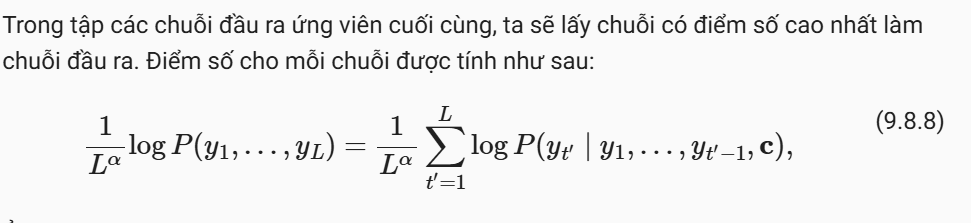

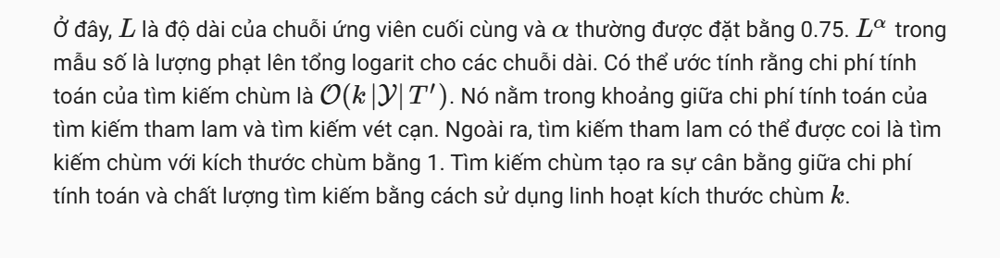

Exercise:

  1. Can we treat exhaustive search as a special type of beam search? Why or why not?

  đúng và type of beam seatch vô cùng

2. Apply beam search in the machine translation problem in Section 10.7. How does the beam size affect the translation results and the prediction speed? [Ứng dụng tìm kiếm chùm tia trong bài toán dịch máy ở Mục 10.7. Kích thước chùm tia ảnh hưởng như thế nào đến kết quả dịch thuật và tốc độ dự đoán?]

Beam size lớn có thể cải thiện chất lượng dịch, do có thể khám phá nhiều bản dịch tiềm năng hơn và giảm nguy cơ bỏ sót bản dịch tối ưu. Tuy nhiên, beam size lớn cũng làm tăng thời gian dự đoán và tiêu thụ bộ nhớ vì cần nhiều tính toán và lưu trữ hơn.

Beam size nhỏ có thể giảm thời gian dự đoán và bộ nhớ, nhưng cũng làm giảm chất lượng dịch do có thể bỏ sót một số bản dịch và tăng nguy cơ chọn lựa một bản dịch kém tối ưu.

Bài nghiên cứu này phân tích cách mà các lỗi dịch sang tiếng Anh (“→ English”) và nguồn (“→ Source”) xuất hiện trong quá trình tìm kiếm beam search và lý do tại sao các lỗi này tăng mạnh khi kích thước beam tăng lên. Qua ví dụ giải mã từ bộ dữ liệu WMT Fr → De với beam size b = 5 và b = 20, họ rút ra một số quan sát:

- Khi b = 5, các ứng viên tiếng Anh xuất hiện ở những bước đầu tiên (1-3) nhưng thường bị loại bỏ sau đó. Trong khi với b = 20, các ứng viên tiếng Anh và Pháp vẫn tồn tại đến cuối cùng.
- Ứng viên tiếng Anh thắng cuộc ở b = 20 bị phạt nặng trong bước đầu nhưng các bước sau lại chịu ít phạt.
- Dịch với b = 20 có khả năng cao hơn (tức là điểm số mô hình lớn hơn) so với bản dịch chuẩn khi b = 5, dẫn đến việc các ứng viên sai mục tiêu (off-target) có thể chiếm ưu thế.

**RQ1:** Lỗi “→ English” và “→ Source” xuất hiện từ đầu khi mô hình cho xác suất thấp ở token đầu tiên nhưng các token tiếp theo lại có xác suất cao hơn, dẫn đến việc các câu sai mục tiêu có thể đạt điểm cao hơn.

**RQ2:** Với kích thước beam lớn hơn, các ứng viên sai mục tiêu dễ tồn tại lâu hơn trong quá trình giải mã vì họ nhận ít phạt hơn ở các bước sau.

**Giải pháp:** Các mô hình có thể được cải thiện bằng cách điều chỉnh tốt hơn hoặc thêm các phương pháp huấn luyện bổ sung. (đó là Language-informed Beam Search (LiBS))

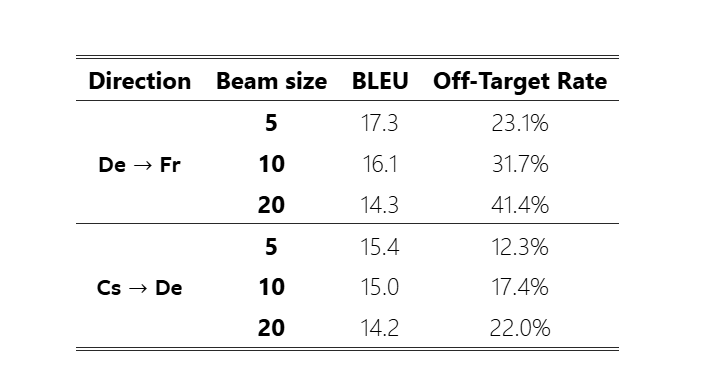

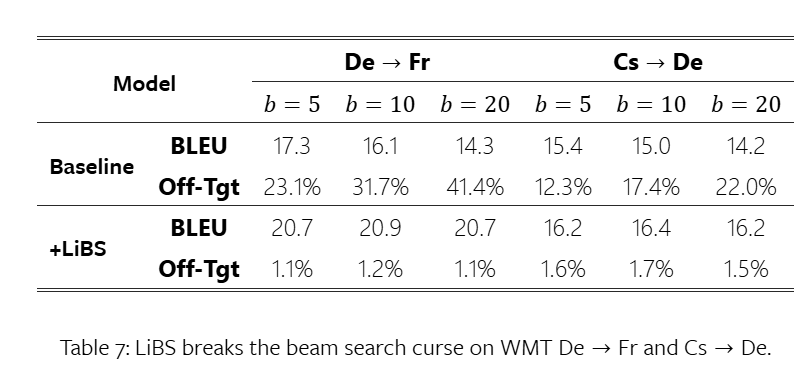

xem thêm Language-informed Beam Search (LiBS)) : https://arxiv.org/html/2408.05738v1#S7

Bài báo này nghiên cứu việc dịch máy tự động hồi quy đa ngôn ngữ (multilingual NMT) thường tạo ra bản dịch "lệch ngôn ngữ" (off-target translations), tức là không đúng ngôn ngữ mục tiêu. Tác giả phân tích lỗi này và đề xuất thuật toán Language-informed Beam Search (LiBS), kết hợp mô hình nhận diện ngôn ngữ (Language Identification - LiD) trong quá trình tìm kiếm beam search. Kết quả cải thiện điểm BLEU và giảm tỷ lệ dịch sai ngôn ngữ trên các bộ dữ liệu WMT và OPUS

**Machine Translation (MT)** là quá trình tự động dịch văn bản từ ngôn ngữ này sang ngôn ngữ khác, có thể thực hiện bằng các mô hình thống kê hoặc học sâu.

**Neural Machine Translation (NMT)** là một kỹ thuật cụ thể trong MT sử dụng mạng nơ-ron sâu để dịch văn bản. Thay vì sử dụng các phương pháp dựa trên quy tắc hoặc thống kê, NMT sử dụng các mô hình học sâu như mạng nơ-ron tuần tự (RNN) hoặc mạng biến áp (transformers), giúp nâng cao chất lượng dịch và khả năng học ngữ cảnh.

**Multilingual NMT** là một nhánh của MT, trong đó một mô hình duy nhất có thể dịch nhiều ngôn ngữ khác nhau thay vì chỉ một cặp ngôn ngữ. Nó thường sử dụng các mô hình học sâu tự hồi quy để xử lý văn bản đa ngôn ngữ, với ngôn ngữ đích được chỉ định làm đầu vào trong quá trình dịch.

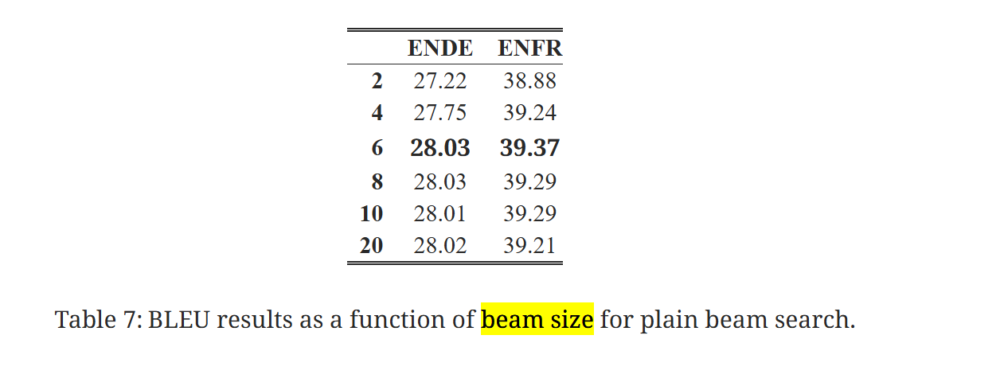

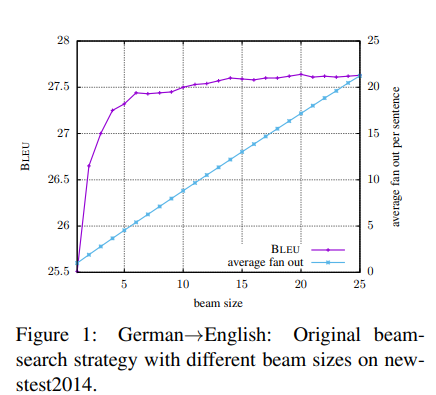

  3. We used language modeling for generating text following user-provided prefixes in Section 9.5. Which kind of search strategy does it use? Can you improve it? [Chúng tôi đã sử dụng mô hình ngôn ngữ để tạo văn bản theo các tiền tố do người dùng cung cấp trong Phần 9.5. Nó sử dụng loại chiến lược tìm kiếm nào? Bạn có thể cải thiện nó?]

We use greedy search in Section 9.5, we can use beam search to improve it.



In [ ]:
!pip install upgrade d2l

ERROR: Could not find a version that satisfies the requirement upgrade (from versions: none)
ERROR: No matching distribution found for upgrade


In [ ]:
def beam_search()

In [ ]:
import sys
import torch.nn as nn
import torch
import warnings
import numpy as np
from sklearn.model_selection import ParameterGrid
sys.path.append('/home/jovyan/work/d2l_solutions/notebooks/exercises/d2l_utils/')
from d2l import torch as d2l
from torchsummary import summary
import copy
warnings.filterwarnings("ignore")



In [ ]:
@d2l.add_to_class(RNNLMScratch)
def predict(self, prefix, num_preds, vocab, device=None):
    state, outputs = None, [vocab[prefix[0]]]
    for i in range(len(prefix) + num_preds - 1):
        X = torch.tensor([[outputs[-1]]], device=device)
        embs = self.one_hot(X)
        rnn_outputs, state = self.rnn(embs, state)
        if i < len(prefix) - 1:  # Warm-up period
            outputs.append(vocab[prefix[i + 1]])
        else:  # Predict num_preds steps
            Y = self.output_layer(rnn_outputs)
            outputs.append(int(Y.argmax(axis=2).reshape(1)))
    return ''.join([vocab.idx_to_token[i] for i in outputs])

'it has in the the the the '

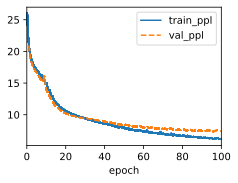

In [ ]:
class BeamRNNLMScratch(d2l.RNNLMScratch):
    """The RNN-based language model implemented from scratch.

    Defined in :numref:`sec_rnn-scratch`"""

    def predict(self, prefix, num_preds, vocab, device=None, k=1, alpha=0.75):
        """Defined in :numref:`sec_rnn-scratch`"""
        state, outputs = [None]*k, [[vocab[prefix[0]]] for i in range(k)]
        preds = torch.cat([torch.ones(1,len(vocab))]*k)
        res,score = None, -sys.maxsize
        for i in range(len(prefix) + num_preds - 1):
            temp = []
            for j in range(k):
                X = torch.tensor([[outputs[j][-1]]], device=device)
                embs = self.one_hot(X)
                rnn_outputs, state[j] = self.rnn(embs, state[j])
                if i < len(prefix) - 1:  # Warm-up period
                    outputs[j].append(vocab[prefix[i + 1]])
                else:  # Predict num_preds steps
                    Y = self.output_layer(rnn_outputs)
                    # print(Y.shape,preds.shape)
                    Y = Y*preds[j,:]
                    # print(Y.shape)
                    temp.append(Y.reshape(-1))
            if i >= len(prefix) - 1:
                temp = torch.cat(temp)
                # print(temp.shape)
                pred, index = torch.topk(temp, k)
                # print(pred,index)
                preds = pred.reshape(-1,1)#.repeat(1,k)
                # print(preds)
                temp_outputs = []
                for ix in range(len(index)):
                    m = index[ix] // len(vocab)
                    v = index[ix] % len(vocab)
                    o = copy.deepcopy(outputs[m])
                    o.append(v.reshape(1))
                    temp_outputs.append(o)
                    seq_len = i - len(prefix)+2
                    # print(seq_len,pred[ix],torch.log(pred[ix]),-1/pow(seq_len, alpha))
                    temp_score = 1/pow(seq_len, alpha)*torch.log(pred[ix])
                    # print(temp_score,res)
                    if temp_score.item() > score:
                        res = ''.join([vocab.idx_to_token[oi] for oi in o])
                outputs = copy.deepcopy(temp_outputs)

        return res
data = d2l.TimeMachine(batch_size=1024, num_steps=32)
rnn = d2l.RNNScratch(num_inputs=len(data.vocab), num_hiddens=32)
model = d2l.RNNLMScratch(rnn, vocab_size=len(data.vocab), lr=1)
trainer = d2l.Trainer(max_epochs=100, gradient_clip_val=1, num_gpus=0)
trainer.fit(model, data)
model.predict('it has', 20, data.vocab)

m = index[ix] // len(vocab): Xác định chỉ số beam hiện tại (tức là chỉ số của beam trong danh sách outputs).

v = index[ix] % len(vocab): Xác định chỉ số từ điển của từ dự đoán tốt nhất tại bước này.

o = copy.deepcopy(outputs[m]): Tạo một bản sao của các dự đoán hiện tại của beam m để không làm thay đổi dữ liệu gốc.

o.append(v.reshape(1)): Thêm từ dự đoán vào bản sao của beam m.

temp_outputs.append(o): Thêm bản sao cập nhật của beam m vào danh sách các dự đoán tạm thời (temp_outputs).

KeyboardInterrupt: 

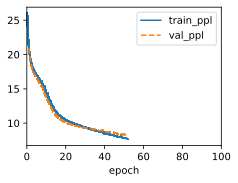

In [ ]:
data = d2l.TimeMachine(batch_size=1024, num_steps=128)
rnn = d2l.RNNScratch(num_inputs=len(data.vocab), num_hiddens=32)
model = BeamRNNLMScratch(rnn, vocab_size=len(data.vocab), lr=1)
# model = d2l.RNNLMScratch(rnn, vocab_size=len(data.vocab), lr=1)
trainer = d2l.Trainer(max_epochs=100, gradient_clip_val=1, num_gpus=0)
trainer.fit(model, data)

In [ ]:
model.predict('it has', 20, data.vocab, k=2)


xem thêm source code beam search : https://github.com/jarobyte91/pytorch_beam_search/blob/master/src/pytorch_beam_search/seq2seq/search_algorithms.py

#  Attention Mechanisms and Transformers

Paper : https://arxiv.org/pdf/1409.0473

## Queries, Keys, and Values

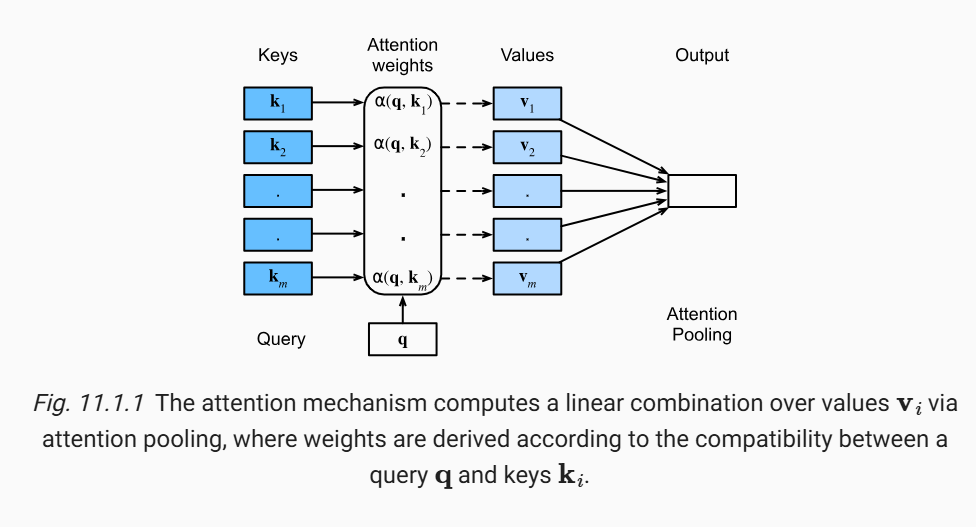

Tìm hiểu về 3 khái niệm Query, Key,Value

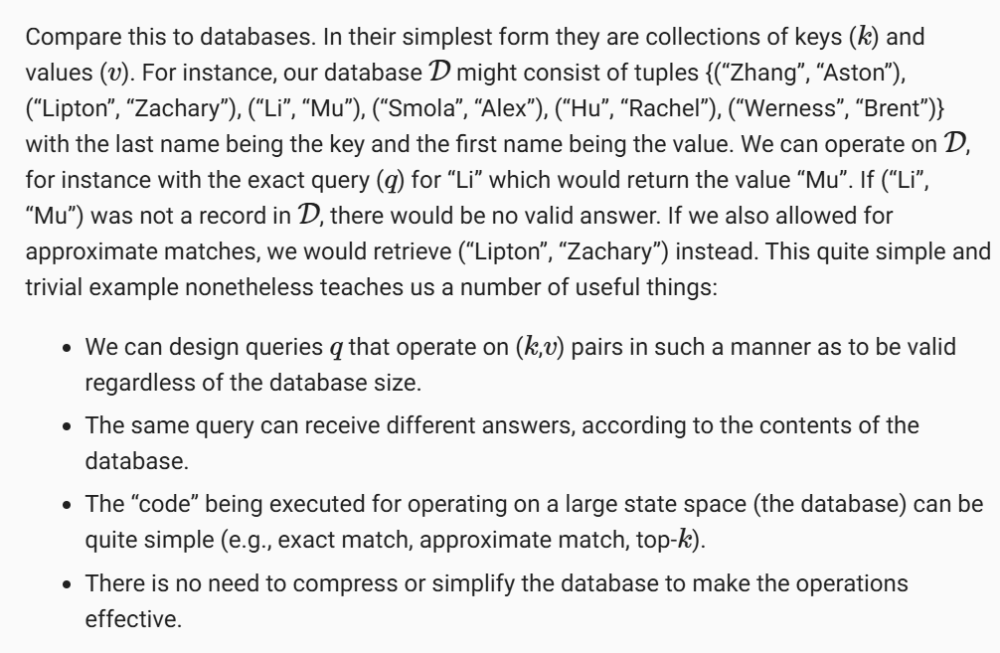

Dưới đây là bản dịch nội dung từ hình ảnh:

---

Hãy so sánh điều này với cơ sở dữ liệu. Ở dạng đơn giản nhất, chúng là các tập hợp của các cặp **key** (khóa) và **value** (giá trị). Ví dụ, cơ sở dữ liệu \( \mathcal{D} \) của chúng ta có thể bao gồm các bộ như {("Zhang", "Aston"), ("Lipton", "Zachary"), ("Li", "Mu"), ("Smola", "Alex"), ("Hu", "Rachel"), ("Werness", "Brent")}, trong đó họ (last name) là **key** và tên (first name) là **value**. Chúng ta có thể thực hiện thao tác trên \( \mathcal{D} \), chẳng hạn với truy vấn chính xác **query** \( q \) là "Li", sẽ trả về giá trị "Mu". Nếu ("Li", "Mu") không phải là một bản ghi trong \( \mathcal{D} \), sẽ không có câu trả lời hợp lệ nào. Nếu chúng ta cũng cho phép khớp xấp xỉ, chúng ta có thể nhận lại ("Lipton", "Zachary") thay thế. Ví dụ đơn giản và tầm thường này dạy chúng ta một số điều hữu ích:

- Chúng ta có thể thiết kế các truy vấn **query** \( q \) hoạt động trên các cặp \( (k, v) \) theo cách hợp lệ bất kể kích thước của cơ sở dữ liệu.
- Cùng một truy vấn có thể nhận được các câu trả lời khác nhau, tùy thuộc vào nội dung của cơ sở dữ liệu.
- "Code" được thực thi để hoạt động trên không gian trạng thái lớn (cơ sở dữ liệu) có thể khá đơn giản (ví dụ: khớp chính xác, khớp xấp xỉ, **top-k**).
- Không cần phải nén hay đơn giản hóa cơ sở dữ liệu để làm cho các thao tác hiệu quả.

---

Hy vọng bản dịch này đáp ứng yêu cầu của bạn!

Dựa trên ví dụ về cơ sở dữ liệu trong hình ảnh, ta có thể tóm tắt mối liên hệ giữa **queries**, **keys**, và **values** như sau:

- **Keys (khóa)**: Là những đặc trưng của dữ liệu mà chúng ta sẽ dùng để đối chiếu với truy vấn (trong ví dụ, "Zhang", "Lipton", "Li", v.v. là các **keys** - họ của người).
  
- **Values (giá trị)**: Là dữ liệu mà chúng ta muốn lấy ra khi truy vấn (trong ví dụ, "Aston", "Zachary", "Mu", v.v. là các **values** - tên của người).

- **Queries (truy vấn)**: Là đầu vào của hệ thống, chúng ta muốn truy xuất các **values** tương ứng với **keys** (ví dụ, query "Li" trả về giá trị "Mu").

Khi ta sử dụng **query** để tìm **key**, ta sẽ thu về **value** tương ứng. Nếu không tìm được **key** chính xác, có thể hệ thống sẽ trả về một kết quả xấp xỉ, ví dụ như trả về ("Lipton", "Zachary") nếu không có "Li".

Trong mạng nơ-ron với cơ chế Attention, cơ chế này hoạt động tương tự, khi **query** là dữ liệu cần tìm sự chú ý, **key** là các đặc trưng để so sánh, và **value** là đầu ra tương ứng.

Dưới đây là bản dịch nội dung từ hình ảnh:

---

Rõ ràng, chúng ta sẽ không giới thiệu một cơ sở dữ liệu đơn giản như vậy nếu không phải vì mục đích giải thích sâu về deep learning. Thật vậy, điều này dẫn đến một trong những khái niệm thú vị nhất được giới thiệu trong deep learning trong thập kỷ qua: **cơ chế Attention** (Bahdanau et al., 2014). Chúng ta sẽ đề cập chi tiết về ứng dụng của nó trong dịch máy sau này. Hiện tại, hãy chỉ đơn giản xem xét điều sau: ký hiệu cơ sở dữ liệu \( \mathcal{D} = \{(k_1, v_1), \ldots, (k_m, v_m)\} \) là một cơ sở dữ liệu gồm \( m \) cặp **key** và **value**. Hơn nữa, ký hiệu \( q \) là truy vấn. Khi đó, chúng ta có thể định nghĩa toán tử chú ý (attention operator) \( \mathcal{D} \) là:

\[
\text{Attention}(q, \mathcal{D}) = \sum_{i=1}^{m} a(q, k_i) v_i
\]

trong đó \( a(q, k_i) \in \mathbb{R} \) là các trọng số chú ý vô hướng. Kết quả của phép toán này thường được gọi là **attention pooling**. Tên gọi xuất phát từ việc phép toán này đặc biệt chú ý đến những thành phần có trọng số \( a(q, k_i) \) lớn (hoặc đáng kể). Do đó, cơ chế attention của cơ sở dữ liệu \( \mathcal{D} \) trở thành một tổ hợp tuyến tính của các giá trị có trong cơ sở dữ liệu. Trên thực tế, điều này chứa các trường hợp đặc biệt khi tất cả trừ một trọng số đều bằng không. Chúng ta có một số trường hợp đặc biệt:

- Các trọng số \( a(q, k_i) \) là không âm. Trong trường hợp này, đầu ra của cơ chế attention chứa trong tập hợp lồi do các giá trị \( v_i \) sinh ra.
- Các trọng số \( a(q, k_i) \) tạo thành một tổ hợp lồi, tức là \( \sum_{i=1}^{m} a(q, k_i) = 1 \) và \( a(q, k_i) \geq 0 \) với mọi \( i \). Đây là trường hợp phổ biến nhất trong deep learning.
- Chính xác một trong số các trọng số \( a(q, k_i) \) bằng 1, trong khi các trọng số khác bằng 0. Đây là một dạng của truy vấn cơ sở dữ liệu truyền thống.
- Tất cả các trọng số đều bằng nhau, tức là \( a(q, k_i) = \frac{1}{m} \) cho mọi \( i \). Điều này tương đương với phép lấy trung bình trên toàn bộ cơ sở dữ liệu, còn được gọi là phép pooling trung bình.

Một chiến lược phổ biến để đảm bảo rằng các trọng số cộng lại bằng 1 là chuẩn hóa chúng thông qua:

\[
a(q, k_i) = \frac{a(q, k_i)}{\sum_{j=1}^{m} a(q, k_j)}
\]

(11.1.2)

Đặc biệt, để đảm bảo rằng các trọng số này không âm, chúng ta có thể sử dụng phép lũy thừa cơ số mũ. Điều này có nghĩa là chúng ta có thể chọn bất kỳ hàm \( a(q, k_i) \) nào, sau đó áp dụng phép softmax dùng trong các mô hình xác suất đa hạng để thu được:

\[
a(q, k_i) = \frac{\exp(a(q, k_i))}{\sum_{j=1}^{m} \exp(a(q, k_j))}
\]

(11.1.3)

Phép toán này có sẵn trong mọi framework deep learning. Nó có thể phân biệt được và gradient của nó không bao giờ triệt tiêu, tất cả đều là những thuộc tính mong muốn trong một mô hình. Lưu ý rằng cơ chế attention được giới thiệu ở trên không phải là lựa chọn duy nhất. Ví dụ, chúng ta có thể thiết kế một mô hình không phân biệt được mà có thể được huấn luyện bằng các phương pháp học tăng cường (Mnih et al., 2015). Như chúng ta mong đợi, việc huấn luyện một mô hình như vậy phức tạp hơn rất nhiều. Do đó, phần lớn các nghiên cứu về attention hiện đại đều tuân theo khuôn khổ được phác thảo trong Hình 11.1.1. Vì vậy, chúng ta sẽ tập trung vào giải thích về họ cơ chế phân biệt được này.

---

**Hình 11.1.1** Cơ chế attention tính toán tổ hợp tuyến tính của các giá trị \( v_i \) thông qua attention pooling, trong đó các trọng số được lấy từ sự tương quan giữa **query** và các **keys**.

---

Điều đáng chú ý là "mã thực tế" được thực thi để hoạt động trên tập hợp **key** và **value**, cụ thể là **query**, có thể khá đơn giản, mặc dù không gian tìm kiếm là rất lớn. Điều này rất mong muốn đối với một lớp mạng attention vì nó không yêu cầu quá nhiều tham số để học.

## Visualization

Một trong những lợi ích của cơ chế chú ý là nó có thể khá trực quan, đặc biệt khi các trọng số không âm và có tổng bằng 1.Trong trường hợp này, chúng ta có thể giải thích các trọng số lớn như một cách để mô hình lựa chọn các thành phần phù hợp. Mặc dù đây là một trực giác tốt nhưng điều quan trọng cần nhớ là nó chỉ là một trực giác. Bất chấp điều đó, chúng ta có thể muốn hình dung tác dụng của nó đối với tập hợp khóa đã cho khi áp dụng nhiều truy vấn khác nhau. Chức năng này sẽ có ích sau này.

Do đó, chúng tôi xác định hàm show_heatmaps. Lưu ý rằng nó không lấy ma trận (của các trọng số chú ý) làm đầu vào mà thay vào đó là một tenxơ có bốn trục, cho phép thực hiện một loạt các truy vấn và trọng số khác nhau. Do đó, ma trận đầu vào có dạng (số hàng hiển thị, số cột hiển thị, số truy vấn, số khóa). Điều này sẽ có ích sau này khi chúng ta muốn hình dung các hoạt động thiết kế Máy biến áp.


In [ ]:
!pip install d2l

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.9/58.9 kB 1.8 MB/s eta 0:00:00
  Using cached jedi-0.19.1-py2.py3-none-any.whl.metadata (22 kB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 111.7/111.7 kB 5.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.6/11.6 MB 22.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.1/17.1 MB 22.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.3/12.3 MB 26.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.6/62.6 kB 4.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 34.4/34.4 MB 8.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 98.3/98.3 kB 6.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 124.7/124.7 kB 10.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 93.5/93.5 kB 6.4 MB/s eta 0:00:00
Using cached jedi-0.19.1-py2.py3-none-any.whl (1.6 MB)
  Attempting uninstall: requests
    Found existing installation: requests 2.32.3
    Unin

In [ ]:
import torch
from d2l import torch as d2l

In [ ]:
def show_heatmaps(matrices, xlabel, ylabel, titles=None, figsize=(2.5, 2.5),
                  cmap='Reds'):
    """Show heatmaps of matrices."""
    d2l.use_svg_display()
    num_rows, num_cols, _, _ = matrices.shape
    fig, axes = d2l.plt.subplots(num_rows, num_cols, figsize=figsize,
                                 sharex=True, sharey=True, squeeze=False)
    for i, (row_axes, row_matrices) in enumerate(zip(axes, matrices)):
        for j, (ax, matrix) in enumerate(zip(row_axes, row_matrices)):
            pcm = ax.imshow(matrix.detach().numpy(), cmap=cmap)
            if i == num_rows - 1:
                ax.set_xlabel(xlabel)
            if j == 0:
                ax.set_ylabel(ylabel)
            if titles:
                ax.set_title(titles[j])
    fig.colorbar(pcm, ax=axes, shrink=0.6);

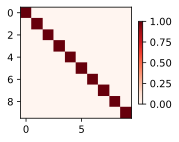

In [ ]:
attention_weights = torch.eye(10).reshape((1, 1, 10, 10))
show_heatmaps(attention_weights, xlabel='Keys', ylabel='Queries')

Exercise:

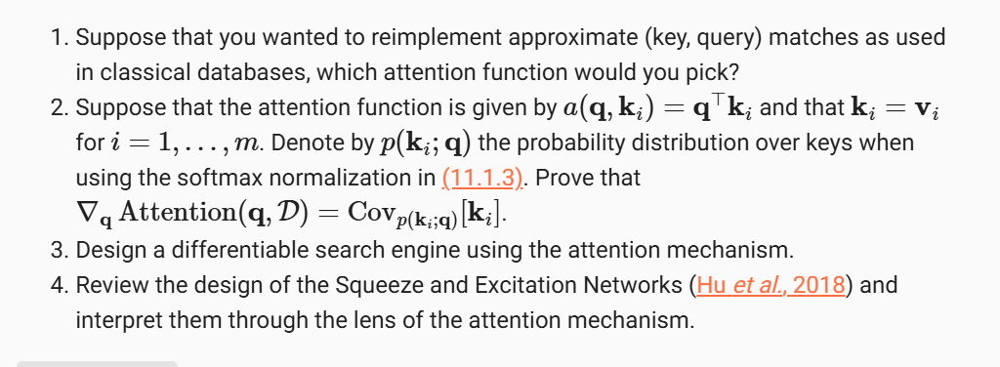

## SE-Net

Đề áp dụng attention cho CNN

SQUEEZE-AND-EXCITATION BLOCKS

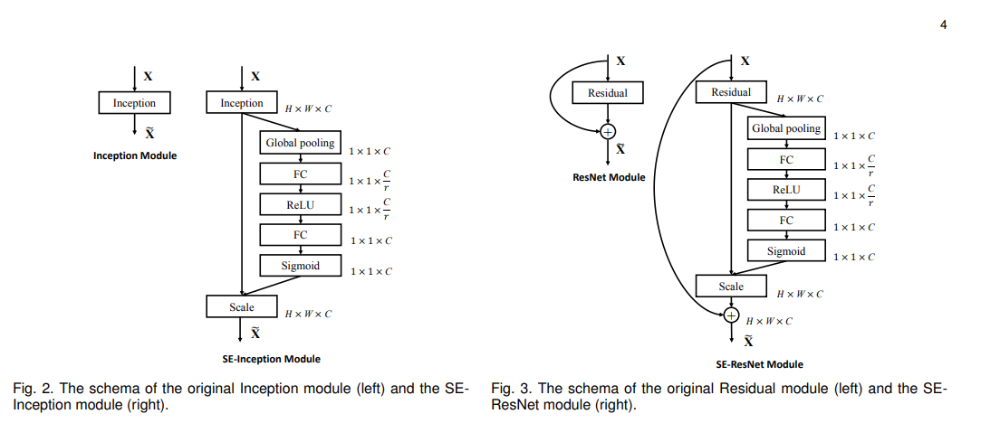

\documentclass{article}
\usepackage{amsmath}
\usepackage{amssymb}

\begin{document}

\section*{Khối Squeeze-and-Excitation (SE)}

Khối Squeeze-and-Excitation (SE) là một khối tính toán có thể được xây dựng dựa trên phép biến đổi $F_{tr}$, ánh xạ một đầu vào $X \in \mathbb{R}^{H_0 \times W_0 \times C_0}$ thành bản đồ đặc trưng $U \in \mathbb{R}^{H \times W \times C}$. Ở đây, $F_{tr}$ là phép biến đổi tích chập, và $V = [v_1, v_2, \dots, v_C]$ là tập hợp các bộ lọc đã học được, với $v_c$ là tham số của bộ lọc thứ $c$. Đầu ra có thể được viết là $U = [u_1, u_2, \dots, u_C]$, trong đó:

\begin{equation}
    u_c = v_c * X = \sum_{s=1}^{C_0} v_s^c * x_s
\end{equation}

Ở đây, dấu "*" biểu diễn phép tích chập, $v_c = [v_1^c, v_2^c, \dots, v_{C_0}^c]$, $X = [x_1, x_2, \dots, x_{C_0}]$, và $u_c \in \mathbb{R}^{H \times W}$.

\subsection*{3.1 Squeeze: Nhúng thông tin toàn cục}

Để tận dụng phụ thuộc giữa các kênh, đầu tiên, ta thu gọn thông tin không gian thành một mô tả của từng kênh. Điều này được thực hiện bằng phép pooling trung bình toàn cục, tạo ra một thống kê kênh dưới dạng $z \in \mathbb{R}^C$, được tính toán bằng:

\begin{equation}
    z_c = F_{sq}(u_c) = \frac{1}{H \times W} \sum_{i=1}^{H} \sum_{j=1}^{W} u_c(i, j)
\end{equation}

Đầu ra của phép biến đổi $U$ được hiểu như một tập hợp các mô tả cục bộ, và việc thu thập thông tin toàn cục giúp tăng cường tính biểu đạt của đặc trưng.

\subsection*{3.2 Excitation: Tái điều chỉnh thích ứng}

Sau khi đã nén thông tin toàn cục, ta thực hiện phép hiệu chỉnh để mô hình hóa hoàn toàn phụ thuộc giữa các kênh. Để đáp ứng mục tiêu này, ta sử dụng một cơ chế đóng/mở đơn giản với hàm sigmoid:

\begin{equation}
    s = F_{ex}(z, W) = \sigma(g(z, W)) = \sigma(W_2 \delta(W_1 z))
\end{equation}

Ở đây, $\delta$ là hàm ReLU, $W_1 \in \mathbb{R}^{\frac{C}{r} \times C}$ và $W_2 \in \mathbb{R}^{C \times \frac{C}{r}}$. Phép hiệu chỉnh cuối cùng là nhân mỗi $u_c$ với trọng số $s_c$:

\begin{equation}
    x_{e}^c = F_{scale}(u_c, s_c) = s_c u_c
\end{equation}

*Tóm tắt*
Khối SE cải thiện hiệu suất của mạng bằng cách mô hình hóa rõ ràng mối quan hệ giữa các kênh thông qua hai bước chính: Squeeze (nén thông tin toàn cục) và Excitation (tái điều chỉnh thích ứng các kênh), từ đó tăng độ nhạy của mạng đối với các đặc trưng thông tin.

xem thêm : chttps://pandalab.me/archives/queries_keys_and_values#design-a-differentiable-search-engine-using-the-attention-mechanism.

## DARTS (Differentiable Neural Architecture Search)

https://arxiv.org/pdf/1806.09055

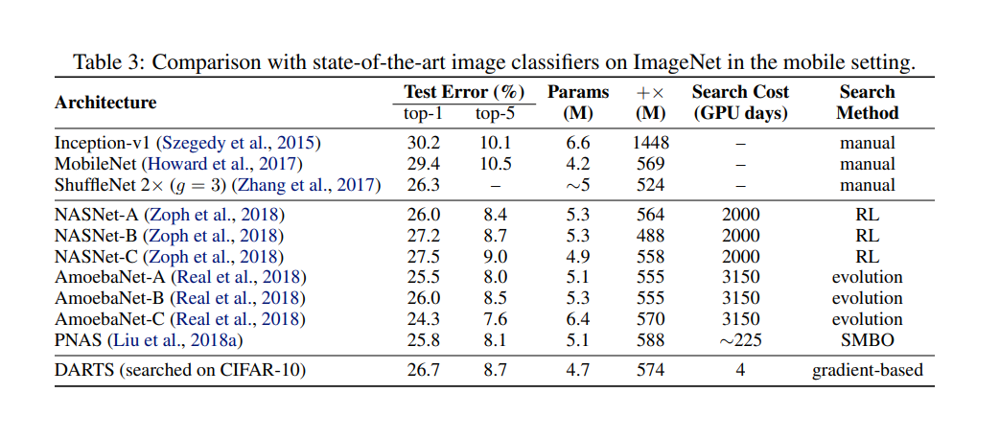

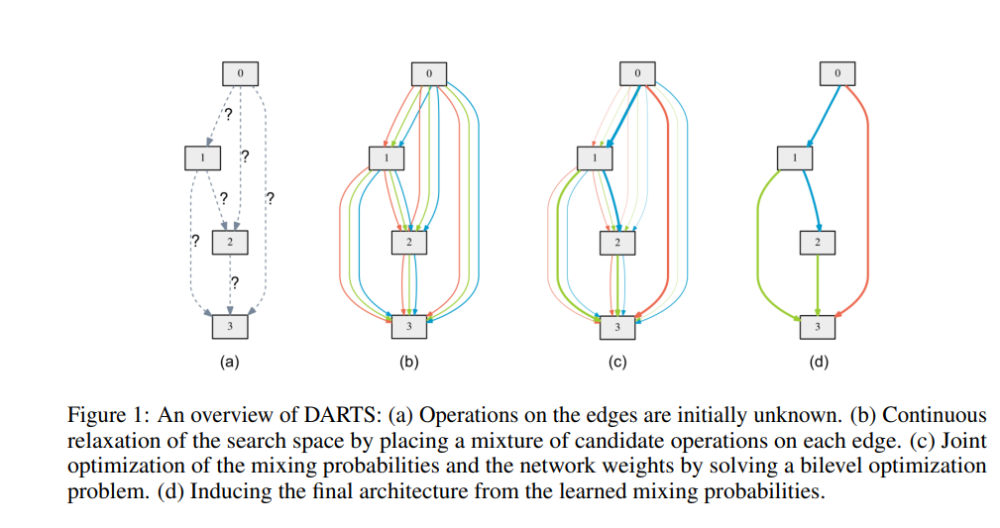

**Tóm tắt nội dung:**

Phần này trình bày về **Differentiable Architecture Search (DARTS)**:

1. **Search Space (Không gian tìm kiếm):**
   - Mô hình tìm kiếm kiến trúc bao gồm các "cells" (ô tính toán) trong mạng neural, có thể được sử dụng cho mạng tích chập hoặc mạng hồi quy.
   - Mỗi cell là một đồ thị có hướng, với các node biểu diễn đặc trưng (ví dụ: bản đồ đặc trưng trong CNN), và các cạnh đại diện cho các phép biến đổi giữa các node.
   - Cell có hai đầu vào và một đầu ra, với các phép tính trung gian giữa các node.

2. **Continuous Relaxation and Optimization (Thư giãn liên tục và tối ưu hóa):**
   - Không gian tìm kiếm được thư giãn thành một không gian liên tục bằng cách sử dụng hàm softmax trên các phép toán khả dĩ.
   - Quá trình tìm kiếm kiến trúc bao gồm tối ưu hóa song song giữa kiến trúc và trọng số, thông qua một bài toán tối ưu hai mức.

3. **Approximate Architecture Gradient (Xấp xỉ Gradient Kiến trúc):**
   - Do việc tính toán gradient cho kiến trúc trực tiếp rất tốn kém, một phương pháp xấp xỉ được sử dụng để giảm độ phức tạp, chỉ yêu cầu một bước tối ưu hóa và sử dụng hiệu xấp xỉ sai phân hữu hạn để giảm bớt chi phí tính toán.
  
4. **Deriving Discrete Architectures (Suy ra kiến trúc rời rạc):**
   - Sau khi tối ưu hóa, kiến trúc cuối cùng được tạo ra bằng cách chọn các phép toán mạnh nhất từ các node, giữ lại các cạnh không bằng 0.



## Att DARTS (Differentiable Neural Architecture Search for attention)

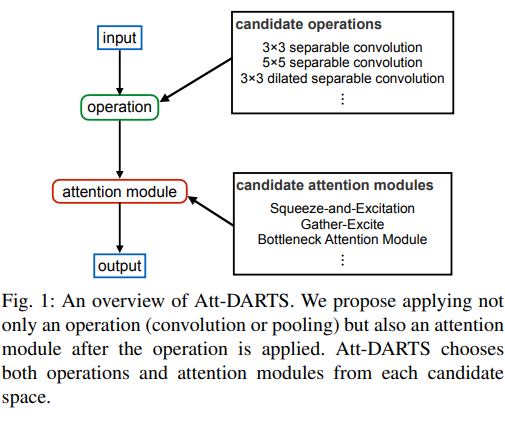

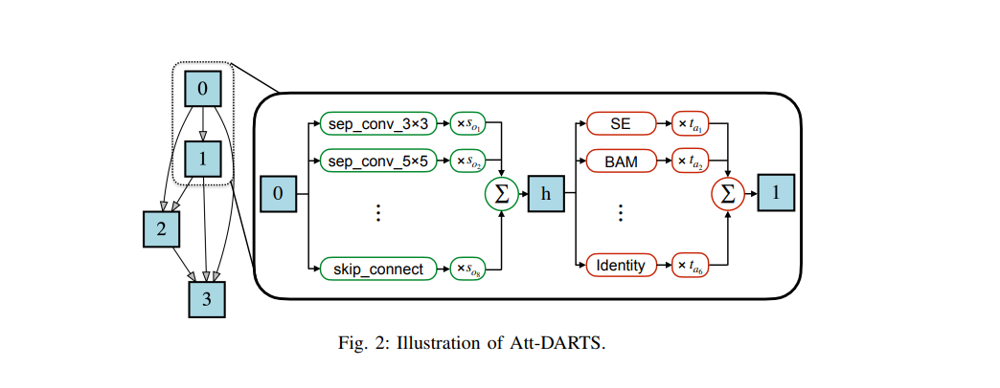

Att-DARTS (Differentiable Neural Architecture Search for Attention) là một phương pháp tìm kiếm kiến trúc neural tự động, đặc biệt tập trung vào việc tìm kiếm các mô-đun attention cùng với các phép toán convolution và pooling. Mục đích chính của Att-DARTS là cải thiện hiệu suất của mạng nơ-ron bằng cách tự động lựa chọn các mô-đun attention và tối ưu hóa kiến trúc neural cho các nhiệm vụ nhất định, thay vì chỉ sử dụng convolution đơn thuần như các phương pháp trước đó.

Att-DARTS được tạo ra vì các nghiên cứu trước đó chỉ tập trung vào tìm kiếm các phép toán convolution mà ít chú trọng đến mô-đun attention, mặc dù attention có khả năng loại bỏ các thông tin không cần thiết và tăng cường khả năng nhận diện đặc trưng quan trọng của mô hình. Att-DARTS bổ sung việc tìm kiếm các mô-đun attention vào quy trình, cho phép lựa chọn giữa các loại attention khác nhau (như Squeeze-and-Excitation, Gather-Excite, CBAM, BAM).

Phương pháp này được áp dụng cụ thể cho các tác vụ nhận diện đối tượng và phân loại ảnh, đặc biệt trong các bộ dữ liệu như CIFAR-10 và CIFAR-100. Các thử nghiệm cho thấy Att-DARTS tìm được các kiến trúc có hiệu suất cao hơn so với DARTS, giảm tỷ lệ lỗi phân loại và yêu cầu ít tham số hơn【9†source】.

http://vigir.missouri.edu/~gdesouza/Research/Conference_CDs/IEEE_WCCI_2020/IJCNN/Papers/N-21042.pdf

# Attention Pooling by Similarity

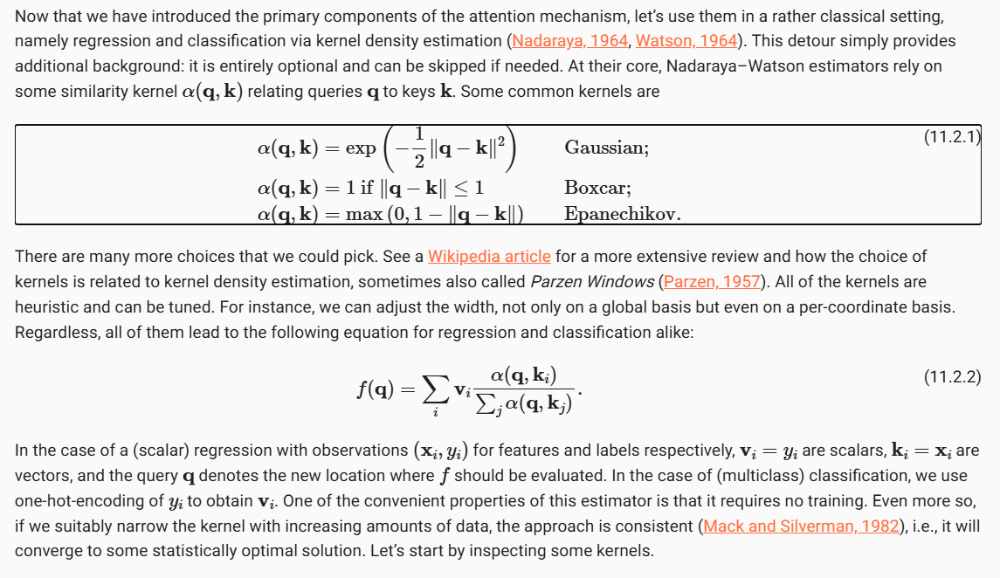

Trực quan plot các kernel : https://en.wikipedia.org/wiki/Kernel_%28statistics%29

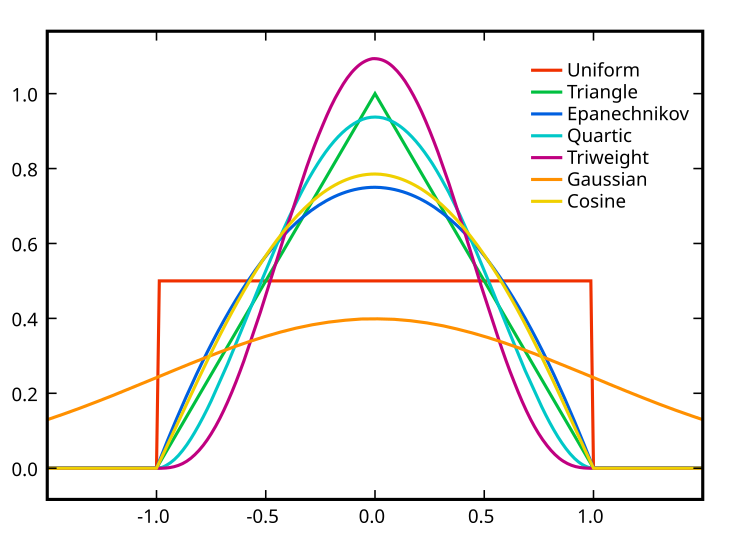

In [ ]:
!pip install d2l

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.9/58.9 kB 993.6 kB/s eta 0:00:00
  Using cached jedi-0.19.1-py2.py3-none-any.whl.metadata (22 kB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 111.7/111.7 kB 1.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.6/11.6 MB 17.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.1/17.1 MB 23.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.3/12.3 MB 23.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.6/62.6 kB 2.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 34.4/34.4 MB 8.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 98.3/98.3 kB 1.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 124.7/124.7 kB 6.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 93.5/93.5 kB 5.0 MB/s eta 0:00:00
Using cached jedi-0.19.1-py2.py3-none-any.whl (1.6 MB)
  Attempting uninstall: requests
    Found existing installation: requests 2.32.3
    Uni

In [ ]:
import numpy as np
import torch
from torch import nn
from torch.nn import functional as F
from d2l import torch as d2l

d2l.use_svg_display()

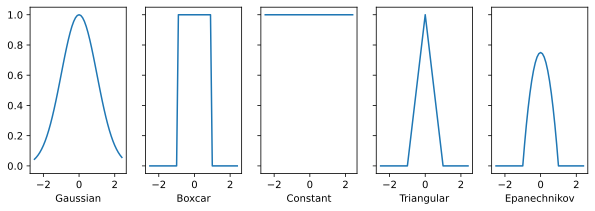

In [ ]:
# Define some kernels
def gaussian(x):
    return torch.exp(-x**2 / 2)

def boxcar(x):
    return torch.abs(x) < 1.0

def constant(x):
    return 1.0 + 0 * x

def Triangular(x):
    return torch.max(1 - torch.abs(x), torch.zeros_like(x))

def Epanechnikov(x):
    return torch.max(3/4*(1 - torch.pow(x, 2)) , torch.zeros_like(x))

fig, axes = d2l.plt.subplots(1, 5, sharey=True, figsize=(10, 3))

kernels = (gaussian, boxcar, constant, Triangular, Epanechnikov)
names = ('Gaussian', 'Boxcar', 'Constant', 'Triangular','Epanechnikov')
x = torch.arange(-2.5, 2.5, 0.1)
for kernel, name, ax in zip(kernels, names, axes):
    ax.plot(x.detach().numpy(), kernel(x).detach().numpy())
    ax.set_xlabel(name)

d2l.plt.show()

In [ ]:
def f(x):
    return 2 * torch.sin(x) + x

n = 40
x_train, _ = torch.sort(torch.rand(n) * 5)
y_train = f(x_train) + torch.randn(n)
x_val = torch.arange(0, 5, 0.1)
y_val = f(x_val)

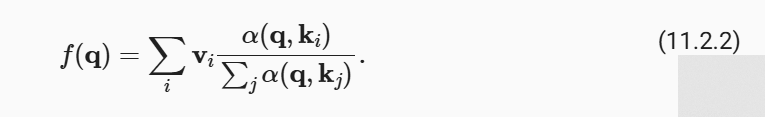

In [ ]:
def nadaraya_watson(x_train, y_train, x_val, kernel):
    dists = x_train.reshape((-1, 1)) - x_val.reshape((1, -1))
    # q : x_train, k : x_val
    # Each column/row corresponds to each query/key
    k = kernel(dists).type(torch.float32)
    # Normalization over keys for each query
    attention_w = k / k.sum(0)
    y_hat = y_train@attention_w # yhat : f(q) at formula 11.2.2
    return y_hat, attention_w

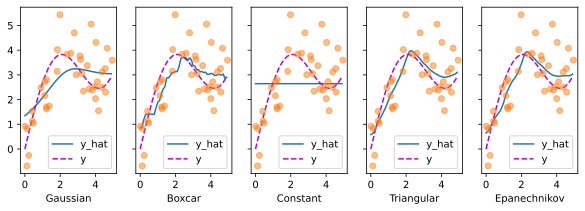

In [ ]:
def plot(x_train, y_train, x_val, y_val, kernels, names, attention=False):
    fig, axes = d2l.plt.subplots(1, 5, sharey=True, figsize=(10, 3))
    for kernel, name, ax in zip(kernels, names, axes):
        y_hat, attention_w = nadaraya_watson(x_train, y_train, x_val, kernel)
        if attention:
            pcm = ax.imshow(attention_w.detach().numpy(), cmap='Reds')
        else:
            ax.plot(x_val, y_hat)
            ax.plot(x_val, y_val, 'm--')
            ax.plot(x_train, y_train, 'o', alpha=0.5);
        ax.set_xlabel(name)
        if not attention:
            ax.legend(['y_hat', 'y'])
    if attention:
        fig.colorbar(pcm, ax=axes, shrink=0.7)

plot(x_train, y_train, x_val, y_val, kernels, names)

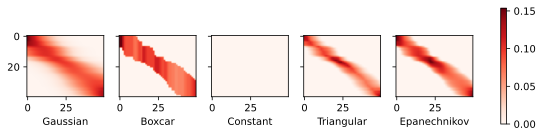

In [ ]:
plot(x_train, y_train, x_val, y_val, kernels, names, attention=True)

Hình ảnh trực quan cho thấy rõ lý do tại sao các ước tính cho Gaussian, Boxcar và Epanechikov lại rất giống nhau: xét cho cùng, chúng đều có nguồn gốc từ các trọng số chú ý rất giống nhau, mặc dù dạng chức năng khác nhau của hạt nhân. Điều này đặt ra câu hỏi liệu điều này có luôn luôn như vậy hay không

## Adapting Attention Pooling

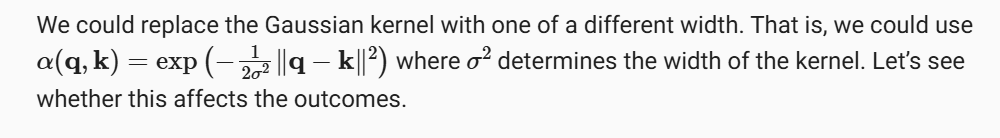

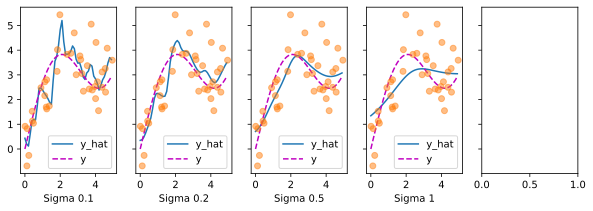

In [ ]:
sigmas = (0.1, 0.2, 0.5, 1)
names = ['Sigma ' + str(sigma) for sigma in sigmas]

def gaussian_with_width(sigma):
    return (lambda x: torch.exp(-x**2 / (2*sigma**2)))

kernels = [gaussian_with_width(sigma) for sigma in sigmas]
plot(x_train, y_train, x_val, y_val, kernels, names)

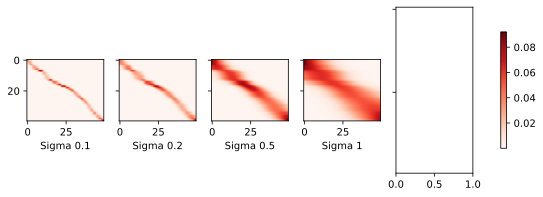

In [ ]:
plot(x_train, y_train, x_val, y_val, kernels, names, attention=True)

 Đầu tiên, nó là một trong những tiền thân sớm nhất của cơ chế chú ý hiện đại.

 Thứ hai, nó rất tốt cho việc hình dung.

 Thứ ba, và cũng quan trọng không kém, nó thể hiện giới hạn của các cơ chế chú ý thủ công. Một chiến lược tốt hơn nhiều là **tìm hiểu cơ chế**, bằng cách **học cách biểu diễn các truy vấn và khóa**. Đây là những gì chúng ta sẽ bắt tay vào trong các phần sau

Kết luận : Hồi quy hạt nhân Nadaraya–Watson là tiền thân ban đầu của các cơ chế chú ý hiện tại. Nó có thể được sử dụng trực tiếp mà không cần đào tạo hoặc điều chỉnh để phân loại hoặc hồi quy. Trọng số chú ý được chỉ định theo độ tương tự (hoặc khoảng cách) giữa truy vấn và khóa và theo số lượng quan sát tương tự có sẵn

In [ ]:
import numpy as np

x = np.random.randint((2,2))
print(x.reshape((-1,1)).shape)

(2, 1)


exercise:

In [ ]:
!pip install d2l

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.9/58.9 kB 2.3 MB/s eta 0:00:00
  Using cached jedi-0.19.1-py2.py3-none-any.whl.metadata (22 kB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 111.7/111.7 kB 5.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.6/11.6 MB 71.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.1/17.1 MB 78.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.3/12.3 MB 82.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.6/62.6 kB 4.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 34.4/34.4 MB 12.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 98.3/98.3 kB 6.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 124.7/124.7 kB 7.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 93.5/93.5 kB 4.4 MB/s eta 0:00:00
Using cached jedi-0.19.1-py2.py3-none-any.whl (1.6 MB)
  Attempting uninstall: requests
    Found existing installation: requests 2.32.3
    Unin

Thêm trọng số và loss vào NW

In [ ]:
from d2l import torch as d2l
import torch
from torch import nn

In [ ]:
class SyntheticNWData(d2l.DataModule):
    """Synthetic data for linear regression."""

    def __init__(self, noise=0.01, num_train=1000, num_val=1000,
                 batch_size=32):
        super().__init__()
        self.save_hyperparameters()
        n = num_train + num_val
        self.X = torch.randn(n, 1)
        noise = torch.randn(n, 1) * noise
        self.y = 2 * torch.sin(self.X) + self.X + noise

    def get_tensorloader(self, tensor, train, indices=slice(0, None)):
        tensor = tuple(a[indices] for a in tensor)
        dataset = torch.utils.data.TensorDataset(*tensor)
        return torch.utils.data.DataLoader(dataset, self.batch_size, shuffle=train)

    def get_dataloader(self, train):
        i = slice(0, self.num_train) if train else slice(self.num_train, None)
        return self.get_tensorloader((self.X, self.y), train, i)

class NWReg(d2l.Module):
    def __init__(self, x_train, y_train, lr, sigma=0.01):
        super().__init__()
        self.save_hyperparameters()
        self.w = torch.normal(0, sigma, (1, 1), requires_grad=True)

    def forward(self, X):
        y_hat, attention_w = self.nadaraya_watson(self.x_train, self.y_train, X)
        return y_hat

    def loss(self, y_hat, y):
        l = (y_hat - y)**2 / 2
        return l.mean()

    def configure_optimizers(self):
        return d2l.SGD([self.w], self.lr)

    def nadaraya_watson(self, x_train, y_train, x_val):
        dists = x_train.reshape((-1, 1)) - x_val.reshape((1, -1))
        # Each column/row corresponds to each query/key
        k = torch.exp(-dists**2 /2/(torch.pow(self.w, 2)+0.00001))# with w is weight
        # Normalization over keys for each query
        attention_w = k / k.sum(0)
        y_hat = y_train.T@attention_w
        return y_hat, attention_w

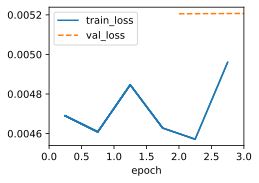

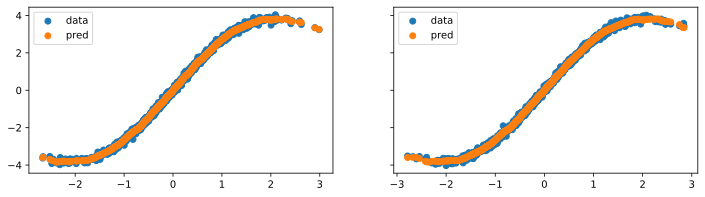

In [ ]:
data = SyntheticNWData(batch_size=1, noise=0.1)
model = NWReg(x_train=data.X[:data.num_train], y_train=data.y[:data.num_train], lr=0.1)
trainer = d2l.Trainer(max_epochs=3) #, num_gpus=1
trainer.fit(model, data)
fig, axes = d2l.plt.subplots(1, 2, sharey=True, figsize=(12, 3))
axes[0].scatter(data.X[:data.num_train],data.y[:data.num_train],label='data')
axes[0].scatter(data.X[:data.num_train],model(data.X[:data.num_train]).detach().numpy() ,label='pred')
axes[0].legend()
axes[1].scatter(data.X[-data.num_train:],data.y[-data.num_train:],label='data')
axes[1].scatter(data.X[-data.num_train:],model(data.X[-data.num_train:]).detach().numpy() ,label='pred')
axes[1].legend()

In [ ]:
class NWRmReg(NWReg):
    def __init__(self, x_train, y_train, lr, sigma=0.01):
        super().__init__(x_train, y_train, lr, sigma=sigma)
        self.save_hyperparameters()

    def forward(self, X):
        y_hats = []  # Khởi tạo danh sách để lưu trữ các dự đoán
        for i in X:  # Duyệt qua từng điểm dữ liệu trong X
            # Loại bỏ điểm dữ liệu hiện tại khỏi tập huấn luyện
            cur = self.x_train != i
            x_train = self.x_train[cur].reshape(-1, *self.x_train.shape[1:])
            y_train = self.y_train[cur].reshape(-1, *self.y_train.shape[1:])

            # Dự đoán giá trị cho điểm dữ liệu hiện tại
            y_hat, attention_w = self.nadaraya_watson(x_train, y_train, i)

            # Lưu dự đoán vào danh sách
            y_hats.append(y_hat)

        # Nối tất cả các dự đoán lại thành một tensor
        return torch.cat(y_hats)


    def loss(self, y_hat, y):
        l = (y_hat - y)**2 / 2
        return l.mean()

    def configure_optimizers(self):
        return d2l.SGD([self.w], self.lr)

    def nadaraya_watson(self, x_train, y_train, x_val):
        dists = x_train.reshape((-1, 1)) - x_val.reshape((1, -1))
        # Each column/row corresponds to each query/key
        k = torch.exp(-dists**2 /2/torch.pow(self.w, 2))
        # Normalization over keys for each query
        attention_w = k / k.sum(0)
        y_hat = y_train.T@attention_w
        return y_hat, attention_w


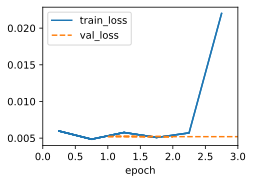

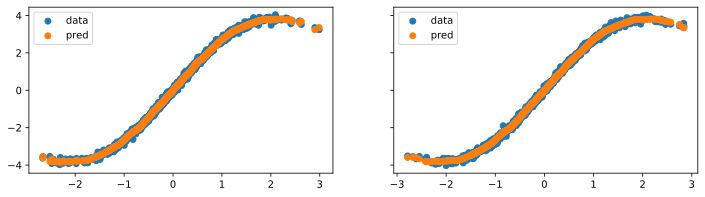

In [ ]:
# data = SyntheticNWData(batch_size=1, noise=0.1)
model = NWRmReg(x_train=data.X[:data.num_train], y_train=data.y[:data.num_train], lr=0.1)
trainer = d2l.Trainer(max_epochs=3) #, num_gpus=1
trainer.fit(model, data)
fig, axes = d2l.plt.subplots(1, 2, sharey=True, figsize=(12, 3))
axes[0].scatter(data.X[:data.num_train],data.y[:data.num_train],label='data')
axes[0].scatter(data.X[:data.num_train],model(data.X[:data.num_train]).detach().numpy() ,label='pred')
axes[0].legend()
axes[1].scatter(data.X[data.num_train:],data.y[data.num_train:],label='data')
axes[1].scatter(data.X[data.num_train:],model(data.X[data.num_train:]).detach().numpy() ,label='pred')
axes[1].legend()

xem thêm Attention Pooling: Nadaraya-Watson Kernel Regression : chttps://github.com/d2l-ai/d2l-zh/blob/master/chapter_attention-mechanisms/nadaraya-waston_origin.

# Attention Scoring Functions

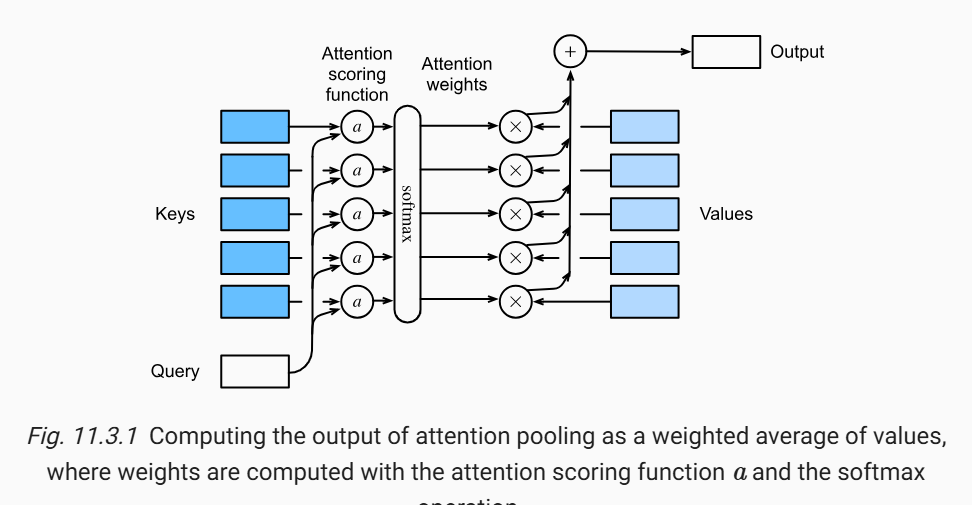

In [ ]:
import math
import torch
from d2l import torch as d2l
from torch import nn

## Dot Product Attention

 Transformers (Vaswani et al., 2017): Trong bài báo giới thiệu chức năng chú ý được sử dụng phổ biến đầu tiên được sử dụng với  chia tỷ lệ tích số chấm thành 1 / sqrt 𝑑

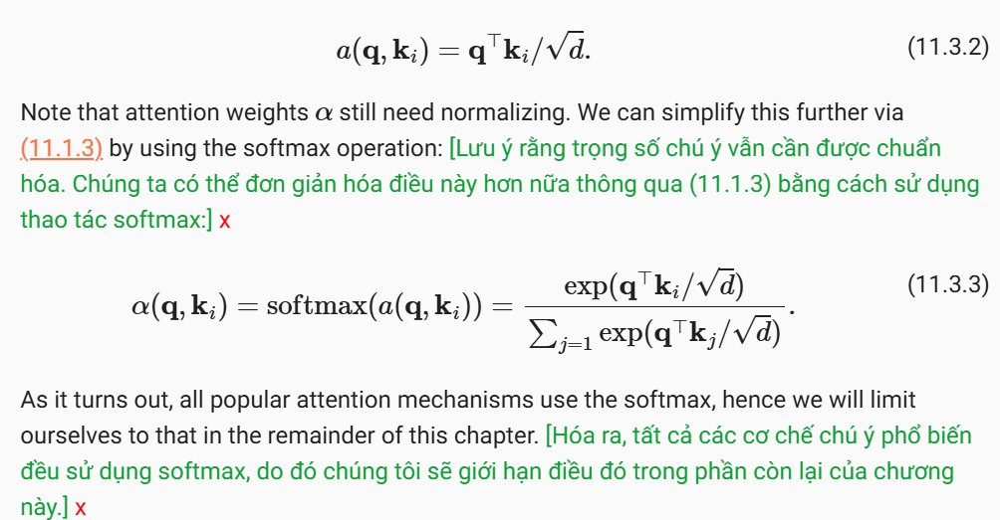


𝑑
𝑘 đề cập đến **kích thước của không gian kích thước của các vectors khóa (keys) và truy vấn (queries)** trong cơ chế chú ý (attention mechanism). Cụ thể, trong mô hình chú ý, các vectors truy vấn (queries) và khóa (keys) đều có kích thước là
𝑑
𝑘.

## Convenience Functions

Chúng ta cần một số chức năng để triển khai cơ chế chú ý một cách hiệu quả. Điều này bao gồm các công cụ để xử lý các chuỗi có độ dài thay đổi (phổ biến cho xử lý ngôn ngữ tự nhiên) và các công cụ để đánh giá hiệu quả trên các lô nhỏ (nhân ma trận lô).

### Masked Softmax Operation

One of the most popular applications of the attention mechanism is to sequence models. Hence we need to be able to deal with sequences of different lengths. In some cases, such sequences may end up in the same minibatch, necessitating padding with dummy tokens for shorter sequences (see Section 10.5 for an example). These special tokens do not carry meaning. For instance, assume that we have the following three sentences: [Một trong những ứng dụng phổ biến nhất của cơ chế chú ý là mô hình trình tự. Do đó, chúng ta cần có khả năng xử lý các chuỗi có độ dài khác nhau. Trong một số trường hợp, các chuỗi như vậy có thể kết thúc trong cùng một minibatch, đòi hỏi phải đệm bằng mã thông báo giả cho các chuỗi ngắn hơn (xem Phần 10.5 để biết ví dụ). Những mã thông báo đặc biệt này không mang ý nghĩa. Ví dụ: giả sử chúng ta có ba câu sau:]

In [ ]:
Dive  into  Deep    Learning
Learn to    code    <blank>
Hello world <blank> <blank>

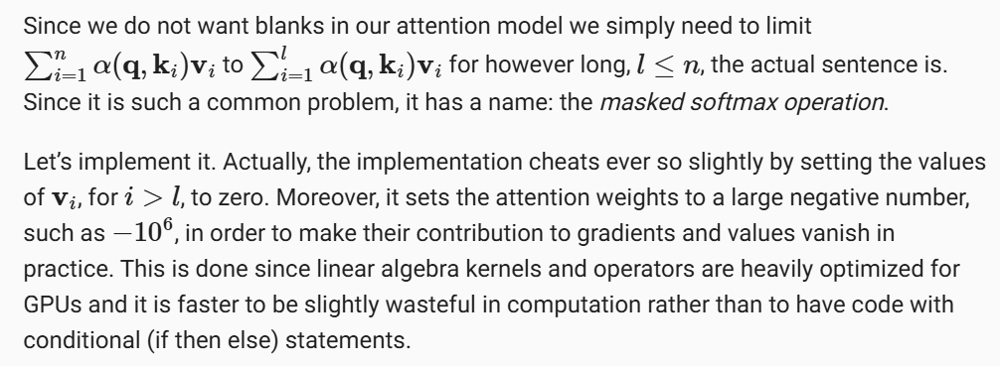

Việc các blank được cho vào tính toán làm mất thời gian và ảnh hưởng đến quá trình mà một attention thực hiện vì vậy marked softmax operation ra đời nó sử được hiểu là chỉ giới với các từ được chú ý còn các từ black và các tokens phụ bị loại bỏ bằng cách cho nó bằng 0 hoặc cho nó thành một số âmm cực lớn để gradient biến mất làm nhanh quá trình huấn luyện

l là dài độ tokens mà một attention thực hiện độ dài hợp lệ (valid_lens)

In [ ]:
def masked_softmax(X, valid_lens):
    """Perform softmax operation by masking elements on the last axis."""
    # X: 3D tensor, valid_lens: 1D or 2D tensor
    def _sequence_mask(X, valid_len, value=0):
        maxlen = X.size(1)
        mask = torch.arange((maxlen), dtype=torch.float32,
                            device=X.device)[None, :] < valid_len[:, None]
        X[~mask] = value
        return X

    if valid_lens is None:
        return nn.functional.softmax(X, dim=-1)
    else:
        shape = X.shape
        if valid_lens.dim() == 1:
            valid_lens = torch.repeat_interleave(valid_lens, shape[1])
        else:
            valid_lens = valid_lens.reshape(-1)
        # On the last axis, replace masked elements with a very large negative
        # value, whose exponentiation outputs 0
        X = _sequence_mask(X.reshape(-1, shape[-1]), valid_lens, value=-1e6)
        return nn.functional.softmax(X.reshape(shape), dim=-1)

In [ ]:
masked_softmax(torch.rand(2, 2, 4), torch.tensor([2, 3]))

tensor([[[0.5039, 0.4961, 0.0000, 0.0000],
         [0.4694, 0.5306, 0.0000, 0.0000]],

        [[0.2517, 0.4670, 0.2813, 0.0000],
         [0.3719, 0.3432, 0.2849, 0.0000]]])

In [ ]:
masked_softmax(torch.rand(2, 2, 4), torch.tensor([[1, 3], [2, 4]]))

tensor([[[1.0000, 0.0000, 0.0000, 0.0000],
         [0.3248, 0.2958, 0.3794, 0.0000]],

        [[0.6088, 0.3912, 0.0000, 0.0000],
         [0.3817, 0.2148, 0.2074, 0.1960]]])

### Batch Matrix Multiplication

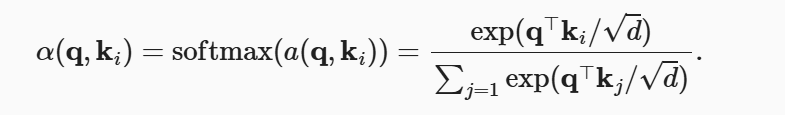

Thay vì thực hiện hàm softmax như trên thì chúng cần cần tối ưu khi nhân các minibactch Q và K được gọi Batch maxtrix multiplication

Another commonly used operation is to multiply batches of matrices by one another. This comes in handy when we have minibatches of queries, keys, and values. More specifically, assume that

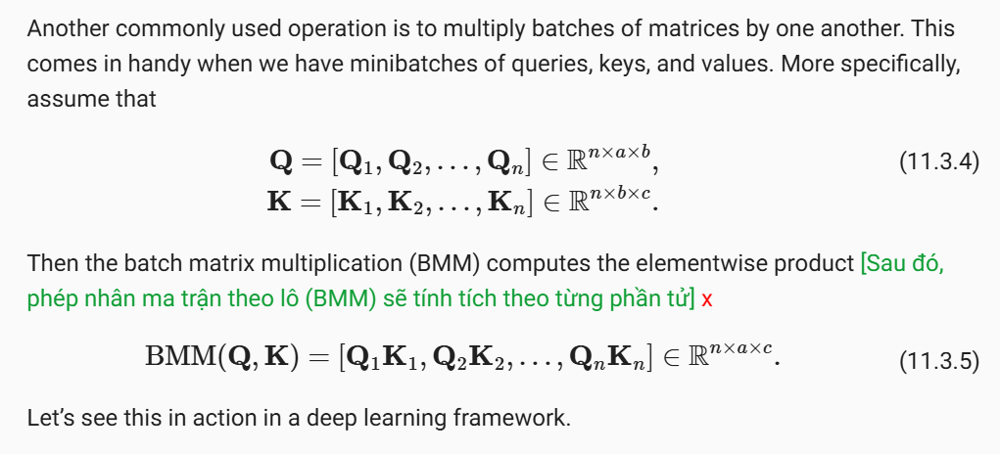

In [ ]:
Q = torch.ones((2, 3, 4))
K = torch.ones((2, 4, 6))
d2l.check_shape(torch.bmm(Q, K), (2, 3, 6)) #  Batch Matrix Multiplication (bmm)

Chúng ta hãy quay lại sản phẩm chấm chú ý được giới thiệu trong (11.3.2). Nói chung, nó yêu cầu cả truy vấn và khóa phải có cùng độ dài vectơ, chẳng hạn 𝑑 , mặc dù điều này có thể được giải quyết dễ dàng bằng cách thay thế 𝑞 ⊤ 𝑘 bằng 𝑞 ⊤ 𝑀 𝑘 trong đó 𝑀 là ma trận được chọn phù hợp để dịch giữa cả hai không gian . Bây giờ giả sử rằng kích thước phù hợp.


Trong thực tế, chúng ta thường nghĩ đến các minibatch để đạt hiệu quả, chẳng hạn như tính toán sự chú ý cho 𝑛 truy vấn và 𝑚 cặp khóa-giá trị, trong đó các truy vấn và khóa có độ dài 𝑑 và các giá trị có độ dài 𝑣 . Tích số chấm được chia tỷ lệ của truy vấn 𝑄 ∈ 𝑅 𝑛 × 𝑑 , khóa 𝐾 ∈ 𝑅 𝑚 × 𝑑 và các giá trị 𝑉 ∈ 𝑅 𝑚 × 𝑣 do đó có thể được viết là

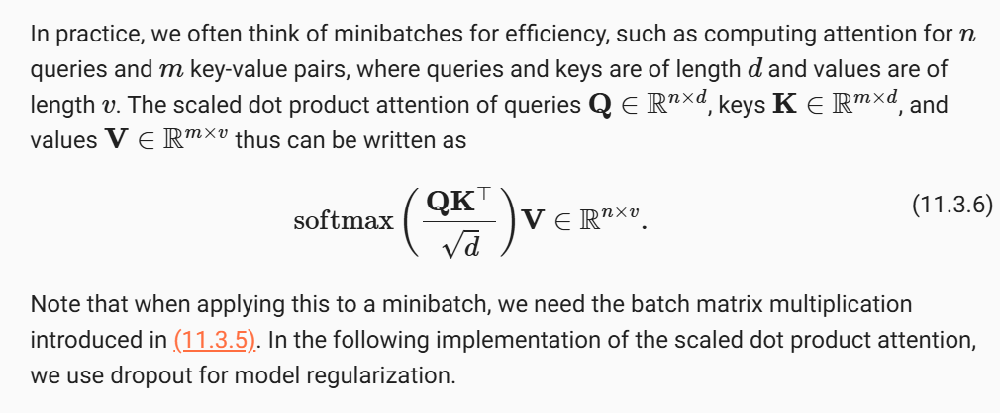

In [ ]:
import math

In [ ]:
class DotProductAttention(nn.Module):
    """Scaled dot product attention."""
    def __init__(self, dropout):
        super().__init__()
        self.dropout = nn.Dropout(dropout)

    # Shape of queries: (batch_size, no. of queries, d)
    # Shape of keys: (batch_size, no. of key-value pairs, d)
    # Shape of values: (batch_size, no. of key-value pairs, value dimension)
    # Shape of valid_lens: (batch_size,) or (batch_size, no. of queries)
    def forward(self, queries, keys, values, valid_lens=None):
        d = queries.shape[-1]
        # Swap the last two dimensions of keys with keys.transpose(1, 2)
        scores = torch.bmm(queries, keys.transpose(1, 2)) / math.sqrt(d)
        self.attention_weights = masked_softmax(scores, valid_lens)
        return torch.bmm(self.dropout(self.attention_weights), values)

In [ ]:
queries = torch.normal(0, 1, (2, 1, 2))
keys = torch.normal(0, 1, (2, 10, 2))
values = torch.normal(0, 1, (2, 10, 4))
valid_lens = torch.tensor([2, 6])

attention = DotProductAttention(dropout=0.5)
attention.eval()
d2l.check_shape(attention(queries, keys, values, valid_lens), (2, 1, 4))

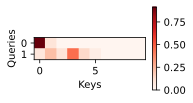

In [ ]:
d2l.show_heatmaps(attention.attention_weights.reshape((1, 1, 2, 10)),
                  xlabel='Keys', ylabel='Queries')

## Additive Attention

Khi truy vấn 𝑞 và khóa 𝑘 là vectơ có chiều khác nhau, chúng ta có thể sử dụng ma trận để giải quyết phần không khớp thông qua 𝑞 ⊤ 𝑀 𝑘 hoặc chúng ta có thể sử dụng sự chú ý bổ sung làm chức năng cho điểm. Một lợi ích khác là, như tên gọi của nó, sự chú ý có tính bổ sung. Điều này có thể dẫn đến một số tiết kiệm tính toán nhỏ. Cho một truy vấn 𝑞 ∈ 𝑅 𝑞 và một khóa 𝑘 ∈ 𝑅 𝑘 , chức năng chấm điểm chú ý bổ sung (Bahdanau và cộng sự, 2014) được đưa ra bởi

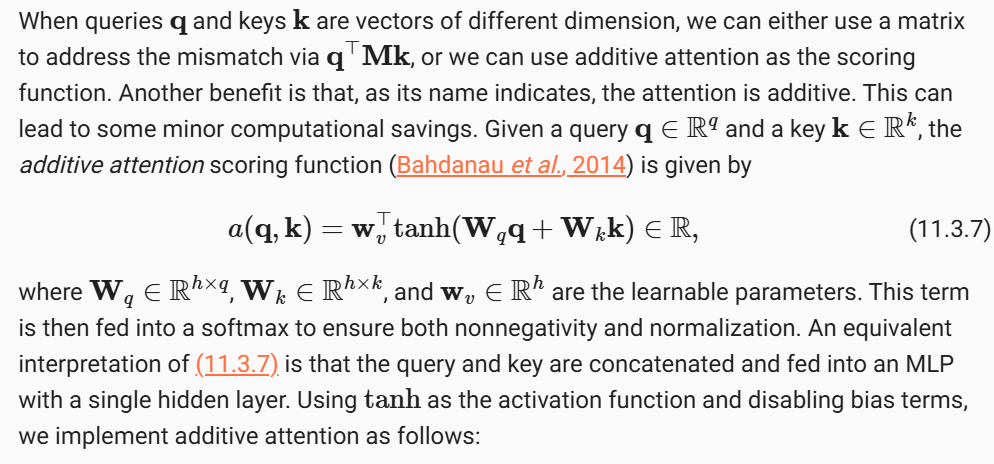

Cụm từ "Thuật ngữ này" trong ngữ cảnh bạn đề cập đến chính là giá trị hàm chấm điểm chú ý \( 𝑎(𝑞, 𝑘) = 𝑤_𝑣^⊤ \cdot \text{tanh}(𝑊_𝑞𝑞 + 𝑊_𝑘𝑘) \). Giá trị này là kết quả của quá trình tính toán điểm chú ý (attention score) giữa truy vấn \( q \) và khóa \( k \). Sau khi có giá trị này, nó được đưa vào hàm softmax để đảm bảo kết quả có tính không âm và tổng của các giá trị được chuẩn hóa (tổng bằng 1).

Trong cơ chế attention, khi truy vấn (query) và khóa (key) có kích thước khác nhau, một cách để giải quyết sự không khớp là sử dụng ma trận biến đổi 𝑞 ⊤ 𝑀 𝑘, hoặc sử dụng cơ chế attention bổ sung (additive attention). Điều này có thể giúp tiết kiệm một số tính toán.

Hàm chấm điểm attention cộng được giới thiệu bởi Bahdanau et al. (2014), được biểu diễn bởi phương trình sau:

\[
𝑎(𝑞, 𝑘) = 𝑤_𝑣^⊤ \cdot \text{tanh}(𝑊_𝑞𝑞 + 𝑊_𝑘𝑘)
\]

trong đó:

- 𝑞 ∈ 𝑅^𝑞 là truy vấn,
- 𝑘 ∈ 𝑅^𝑘 là khóa,
- 𝑊_𝑞 ∈ 𝑅^ℎ × 𝑞 và 𝑊_𝑘 ∈ 𝑅^ℎ × 𝑘 là các ma trận trọng số có thể học được,
- 𝑤_𝑣 ∈ 𝑅^ℎ là một vector trọng số.

Hàm này sử dụng tanh làm hàm kích hoạt và không sử dụng bias. Sau đó, kết quả được đưa vào hàm softmax để đảm bảo tính không âm và chuẩn hóa.

Cách giải thích tương đương là việc nối các vector truy vấn và khóa, sau đó đưa vào một MLP với một lớp ẩn duy nhất.

In [ ]:
class AdditiveAttention(nn.Module):
    """Additive attention."""
    def __init__(self, num_hiddens, dropout, **kwargs):
        super(AdditiveAttention, self).__init__(**kwargs)
        self.W_k = nn.LazyLinear(num_hiddens, bias=False)
        self.W_q = nn.LazyLinear(num_hiddens, bias=False)
        self.w_v = nn.LazyLinear(1, bias=False)
        self.dropout = nn.Dropout(dropout)

    def forward(self, queries, keys, values, valid_lens):
        queries, keys = self.W_q(queries), self.W_k(keys)
        # After dimension expansion, shape of queries: (batch_size, no. of
        # queries, 1, num_hiddens) and shape of keys: (batch_size, 1, no. of
        # key-value pairs, num_hiddens). Sum them up with broadcasting
        features = queries.unsqueeze(2) + keys.unsqueeze(1)
        features = torch.tanh(features)
        # There is only one output of self.w_v, so we remove the last
        # one-dimensional entry from the shape. Shape of scores: (batch_size,
        # no. of queries, no. of key-value pairs)
        scores = self.w_v(features).squeeze(-1)
        self.attention_weights = masked_softmax(scores, valid_lens)
        # Shape of values: (batch_size, no. of key-value pairs, value
        # dimension)
        return torch.bmm(self.dropout(self.attention_weights), values)

In [ ]:
queries = torch.normal(0, 1, (2, 1, 20))

attention = AdditiveAttention(num_hiddens=8, dropout=0.1)
attention.eval()
d2l.check_shape(attention(queries, keys, values, valid_lens), (2, 1, 4))


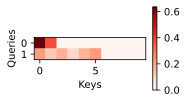

In [ ]:
d2l.show_heatmaps(attention.attention_weights.reshape((1, 1, 2, 10)),
                  xlabel='Keys', ylabel='Queries')

## Exercise

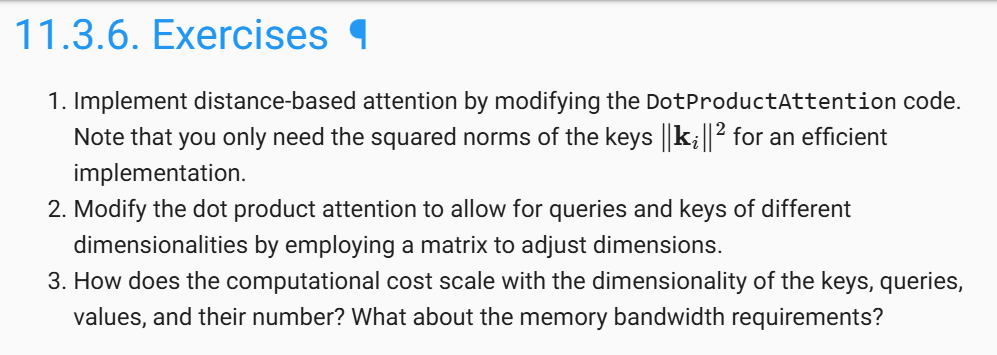

1. Triển khai sự chú ý dựa trên khoảng cách bằng cách sửa đổi mã DotProductAttention.
Lưu ý rằng bạn chỉ cần định mức bình phương của (keys) ‖ 𝑘 𝑖 ‖ 2 để triển khai hiệu quả.

Triển khai sự chú ý dựa trên khoảng cách bằng cách sửa đổi mã DotProductAttention.
Lưu ý rằng bạn chỉ cần định mức bình phương của (keys) ‖ 𝑘 𝑖 ‖ 2 để triển khai hiệu quả.

In [ ]:
"""Triển khai sự chú ý dựa trên khoảng cách bằng cách sửa đổi mã DotProductAttention.
Lưu ý rằng bạn chỉ cần định mức bình phương của (keys) ‖ 𝑘 𝑖 ‖ 2 để triển khai hiệu quả."""

class DistanceAttention(nn.Module):
    """Scaled dot product attention."""
    def __init__(self, dropout):
        super().__init__()
        self.dropout = nn.Dropout(dropout)
    # Frobenius norm produces the same result as p=2 in all cases except
    # when dim is a list of three or more dims, in which case Frobenius norm throws an error.
    # Shape of queries: (batch_size, no. of queries, d)
    # Shape of keys: (batch_size, no. of key-value pairs, d)
    # Shape of values: (batch_size, no. of key-value pairs, value dimension)
    # Shape of valid_lens: (batch_size,) or (batch_size, no. of queries)
    def forward(self, queries, keys, values, valid_lens=None):
        d = queries.shape[-1]
        # Swap the last two dimensions of keys with keys.transpose(1, 2)
        scores = torch.bmm(queries, keys.transpose(1, 2)) / math.sqrt(d)
        key_norms = torch.sum(keys ** 2, dim=-1)/ math.sqrt(d) # (batch_size, num_keys)
        scores = scores - 0.5*key_norms.unsqueeze(1) # (batch_size, num_queries, num_keys)
        self.attention_weights = masked_softmax(scores, valid_lens)
        return torch.bmm(self.dropout(self.attention_weights), values)

In [ ]:
queries = torch.normal(0, 1, (2, 1, 2))
keys = torch.normal(0, 1, (2, 10, 2))
values = torch.normal(0, 1, (2, 10, 4))
valid_lens = torch.tensor([2, 6])

attention = DistanceAttention(dropout=0.5)
attention.eval()
attention(queries, keys, values, valid_lens).shape

torch.Size([2, 1, 4])

2. Sửa đổi sự chú ý của dot product attention để cho phép truy vấn và khóa có các chiều khác nhau bằng cách sử dụng ma trận để điều chỉnh các kích thước.

In [ ]:
class DiffDimDotProductAttention(nn.Module):
    """Scaled dot product attention."""
    def __init__(self, num_hiddens, dropout):
        super().__init__()
        # num_hiddens = keys.shape[-1] (chiều của keys)
        self.W_q = nn.LazyLinear(num_hiddens, bias=False) # : Một phép biến đổi tuyến tính (không có bias)  ánh xạ lại số chiều sao cho cùng chiều với keys
        # dùng để chiếu các queries đầu vào sang một không gian có kích thước khác.
        self.dropout = nn.Dropout(dropout)

    # Shape of queries: (batch_size, no. of queries, d)
    # Shape of keys: (batch_size, no. of key-value pairs, d)
    # Shape of values: (batch_size, no. of key-value pairs, value dimension)
    # Shape of valid_lens: (batch_size,) or (batch_size, no. of queries)
    def forward(self, queries, keys, values, valid_lens=None):
        queries = self.W_q(queries) #  Chiếu các queries sang một không gian kích thước (num_hiddens) khác bằng cách sử dụng lớp tuyến tính W_q
        print(queries.shape)
        print(keys.transpose(1, 2).shape)
        d = queries.shape[-1]
        # Swap the last two dimensions of keys with keys.transpose(1, 2)
        scores = torch.bmm(queries, keys.transpose(1, 2)) / math.sqrt(d)
        print(scores.shape)
        self.attention_weights = masked_softmax(scores, valid_lens)
        return torch.bmm(self.dropout(self.attention_weights), values)
queries = torch.normal(0, 1, (2, 1, 15))
keys = torch.normal(0, 1, (2, 10, 5))
values = torch.normal(0, 1, (2, 10, 4))
valid_lens = torch.tensor([2, 6])
# num_hiddens = keys.shape[-1] (chiều của keys)
# trường hợp queries có số chiều 15 lên hơn keys 5 thì nó chiều 15 của queries sẽ qua một linear ánh xạ về 5 chiều cho cùng với keys
attention = DiffDimDotProductAttention(keys.shape[-1], dropout=0.5)
attention.eval()
attention(queries, keys, values, valid_lens).shape

torch.Size([2, 1, 10])
torch.Size([2, 19, 10])


RuntimeError: Expected size for first two dimensions of batch2 tensor to be: [2, 10] but got: [2, 19].

3. Chi phí tính toán thay đổi quy mô như thế nào với tính chiều của các khóa, truy vấn, giá trị và số lượng của chúng? Còn yêu cầu băng thông bộ nhớ thì sao?
Chi phí tính toán của sự tự chú ý phụ thuộc vào tính chiều và số lượng khóa, truy vấn và giá trị. Cho n là số khóa, truy vấn và giá trị và d là tính chiều của chúng. Sau đó, chi phí tính toán của sự tự chú ý là:

O (n d ^ 2) để tính toán ma trận truy vấn, khóa và giá trị bằng cách biến đổi
    Q(Q,K).V
O(n^2 d) để tính tích chấm giữa truy vấn và ma trận khóa.
    Q dot K
O(n^2 d) để tính tổng trọng số của ma trận giá trị.
    
Do đó, tổng chi phí tính toán của sự tự chú ý là O (n ^ 2 d + n d ^ 2), tỷ lệ tứ giác với n và tuyến tính với d.

Các yêu cầu băng thông bộ nhớ của sự tự chú ý là:

O(n d) để lưu trữ ma trận đầu vào.
O(n d) để lưu trữ ma trận truy vấn, khóa và giá trị.
O(n^2) để lưu trữ ma trận chú ý.
O(n d) để lưu trữ ma trận đầu ra.
Do đó, tổng yêu cầu băng thông bộ nhớ của sự tự chú ý là O (n ^ 2 + n d), có tỷ lệ tứ giác với n và tuyến tính với d.

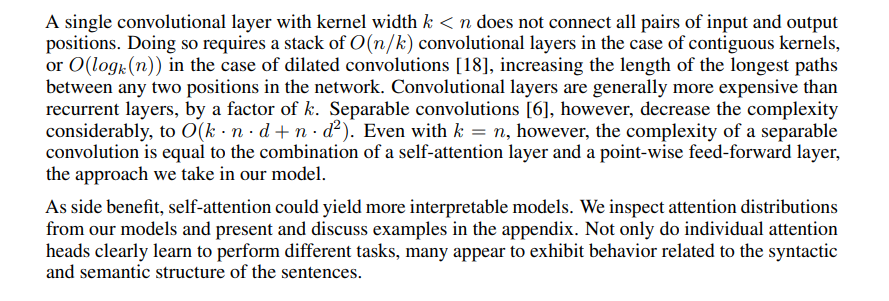

xem thêm exercise : https://pandalab.me/archives/attention_scoring_functions

# The Bahdanau Attention Mechanism

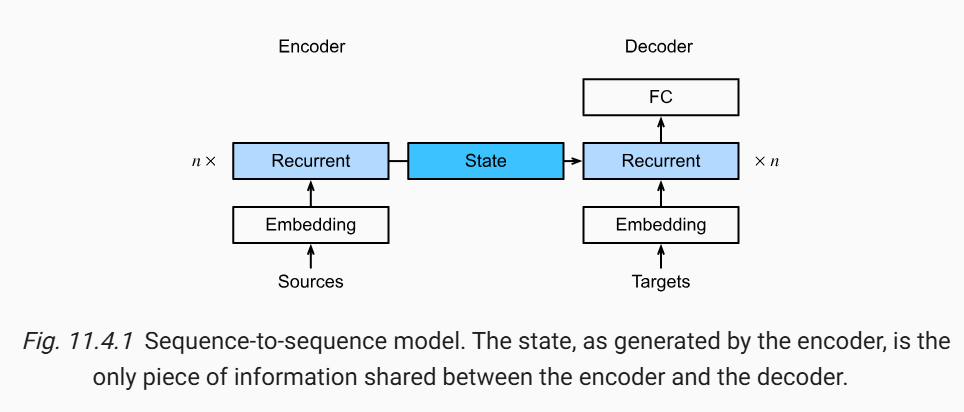

## Model

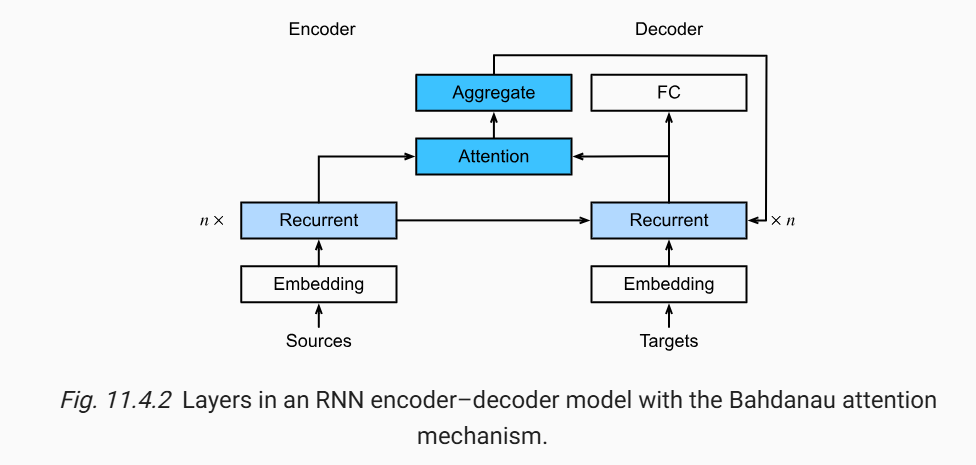

\documentclass{article}
\usepackage{amsmath}
\usepackage{amsfonts}

\begin{document}

Nội dung trên liên quan đến kiến trúc seq2seq (sequence-to-sequence) kết hợp với cơ chế attention trong học sâu, cụ thể là việc cập nhật biến ngữ cảnh \( c_t' \). Đây là cách tiếp cận động, nơi biến ngữ cảnh \( c_t' \) không giữ nguyên mà được cập nhật dựa trên cả các trạng thái ẩn của bộ mã hóa (\( h_t \)) và trạng thái đã được giải mã trước đó (\( s_{t-1} \)).

Công thức để tính \( c_t' \) sử dụng tổng có trọng số của các trạng thái ẩn \( h_t \) từ bộ mã hóa, với trọng số attention \( \alpha(s_{t-1}, h_t) \):

\[
c_t' = \sum_{t=1}^{T} \alpha(s_{t-1}, h_t) h_t
\]

Ở đây:

- \( s_{t-1} \) là truy vấn (query),
- \( h_t \) là cả khóa (key) và giá trị (value),
- \( \alpha(s_{t-1}, h_t) \) là trọng số attention.

Kết quả của quá trình này là biến ngữ cảnh \( c_t' \), được sử dụng để tạo ra trạng thái mới \( s_t' \) trong bộ giải mã, từ đó sinh ra một token mới. Trọng số attention \( \alpha \) được tính bằng cách sử dụng hàm tính điểm attention cộng (additive attention):

\[
\alpha(s_{t-1}, h_t) = \text{softmax}(v^\top \tanh(W_1 s_{t-1} + W_2 h_t))
\]

Điểm đặc biệt của mô hình này là sau khi tạo ra mỗi token mới, ngữ cảnh \( c_t' \) được cập nhật động với các token đã sinh ra trong bộ giải mã, cho phép mô hình sử dụng thông tin ngữ cảnh mới nhất trong các bước tiếp theo của quá trình giải mã.

\end{document}


In [ ]:
!pip install d2l

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.9/58.9 kB 3.0 MB/s eta 0:00:00
  Using cached jedi-0.19.1-py2.py3-none-any.whl.metadata (22 kB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 111.7/111.7 kB 6.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.6/11.6 MB 58.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.1/17.1 MB 56.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.3/12.3 MB 65.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.6/62.6 kB 4.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 34.4/34.4 MB 16.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 98.3/98.3 kB 6.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 124.7/124.7 kB 10.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 93.5/93.5 kB 6.6 MB/s eta 0:00:00
Using cached jedi-0.19.1-py2.py3-none-any.whl (1.6 MB)
  Attempting uninstall: requests
    Found existing installation: requests 2.32.3
    Uni

In [ ]:
import torch
from torch import nn
from d2l import torch as d2l

In [ ]:
class AttentionDecoder(d2l.Decoder):
    """The base attention-based decoder interface."""
    def __init__(self, *kwargs):
      super().__init__()

    @property
    def attention_weights(self):
      raise NotImplementedError

In [ ]:
class Seq2SeqAttentionDecoder(AttentionDecoder):
  def __init__(self, vocab_size, embed_size, num_hiddens, num_layers, dropout=0):
    super().__init__() # goi phuong thuc __init__ cua lop cha
    self.attention = d2l.AdditiveAttention(num_hiddens, dropout) # khoi attention
    self.embedding = nn.Embedding(vocab_size, embed_size)  # khoi tao embedding voiw dau vao la number vocab
    # self.rnn = nn.LSTM( # dau vao la embed va numhiddens
    #     embed_size + num_hiddens, num_hiddens, num_layers, dropout=dropout
    # )
    self.rnn = nn.LSTM(
    embed_size + num_hiddens, num_hiddens, num_layers=num_layers,
    dropout=dropout)
    self.dense = nn.LazyLinear(vocab_size)
    self.apply(d2l.init_seq2seq)

  def init_state(self, enc_outputs, enc_valid_lens):
    outputs, hidden_state = enc_outputs
    return (outputs.permute(1, 0, 2), hidden_state, enc_valid_lens) # sẽ thay đổi thứ tự của các chiều từ (batch_size, seq_len, hidden_size) thành (seq_len, batch_size, hidden_size).

  def forward(self, X, state):
        # Shape of enc_outputs: (batch_size, num_steps, num_hiddens).
        # Shape of hidden_state: (num_layers, batch_size, num_hiddens)
      enc_outputs, hidden_state, enc_valid_lens = state
      hidden_state=(hidden_state,hidden_state)
        # Shape of the output X: (num_steps, batch_size, embed_size)
      X = self.embedding(X).permute(1, 0, 2)
      outputs, self._attention_weights = [], []
      for x in X:
        # Shape of query: (batch_size, 1, num_hiddens)
        # query = torch.unsqueeze(hidden_state[-1], dim=1)
        query = torch.unsqueeze(hidden_state[0][-1], dim=1)
        # Shape of context: (batch_size, 1, num_hiddens)
        context = self.attention(
            query, enc_outputs, enc_outputs, enc_valid_lens
        )
        # Concatenate on the feature dimension
        x = torch.cat((context, torch.unsqueeze(x, dim=1)), dim=-1)
        # Reshape x as (1, batch_size, embed_size + num_hiddens)
        # out, hidden_state = self.rnn(x.permute(1, 0, 2), hidden_state)
        out, hidden_state = self.rnn(x.permute(1, 0, 2), hidden_state)
        outputs.append(out)
        self._attention_weights.append(self.attention.attention_weights)
      outputs = self.dense(torch.cat(outputs, dim=0))
      return outputs.permute(1, 0, 2), [enc_outputs, hidden_state, enc_valid_lens]
  @property
  def attention_weights(self):
    return self._attention_weights
vocab_size, embed_size, num_hiddens, num_layers = 10, 8, 16, 2
batch_size, num_steps = 4, 7
encoder = d2l.Seq2SeqEncoder(vocab_size, embed_size, num_hiddens, num_layers)
decoder = Seq2SeqAttentionDecoder(vocab_size, embed_size, num_hiddens, num_layers)

X = torch.zeros((batch_size, num_steps), dtype=torch.long)
state = decoder.init_state(encoder(X), None)
output, sate = decoder(X, state)
d2l.check_shape(output, (batch_size, num_steps, vocab_size))
d2l.check_shape(state[0], (batch_size, num_steps, num_hiddens))
d2l.check_shape(state[1][0], (batch_size, num_hiddens))

Exercise :

1. Thay đổi GRU bằng LSTM

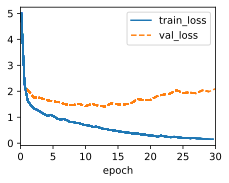

In [ ]:
import sys
import torch.nn as nn
import torch
import warnings
from sklearn.model_selection import ParameterGrid
sys.path.append('/home/jovyan/work/d2l_solutions/notebooks/exercises/d2l_utils/')
from d2l import torch as d2l
from torchsummary import summary
warnings.filterwarnings("ignore")

# class LSTM(d2l.RNN):
#     def __init__(self, num_inputs, num_hiddens, num_layers,
#                  dropout=0):
#         d2l.Module.__init__(self)
#         self.save_hyperparameters()
#         self.rnn = nn.LSTM(num_inputs, num_hiddens)

#     def forward(self, inputs, H_C=None):
#         return self.rnn(inputs, H_C)

class AttentionDecoder(d2l.Decoder):
    """The base attention-based decoder interface."""
    def __init__(self):
        super().__init__()

    @property
    def attention_weights(self):
        raise NotImplementedError

class Seq2SeqAttentionLSTMDecoder(AttentionDecoder):
    def __init__(self, vocab_size, embed_size, num_hiddens, num_layers,
                 dropout=0):
        super().__init__()
        self.attention = d2l.AdditiveAttention(num_hiddens, dropout)
        self.embedding = nn.Embedding(vocab_size, embed_size)
        self.rnn = nn.LSTM(
            embed_size + num_hiddens, num_hiddens, num_layers=num_layers,
            dropout=dropout)
        # self.rnn = nn.GRU(
        #     embed_size + num_hiddens, num_hiddens, num_layers,
        #     dropout=dropout)
        self.dense = nn.LazyLinear(vocab_size)
        self.apply(d2l.init_seq2seq)

    def init_state(self, enc_outputs, enc_valid_lens):
        # Shape of outputs: (num_steps, batch_size, num_hiddens).
        # Shape of hidden_state: (num_layers, batch_size, num_hiddens)
        outputs, hidden_state = enc_outputs
        return (outputs.permute(1, 0, 2), hidden_state, enc_valid_lens)

    def forward(self, X, state):
        # Shape of enc_outputs: (batch_size, num_steps, num_hiddens).
        # Shape of hidden_state: (num_layers, batch_size, num_hiddens)
        enc_outputs, hidden_state, enc_valid_lens = state
        hidden_state=(hidden_state,hidden_state) # do LSTM có 2 hidden_state một cái cell trí nhớ dài hạn và hidden state trí nhớ ngắn hạn
        # enc_valid_lens = None
        # Shape of the output X: (num_steps, batch_size, embed_size)
        X = self.embedding(X).permute(1, 0, 2)
        outputs, self._attention_weights = [], []
        for x in X:
            # Shape of query: (batch_size, 1, num_hiddens)
            # query = torch.unsqueeze(hidden_state[-1], dim=1)
            query = torch.unsqueeze(hidden_state[0][-1], dim=1) # sử dụng trí nhớ ngắn hạn tức ht-1
            # Shape of context: (batch_size, 1, num_hiddens)
            context = self.attention(
                query, enc_outputs, enc_outputs, enc_valid_lens)
            # Concatenate on the feature dimension
            x = torch.cat((context, torch.unsqueeze(x, dim=1)), dim=-1)
            # Reshape x as (1, batch_size, embed_size + num_hiddens)
            # out, hidden_state = self.rnn(x.permute(1, 0, 2), hidden_state)
            out, hidden_state = self.rnn(x.permute(1, 0, 2), hidden_state)
            outputs.append(out)
            self._attention_weights.append(self.attention.attention_weights)
        # After fully connected layer transformation, shape of outputs:
        # (num_steps, batch_size, vocab_size)
        outputs = self.dense(torch.cat(outputs, dim=0))
        return outputs.permute(1, 0, 2), [enc_outputs, hidden_state,
                                          enc_valid_lens]

    @property
    def attention_weights(self):
        return self._attention_weights
data = d2l.MTFraEng(batch_size=128)
embed_size, num_hiddens, num_layers, dropout = 256, 256, 2, 0.2
encoder = d2l.Seq2SeqEncoder(
    len(data.src_vocab), embed_size, num_hiddens, num_layers, dropout)
decoder = Seq2SeqAttentionLSTMDecoder(
    len(data.tgt_vocab), embed_size, num_hiddens, num_layers, dropout)
model = d2l.Seq2Seq(encoder, decoder, tgt_pad=data.tgt_vocab['<pad>'],
                    lr=0.005)
trainer = d2l.Trainer(max_epochs=30, gradient_clip_val=1)
trainer.fit(model, data)

In [ ]:
vocab_size, embed_size, num_hiddens, num_layers = 10, 8, 16, 2
# Thiết lập kích thước từ vựng (vocab_size), kích thước nhúng (embed_size), số lượng ẩn (num_hiddens) và số lớp (num_layers).

batch_size, num_steps = 4, 7 # 4 câu và 7 từ
# Thiết lập kích thước batch (batch_size) và số bước thời gian (num_steps) tức là  chiều dài của chuỗi (sequence).

encoder = d2l.Seq2SeqEncoder(vocab_size, embed_size, num_hiddens, num_layers)
# Khởi tạo encoder sử dụng Seq2SeqEncoder của thư viện 'd2l' với các tham số vừa thiết lập.
# Encoder sẽ mã hóa đầu vào thành các vector trạng thái ẩn.

decoder = Seq2SeqAttentionDecoder(vocab_size, embed_size, num_hiddens, num_layers)
# Khởi tạo decoder với attention, sử dụng lớp Seq2SeqAttentionDecoder đã được định nghĩa trước đó.

X = torch.zeros((batch_size, num_steps), dtype=torch.long)
# Tạo tensor đầu vào X với kích thước (batch_size, num_steps), giá trị mặc định là 0 và kiểu dữ liệu long (mã số của từ).
# Đây là giả lập cho đầu vào của mô hình (sequence input).

state = decoder.init_state(encoder(X), None)
# Khởi tạo trạng thái ban đầu cho decoder bằng cách sử dụng đầu ra từ encoder.
# Hàm encoder(X) mã hóa chuỗi X, sau đó init_state được gọi để lấy ra trạng thái ban đầu cần thiết cho decoder.
# Biến state bao gồm các trạng thái ẩn của decoder.

output, state = decoder(X, state)
# Chạy forward pass của decoder với chuỗi đầu vào X và trạng thái state.
# Decoder dự đoán đầu ra dựa trên đầu vào X và trạng thái từ encoder.
# 'output' chứa đầu ra của decoder cho mỗi bước thời gian, còn 'state' chứa trạng thái cuối cùng của decoder.

d2l.check_shape(output, (batch_size, num_steps, vocab_size))
# Kiểm tra hình dạng của 'output', dự kiến sẽ có kích thước (batch_size, num_steps, vocab_size).
# Mỗi từ ở mỗi bước thời gian được dự đoán là một phân phối xác suất trên toàn bộ từ vựng.

d2l.check_shape(state[0], (batch_size, num_steps, num_hiddens))
# Kiểm tra hình dạng của trạng thái đầu ra state[0], dự kiến là (batch_size, num_steps, num_hiddens).
# Đây là các trạng thái ẩn từ attention context (các output của encoder).

d2l.check_shape(state[1][0], (batch_size, num_hiddens))
# Kiểm tra hình dạng của hidden state của decoder, dự kiến là (batch_size, num_hiddens).
# Đây là trạng thái ẩn cuối cùng của decoder sau khi dự đoán các bước thời gian.


In [ ]:
vocab_size, embed_size, num_hiddens, num_layers = 10, 8, 16, 2
batch_size, num_steps = 4, 7
encoder = d2l.Seq2SeqEncoder(vocab_size, embed_size, num_hiddens, num_layers)
decoder = Seq2SeqAttentionDecoder(vocab_size, embed_size, num_hiddens, num_layers)

X = torch.zeros((batch_size, num_steps), dtype=torch.long)
state = decoder.init_state(encoder(X), None)
output, sate = decoder(X, state)
d2l.check_shape(output, (batch_size, num_steps, vocab_size))
d2l.check_shape(state[0], (batch_size, num_steps, num_hiddens))
d2l.check_shape(state[1][0], (batch_size, num_hiddens))

In [ ]:
print(d2l.check_shape(output, (batch_size, num_steps, vocab_size)),
d2l.check_shape(state[0], (batch_size, num_steps, num_hiddens)),
d2l.check_shape(state[1][0], (batch_size, num_hiddens)))

None None None


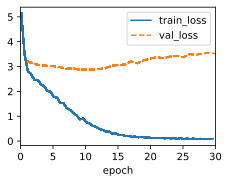

In [ ]:
data = MTVieEng(batch_size=128)
embed_size, num_hiddens, num_layers, dropout = 256, 256, 2, 0.2
encoder = d2l.Seq2SeqEncoder(
    len(data.src_vocab), embed_size, num_hiddens, num_layers, dropout)
decoder = Seq2SeqAttentionDecoder(
    len(data.tgt_vocab), embed_size, num_hiddens, num_layers, dropout)
model = d2l.Seq2Seq(encoder, decoder, tgt_pad=data.tgt_vocab['<pad>'],
                    lr=0.005)
trainer = d2l.Trainer(max_epochs=30, gradient_clip_val=1, num_gpus=1)
trainer.fit(model, data)

In [ ]:
engs = ['go .', 'i lost .', 'I agree .', 'Help me !']
fras = ['Chạy !', 'tôi mất đồ .', 'Tôi cũng nghĩ như vậy .', 'Cứu tôi với !']
preds, _ = model.predict_step(
    data.build(engs, fras), d2l.try_gpu(), data.num_steps)
for en, fr, p in zip(engs, fras, preds):
    translation = []
    for token in data.tgt_vocab.to_tokens(p):
        if token == '<eos>':
            break
        translation.append(token)
    print(f'{en} => {translation}, bleu,'
          f'{d2l.bleu(" ".join(translation), fr, k=2):.3f}')

['go .\tChạy !', 'i lost .\ttôi mất đồ .', 'I agree .\tTôi cũng nghĩ như vậy .', 'Help me !\tCứu tôi với !']
go . => ['tiếp', 'tục', 'đi', '.'], bleu,0.000
i lost . => ['tôi', 'đã', 'cười', '.'], bleu,0.000
I agree . => ['tôi', 'cũng', 'nghĩ', 'như', 'vậy', '.'], bleu,0.863
Help me ! => ['cứu', 'tôi', 'với', '!'], bleu,0.783


['Help me !\tCứu tôi với !']


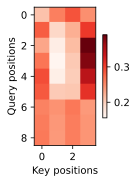

In [ ]:
_, dec_attention_weights = model.predict_step(
    data.build([engs[-1]], [fras[-1]]), d2l.try_gpu(), data.num_steps, True)
attention_weights = torch.cat(
    [step[0][0][0] for step in dec_attention_weights], 0)
attention_weights = attention_weights.reshape((1, 1, -1, data.num_steps))

# Plus one to include the end-of-sequence token
d2l.show_heatmaps(
    attention_weights[:, :, :, :len(engs[-1].split()) + 1].cpu(),
    xlabel='Key positions', ylabel='Query positions')

Hãy hình dung trọng số chú ý khi dịch câu tiếng Anh cuối cùng. Chúng tôi thấy rằng mỗi truy vấn gán trọng số không đồng nhất cho các cặp khóa-giá trị. Nó cho thấy rằng ở mỗi bước giải mã, các phần khác nhau của chuỗi đầu vào được tổng hợp có chọn lọc trong nhóm chú ý.

Khi dự đoán mã thông báo, nếu không phải tất cả mã thông báo đầu vào đều có liên quan thì bộ mã hóa-giải mã RNN với cơ chế chú ý Bahdanau sẽ tổng hợp có chọn lọc các phần khác nhau của chuỗi đầu vào. Điều này đạt được bằng cách coi trạng thái (biến ngữ cảnh) là đầu ra của quá trình tổng hợp sự chú ý bổ sung. Trong bộ mã hóa-giải mã RNN, cơ chế chú ý Bahdanau coi trạng thái ẩn của bộ giải mã ở bước thời gian trước đó là truy vấn tức là St'-1 và trạng thái ẩn của bộ mã hóa ở tất cả các bước thời gian là cả khóa và giá trị tức ht trong hình 11.4.2.

2. Replace the additive attention scoring function with the scaled dot-product

In [ ]:
import math

def masked_softmax(X, valid_lens):
    """Perform softmax operation by masking elements on the last axis."""
    # X: 3D tensor, valid_lens: 1D or 2D tensor
    def _sequence_mask(X, valid_len, value=0):
        maxlen = X.size(1)
        mask = torch.arange((maxlen), dtype=torch.float32,
                            device=X.device)[None, :] < valid_len[:, None]
        X[~mask] = value
        return X

    if valid_lens is None:
        return nn.functional.softmax(X, dim=-1)
    else:
        shape = X.shape
        if valid_lens.dim() == 1:
            valid_lens = torch.repeat_interleave(valid_lens, shape[1])
        else:
            valid_lens = valid_lens.reshape(-1)
        # On the last axis, replace masked elements with a very large negative
        # value, whose exponentiation outputs 0
        X = _sequence_mask(X.reshape(-1, shape[-1]), valid_lens, value=-1e6)
        return nn.functional.softmax(X.reshape(shape), dim=-1)

class DotProductAttention(nn.Module):
    """Scaled dot product attention."""
    def __init__(self, dropout):
        super().__init__()
        self.dropout = nn.Dropout(dropout)

    # Shape of queries: (batch_size, no. of queries, d)
    # Shape of keys: (batch_size, no. of key-value pairs, d)
    # Shape of values: (batch_size, no. of key-value pairs, value dimension)
    # Shape of valid_lens: (batch_size,) or (batch_size, no. of queries)
    def forward(self, queries, keys, values, valid_lens=None):
        d = queries.shape[-1]
        # Swap the last two dimensions of keys with keys.transpose(1, 2)
        scores = torch.bmm(queries, keys.transpose(1, 2)) / math.sqrt(d)
        self.attention_weights = masked_softmax(scores, valid_lens)
        return torch.bmm(self.dropout(self.attention_weights), values)

In [ ]:
class Seq2SeqAttentionDecoder(AttentionDecoder):
  def __init__(self, vocab_size, embed_size, num_hiddens, num_layers, dropout=0):
    super().__init__() # goi phuong thuc __init__ cua lop cha
    self.attention = d2l.DotProductAttention( dropout) # khoi attention
    self.embedding = nn.Embedding(vocab_size, embed_size)  # khoi tao embedding voiw dau vao la number vocab
    # self.rnn = nn.LSTM( # dau vao la embed va numhiddens
    #     embed_size + num_hiddens, num_hiddens, num_layers, dropout=dropout
    # )
    self.rnn = nn.LSTM(
    embed_size + num_hiddens, num_hiddens, num_layers=num_layers,
    dropout=dropout)
    self.dense = nn.LazyLinear(vocab_size)
    self.apply(d2l.init_seq2seq)

  def init_state(self, enc_outputs, enc_valid_lens):
    outputs, hidden_state = enc_outputs
    return (outputs.permute(1, 0, 2), hidden_state, enc_valid_lens) # sẽ thay đổi thứ tự của các chiều từ (batch_size, seq_len, hidden_size) thành (seq_len, batch_size, hidden_size).

  def forward(self, X, state):
        # Shape of enc_outputs: (batch_size, num_steps, num_hiddens).
        # Shape of hidden_state: (num_layers, batch_size, num_hiddens)
      enc_outputs, hidden_state, enc_valid_lens = state
      hidden_state=(hidden_state,hidden_state)
        # Shape of the output X: (num_steps, batch_size, embed_size)
      X = self.embedding(X).permute(1, 0, 2)
      outputs, self._attention_weights = [], []
      for x in X:
        # Shape of query: (batch_size, 1, num_hiddens)
        # query = torch.unsqueeze(hidden_state[-1], dim=1)
        query = torch.unsqueeze(hidden_state[0][-1], dim=1)
        # Shape of context: (batch_size, 1, num_hiddens)
        context = self.attention(
            query, enc_outputs, enc_outputs, enc_valid_lens
        )
        # Concatenate on the feature dimension
        x = torch.cat((context, torch.unsqueeze(x, dim=1)), dim=-1)
        # Reshape x as (1, batch_size, embed_size + num_hiddens)
        # out, hidden_state = self.rnn(x.permute(1, 0, 2), hidden_state)
        out, hidden_state = self.rnn(x.permute(1, 0, 2), hidden_state)
        outputs.append(out)
        self._attention_weights.append(self.attention.attention_weights)
      outputs = self.dense(torch.cat(outputs, dim=0))
      return outputs.permute(1, 0, 2), [enc_outputs, hidden_state, enc_valid_lens]
  @property
  def attention_weights(self):
    return self._attention_weights
vocab_size, embed_size, num_hiddens, num_layers = 10, 8, 16, 2
batch_size, num_steps = 4, 7
encoder = d2l.Seq2SeqEncoder(vocab_size, embed_size, num_hiddens, num_layers)
decoder = Seq2SeqAttentionDecoder(vocab_size, embed_size, num_hiddens, num_layers)



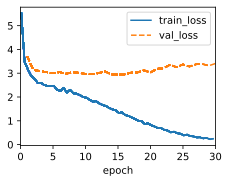

In [ ]:
data = MTVieEng(batch_size=128)
embed_size, num_hiddens, num_layers, dropout = 256, 256, 2, 0.2
encoder = d2l.Seq2SeqEncoder(
    len(data.src_vocab), embed_size, num_hiddens, num_layers, dropout)
decoder = Seq2SeqAttentionDecoder(
    len(data.tgt_vocab), embed_size, num_hiddens, num_layers, dropout)
model = d2l.Seq2Seq(encoder, decoder, tgt_pad=data.tgt_vocab['<pad>'],
                    lr=0.005)
trainer = d2l.Trainer(max_epochs=30, gradient_clip_val=1, num_gpus=1)
trainer.fit(model, data)

# Multi-Head Attention


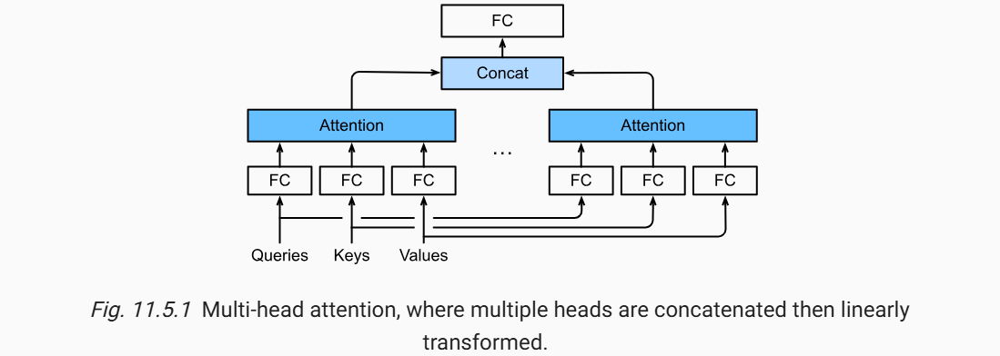

In [ ]:
!pip install d2l

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.9/58.9 kB 1.3 MB/s eta 0:00:00
  Using cached jedi-0.19.1-py2.py3-none-any.whl.metadata (22 kB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 111.7/111.7 kB 2.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.6/11.6 MB 36.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.1/17.1 MB 22.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.3/12.3 MB 17.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.6/62.6 kB 2.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 34.4/34.4 MB 15.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 98.3/98.3 kB 4.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 124.7/124.7 kB 7.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 93.5/93.5 kB 5.2 MB/s eta 0:00:00
Using cached jedi-0.19.1-py2.py3-none-any.whl (1.6 MB)
  Attempting uninstall: requests
    Found existing installation: requests 2.32.3
    Unin

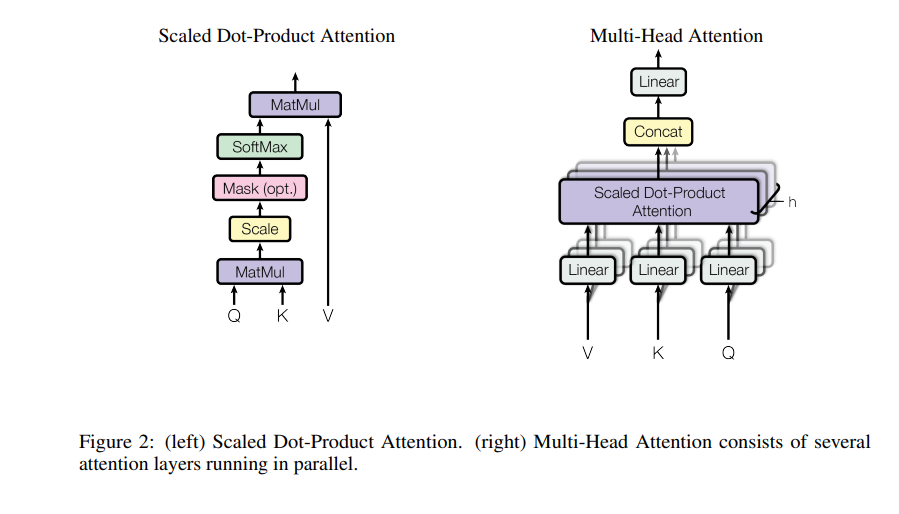

In [ ]:
import math
import torch
from torch import nn
from d2l import torch as d2l

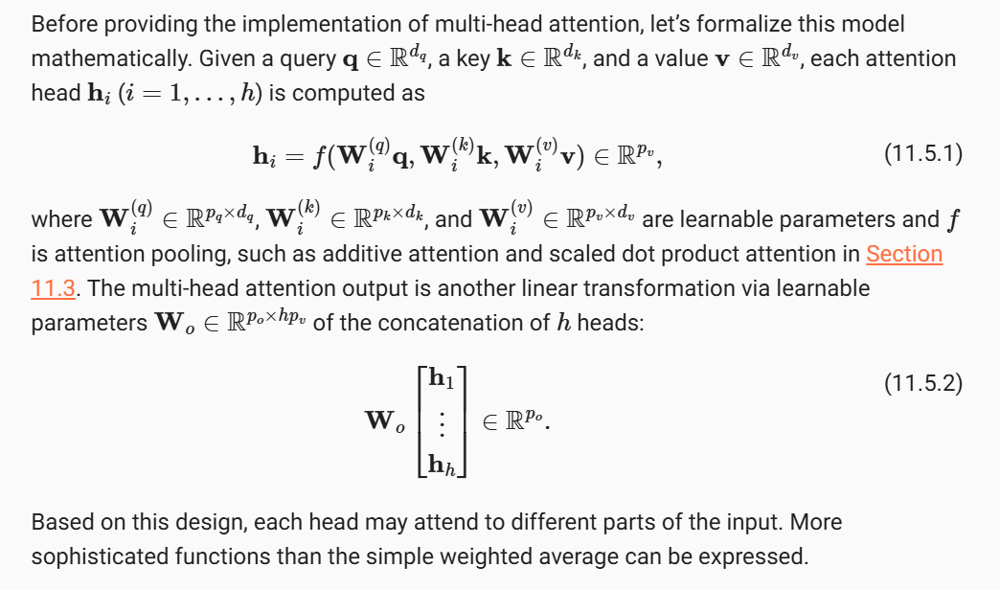

Trong quá trình triển khai, chúng tôi chọn the scaled dot product attention theo tỷ lệ chú ý cho mỗi đầu của multi-head attention. Để tránh sự gia tăng đáng kể về chi phí tính toán và chi phí tham số hóa, chúng tôi đặt 𝑝 𝑞 = 𝑝 𝑘 = 𝑝 𝑣 = 𝑝 𝑜 / ℎ . Lưu ý rằng ℎ đầu có thể được tính song song nếu chúng ta đặt số đầu ra của các phép biến đổi tuyến tính cho truy vấn, khóa và giá trị thành 𝑝 𝑞 ℎ = 𝑝 𝑘 ℎ = 𝑝 𝑣 ℎ = 𝑝 𝑜 . Trong cách triển khai sau, 𝑝 𝑜 được chỉ định thông qua đối số

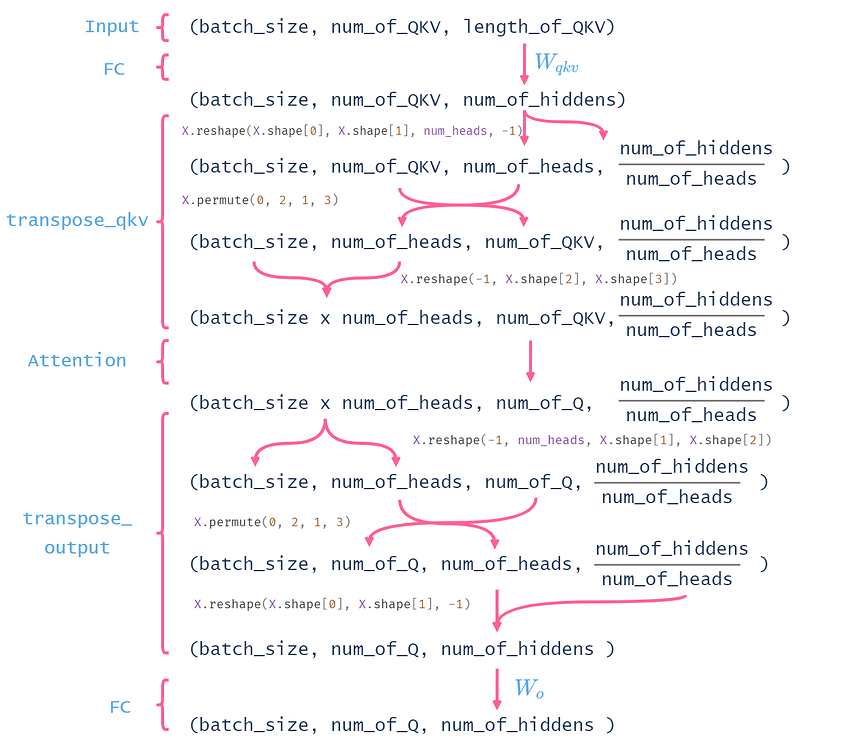

In [ ]:
class MultiHeadAttention(d2l.Module):
    """Multi-head attention."""
    def __init__(self, num_hiddens, num_heads, dropout, bias=False, **kwargs):
        super().__init__()
        self.num_heads = num_heads
        self.attention = d2l.DotProductAttention(dropout)
        self.W_q = nn.LazyLinear(num_hiddens, bias=bias)  # Tạo linear layer cho queries
        self.W_k = nn.LazyLinear(num_hiddens, bias=bias)  # Tạo linear layer cho keys
        self.W_v = nn.LazyLinear(num_hiddens, bias=bias)  # Tạo linear layer cho values
        self.W_o = nn.LazyLinear(num_hiddens, bias=bias)  # Tạo linear layer cho output
        self.head_attention = nn.Parameter(torch.rand(1, num_heads, 1, 1))  # Parameter cho attention head

    def forward(self, queries, keys, values, valid_lens):
        # queries, keys, values có shape [batch_size, num_queries, num_hiddens]
        # num_hiddens là tổng số hidden units cho tất cả các head

        # Transpose các query, key và value để phù hợp với số lượng head
        queries = self.transpose_qkv(self.W_q(queries))
        # Shape của queries sau transpose: [batch_size * num_heads, num_queries, num_hiddens_per_head]
        keys = self.transpose_qkv(self.W_k(keys))
        # Shape của keys sau transpose: [batch_size * num_heads, num_key_value_pairs, num_hiddens_per_head]
        values = self.transpose_qkv(self.W_v(values))
        # Shape của values sau transpose: [batch_size * num_heads, num_key_value_pairs, num_hiddens_per_head]

        # Lặp lại valid_lens cho mỗi head nếu có
        if valid_lens is not None:
            valid_lens = torch.repeat_interleave(valid_lens, repeats=self.num_heads, dim=0)
            # valid_lens shape sau repeat: [batch_size * num_heads]

        # Tính toán attention
        output = self.attention(queries, keys, values, valid_lens)
        # Shape của output: [batch_size * num_heads, num_queries, num_hiddens_per_head]

        # Reshape output để phù hợp với num_heads
        output_attention = output.reshape(-1, self.num_heads, output.shape[1], output.shape[2])
        # Shape của output_attention: [batch_size, num_heads, num_queries, num_hiddens_per_head]

        # Softmax trên self.head_attention
        mm = nn.Softmax(dim=1)
        self.head_attention_trans = mm(self.head_attention)  # Shape: [1, num_heads, 1, 1]

        # Thực hiện phép nhân broadcast giữa output_attention và head_attention_trans
        output_attention = output_attention * self.head_attention_trans
        # Shape của output_attention: [batch_size, num_heads, num_queries, num_hiddens_per_head]
        # Broadcasting: self.head_attention_trans được broadcast để match với kích thước của output_attention

        # Tổng hợp các head lại với nhau
        output_attention = output_attention.sum(dim=1)
        # Shape của output_attention sau khi sum: [batch_size, num_queries, num_hiddens_per_head]
        # Tổng hợp giá trị từ các head lại (gộp tất cả các head thành một)

        # Trả về kết quả sau khi áp dụng linear layer cuối cùng
        return self.W_o(output_attention)
        # Shape của output: [batch_size, num_queries, num_hiddens]
        # W_o điều chỉnh số lượng hidden units thành num_hiddens tổng thể

# set up for  computed in parallel
@d2l.add_to_class(MultiHeadAttention)
def transpose_qkv(self, X):
    """
    Transpose the input tensor for parallel computation of multiple attention heads.

    Parameters:
    X: Input tensor with shape (batch_size, num_queries or key-value pairs, num_hiddens).

    Returns:
    Transposed tensor with shape (batch_size * num_heads, num_queries or key-value pairs, num_hiddens / num_heads),
    ready for parallel computation in the multi-head attention mechanism.
    """

    # Step 1: Reshape input X for multi-head attention.
    # From (batch_size, num_queries or key-value pairs, num_hiddens)
    # To (batch_size, num_queries or key-value pairs, num_heads, num_hiddens / num_heads)
    # -1 = numhiddens/num_heads
    X = X.reshape(X.shape[0], X.shape[1], self.num_heads, -1)

    # Step 2: Permute the dimensions to bring num_heads to the second position.
    # From (batch_size, num_queries or key-value pairs, num_heads, num_hiddens / num_heads)
    # To (batch_size, num_heads, num_queries or key-value pairs, num_hiddens / num_heads)
    X = X.permute(0, 2, 1, 3)

    # Step 3: Reshape again to combine batch_size and num_heads for efficient parallel computation.
    # From (batch_size, num_heads, num_queries or key-value pairs, num_hiddens / num_heads)
    # To (batch_size * num_heads, num_queries or key-value pairs, num_hiddens / num_heads)
    # vậy ở chiều đầu sẽ là nhân và ở chiều cuối nó sẽ là /
    return X.reshape(-1, X.shape[2], X.shape[3])

# Reverse, vi layer output không sử dụng tính toán song song
@d2l.add_to_class(MultiHeadAttention)
def transpose_output(self, X):
    """
    Reverse the operation of transpose_qkv to restore the original shape of the output tensor.

    Parameters:
    X: Input tensor with shape (batch_size * num_heads, num_queries or key-value pairs, num_hiddens / num_heads).

    Returns:
    Transposed tensor with shape (batch_size, num_queries or key-value pairs, num_hiddens),
    matching the shape before multi-head attention was applied.
    """

    # Step 1: Reshape X to separate batch_size and num_heads.
    # From (batch_size * num_heads, num_queries or key-value pairs, num_hiddens / num_heads)
    # To (batch_size, num_heads, num_queries or key-value pairs, num_hiddens / num_heads)
    X = X.reshape(-1, self.num_heads, X.shape[1], X.shape[2])

    # Step 2: Permute the dimensions to bring num_heads back to the third position.
    # From (batch_size, num_heads, num_queries or key-value pairs, num_hiddens / num_heads)
    # To (batch_size, num_queries or key-value pairs, num_heads, num_hiddens / num_heads)
    X = X.permute(0, 2, 1, 3)

    # Step 3: Reshape to collapse num_heads and num_hiddens / num_heads into num_hiddens.
    # From (batch_size, num_queries or key-value pairs, num_heads, num_hiddens / num_heads)
    # To (batch_size, num_queries or key-value pairs, num_hiddens)
    return X.reshape(X.shape[0], X.shape[1], -1)


In [ ]:
class Seq2SeqAttentionDecoder(d2l.Module):
    def __init__(self, vocab_size, embed_size, num_hiddens, num_layers,
                 dropout=0, num_heads = 8,**kwargs): # Added num_heads with a default value
        super().__init__() # Call super().__init__() without arguments
        self.attention = MultiHeadAttention(num_hiddens, num_heads, dropout) # Pass num_heads to MultiHeadAttention
        self.embedding = nn.Embedding(vocab_size, embed_size)
        self.rnn = nn.GRU(
            embed_size + num_hiddens, num_hiddens, num_layers,
            dropout=dropout)
        self.dense = nn.LazyLinear(vocab_size)
        self.apply(d2l.init_seq2seq)
        self._attention_weights = [] # Initialize _attention_weights here

    def init_state(self, enc_outputs, enc_valid_lens):
        # Shape of outputs: (num_steps, batch_size, num_hiddens).
        # Shape of hidden_state: (num_layers, batch_size, num_hiddens)
        outputs, hidden_state = enc_outputs
        return (outputs.permute(1, 0, 2), hidden_state, enc_valid_lens)

    def forward(self, X, state):
        # Shape of enc_outputs: (batch_size, num_steps, num_hiddens).
        # Shape of hidden_state: (num_layers, batch_size, num_hiddens)
        enc_outputs, hidden_state, enc_valid_lens = state
        # Shape of the output X: (num_steps, batch_size, embed_size)
        X = self.embedding(X).permute(1, 0, 2)
        outputs, self._attention_weights = [], [] # Initialize _attention_weights here
        for x in X:
            # Shape of query: (batch_size, 1, num_hiddens)
            query = torch.unsqueeze(hidden_state[-1], dim=1)
            # Shape of context: (batch_size, 1, num_hiddens)
            context = self.attention(
                query, enc_outputs, enc_outputs, enc_valid_lens)
            # Concatenate on the feature dimension
            x = torch.cat((context, torch.unsqueeze(x, dim=1)), dim=-1)
            # Reshape x as (1, batch_size, embed_size + num_hiddens)
            out, hidden_state = self.rnn(x.permute(1, 0, 2), hidden_state)
            outputs.append(out)
            # Access attention weights from the attention object
            self._attention_weights.append(self.attention.head_attention_trans)
        # After fully connected layer transformation, shape of outputs:
        # (num_steps, batch_size, vocab_size)
        outputs = self.dense(torch.cat(outputs, dim=0))
        return outputs.permute(1, 0, 2), [enc_outputs, hidden_state,
                                          enc_valid_lens]

    @property
    def attention_weights(self):
        return self._attention_weights

KeyboardInterrupt: 

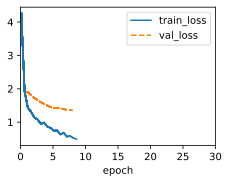

In [ ]:
data = d2l.MTFraEng(batch_size=128)
embed_size, num_hiddens, num_layers, dropout = 256, 256, 2, 0.2
encoder = d2l.Seq2SeqEncoder(
    len(data.src_vocab), embed_size, num_hiddens, num_layers, dropout)
decoder = Seq2SeqAttentionDecoder(
    len(data.tgt_vocab), embed_size, num_hiddens, num_layers, dropout)

model = d2l.Seq2Seq(encoder, decoder, tgt_pad=data.tgt_vocab['<pad>'],
                    lr=0.005)
trainer = d2l.Trainer(max_epochs=30, gradient_clip_val=1, num_gpus=1)
trainer.fit(model, data)

Giả sử rằng chúng ta có một mô hình được đào tạo dựa trên sự chú ý của nhiều đầu và chúng ta muốn cắt bớt các đầu chú ý ít quan trọng hơn để tăng tốc độ dự đoán. Làm thế nào chúng ta có thể thiết kế các thí nghiệm để đo lường tầm quan trọng của khả năng chú ý?

In [ ]:
model.decoder.attention.output_attention.shape

AttributeError: 'MultiHeadAttention' object has no attribute 'output_attention'

In [ ]:
model.decoder.attention.head_attention_trans.shape

torch.Size([1, 8, 1, 1])

torch.Size([1, 4, 10])


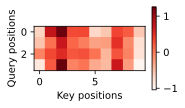

In [ ]:
num_hiddens, num_heads = 10, 5
attention = MultiHeadAttention(num_hiddens, num_heads, 0.5)
batch_size, num_queries, num_kvpairs = 1, 4, 6
valid_lens = torch.tensor([3,])
X = torch.ones((batch_size, num_queries, num_hiddens))
Y = torch.ones((batch_size, num_kvpairs, num_hiddens))
atten = attention(X, Y, Y, valid_lens)
print(atten.shape)
#Trước khi unsqueeze(0): Kích thước tensor là [A, B].
# Sau khi unsqueeze(0): Kích thước tensor sẽ là [1, A, B], thêm một chiều batch.
print(atten.unsqueeze(0).shape)
d2l.show_heatmaps(
    atten.unsqueeze(0).cpu(),
    xlabel='Key positions', ylabel='Query positions')

In [ ]:
print(atten.unsqueeze(0).shape)


torch.Size([1, 1, 4, 10])


torch.Size([5, 4, 6])


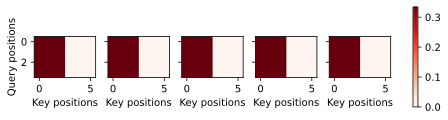

In [ ]:
print(attention.attention.attention_weights.shape)
d2l.show_heatmaps(
    attention.attention.attention_weights.unsqueeze(0).cpu(),
    xlabel='Key positions', ylabel='Query positions',figsize=(8, 3))

Exercises

1. Visualize attention weights of multiple heads in this experiment.

2. Suppose that we have a trained model based on multi-head attention and we want to prune less important attention heads to increase the prediction speed. How can we design experiments to measure the importance of an attention head?

Hình dung mức độ chú ý của nhiều cái đầu trong thí nghiệm này.

Giả sử rằng chúng ta có một mô hình được đào tạo dựa trên sự chú ý của nhiều đầu và chúng ta muốn cắt bớt các đầu chú ý ít quan trọng hơn để tăng tốc độ dự đoán. Làm thế nào chúng ta có thể thiết kế các thí nghiệm để đo lường tầm quan trọng của khả năng chú ý?

# Self-Attention and Positional Encoding

## Self- Attention

Self-attention, đôi khi còn được gọi là intra-attention, là một cơ chế attention liên kết các vị trí khác nhau của một chuỗi đơn để tính toán một biểu diễn của chuỗi đó. Self-attention đã được sử dụng thành công trong nhiều nhiệm vụ khác nhau bao gồm đọc hiểu, tóm tắt rút gọn, suy diễn văn bản và học các biểu diễn câu không phụ thuộc vào nhiệm vụ

Nội dung trong hình bao gồm các phần sau:

**Self-Attention**
Cho một chuỗi các token đầu vào \( \mathbf{x}_1, \dots, \mathbf{x}_n \) với mỗi token \( \mathbf{x}_i \in \mathbb{R}^d \), cơ chế self-attention tạo ra chuỗi đầu ra \( \mathbf{y}_1, \dots, \mathbf{y}_n \), trong đó:

\[
\mathbf{y}_i = f(\mathbf{x}_i, (\mathbf{x}_1, \mathbf{x}_1), \dots, (\mathbf{x}_n, \mathbf{x}_n)) \in \mathbb{R}^d
\]

Sử dụng attention pooling được định nghĩa trong mục (11.1.1), đoạn mã sau tính toán self-attention của tensor có dạng \( \text{batch size}, \text{number of time steps}, \text{d} \). Output tensor có cùng hình dạng.

**So sánh CNNs, RNNs, và Self-Attention**
Phần này so sánh các kiến trúc CNNs, RNNs, và Self-Attention trong việc ánh xạ chuỗi các token \(n\) thành một chuỗi khác với chiều dài bằng nhau, với mỗi token đầu vào và đầu ra được đại diện bởi một vector d chiều. Nó nêu ra các đặc điểm như:
- CNN xử lý các yếu tố cục bộ như n-grams.
- RNN xử lý chuỗi tuần tự, với độ phức tạp tính toán là \(O(nd^2)\).
- Self-attention có thể tính toán song song với độ phức tạp là \(O(n^2d)\).

Hình ảnh so sánh giữa ba kiến trúc CNN, RNN, và Self-attention cho thấy sự khác biệt về cách kết nối giữa các token.

**Positional Encoding**
Khác với RNN, self-attention không tự động bảo toàn thông tin về thứ tự của chuỗi token. Để khắc phục, ta thêm positional encoding như một input bổ sung. Mã hóa này có thể được học hoặc cố định trước. Phần này mô tả phương pháp sử dụng ma trận \( \mathbf{P} \) để thêm thông tin về vị trí của các token vào biểu diễn đầu vào \( \mathbf{X} \).

Công thức của positional encoding dựa trên các hàm sin và cos:

\[
P_{i,2j} = \sin \left(\frac{i}{10000^{2j/d}}\right), \quad P_{i,2j+1} = \cos \left(\frac{i}{10000^{2j/d}}\right)
\]

Cuối cùng là một đoạn mã cài đặt lớp PositionalEncoding trong PyTorch.

[link text](https:// [link text](https:// [link text](https://)))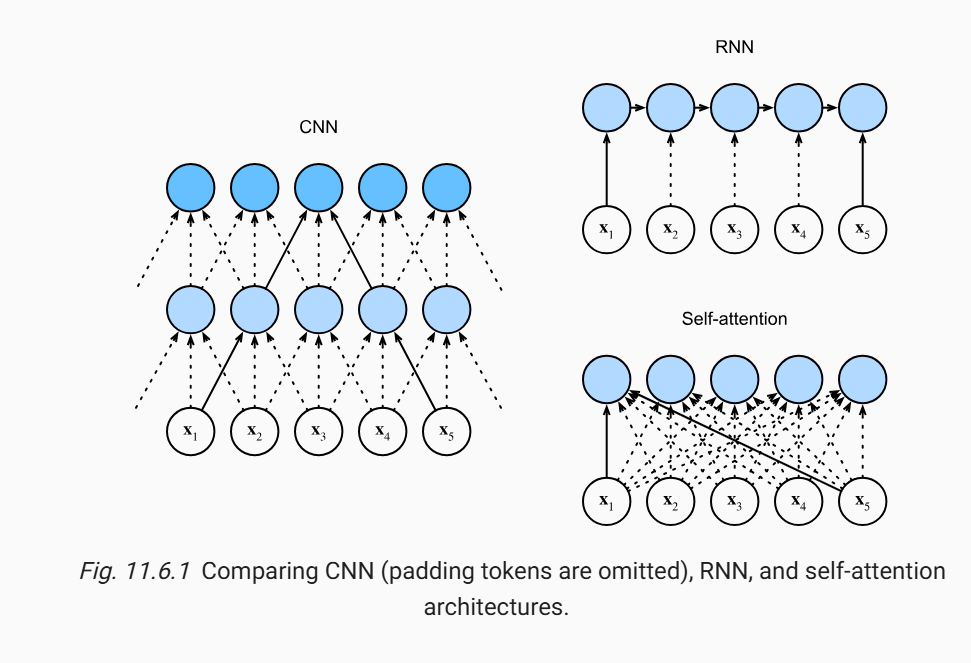

xem thêm : chttps://armanasq.github.io/nlp/self-attention/


Dịch nội dung:

Hình dung cơ chế tự chú ý như người chỉ huy dàn nhạc, điều phối sự hòa hợp của thông tin trong một nhúng đầu vào. Vai trò của nó là truyền tải sự thông thái ngữ cảnh, cho phép mô hình phân biệt tầm quan trọng của từng phần tử trong một chuỗi và điều chỉnh động mức độ ảnh hưởng của chúng lên đầu ra cuối cùng. Sự điều phối này vô cùng quý giá trong các nhiệm vụ xử lý ngôn ngữ, nơi ý nghĩa của một từ phụ thuộc vào những từ xung quanh nó trong câu hoặc văn bản.

**Bộ tứ: Q, K, V và Self-Attention**
Tại trung tâm của cơ chế tự chú ý là bộ tứ Query (Truy vấn), Key (Khóa), Value (Giá trị) và chính cơ chế Self-Attention (Tự chú ý). Những thành phần này phối hợp với nhau trong một bản hòa tấu:

- **Query (Truy vấn)**: Hãy nghĩ đến các truy vấn như những phần tử đang tìm kiếm thông tin. Đối với mỗi từ trong chuỗi đầu vào, một vector truy vấn được tính toán. Những truy vấn này đại diện cho điều mà bạn muốn chú ý trong chuỗi.
- **Key (Khóa)**: Khóa giống như các biển chỉ đường. Chúng giúp xác định và định vị các phần tử quan trọng trong chuỗi. Giống như truy vấn, các vector khóa cũng được tính toán cho mỗi từ.
- **Value (Giá trị)**: Giá trị mang thông tin. Một lần nữa, đối với mỗi từ, một vector giá trị được tính toán. Những vector này chứa nội dung mà chúng ta muốn xem xét khi xác định tầm quan trọng của các từ trong chuỗi.

**Tính toán Query, Key và Value**: Đối với mỗi từ trong chuỗi đầu vào, chúng ta tính toán các vector truy vấn, khóa và giá trị. Những vector này là nền tảng mà cơ chế chú ý vận hành.

**Điểm số chú ý**: Với bộ tứ đã chuẩn bị, các điểm số chú ý được tính toán cho mỗi cặp từ trong chuỗi. Điểm số chú ý giữa một truy vấn và một khóa định lượng sự tương thích hoặc mức độ liên quan của chúng.

**Tổng hợp có trọng số**: Cuối cùng, các điểm số chú ý được sử dụng làm trọng số để thực hiện tổng hợp có trọng số các vector giá trị. Quá trình tổng hợp này tạo ra đầu ra của cơ chế tự chú ý, đại diện cho một biểu diễn được nâng cao và có ngữ cảnh của chuỗi đầu vào.

**Bản hòa tấu của cơ chế tự chú ý**
Cơ chế tự chú ý không chỉ là một cơ chế, mà là một bản hòa tấu của các hoạt động nâng cao sự hiểu biết về chuỗi trong các mô hình học sâu. Khả năng thích ứng và khả năng nắm bắt các mối quan hệ phức tạp chính là điều khiến các mô hình NLP hiện đại, như Transformers, trở nên mạnh mẽ.


Bài báo gốc : https://arxiv.org/pdf/1703.03130`

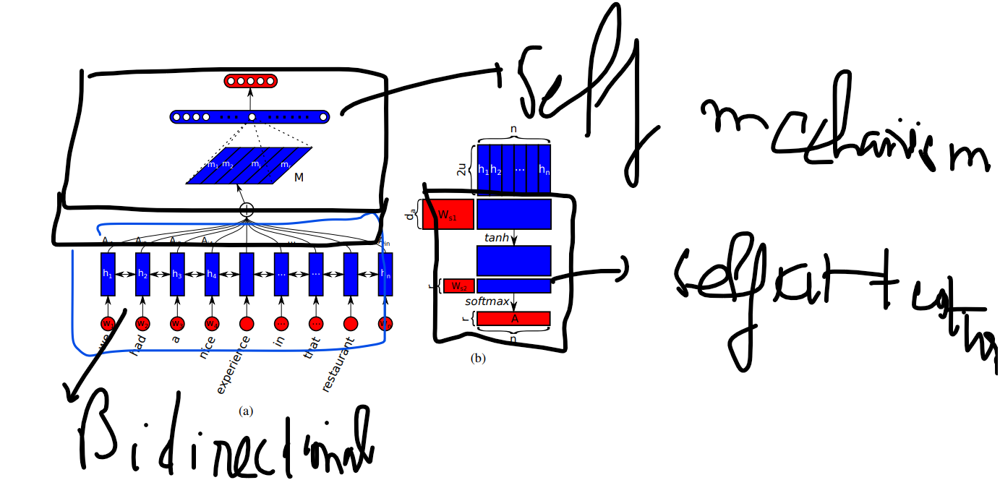

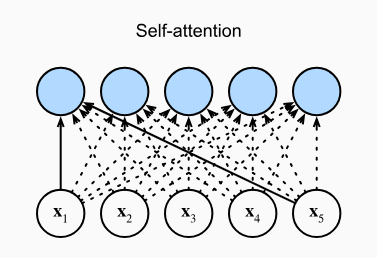

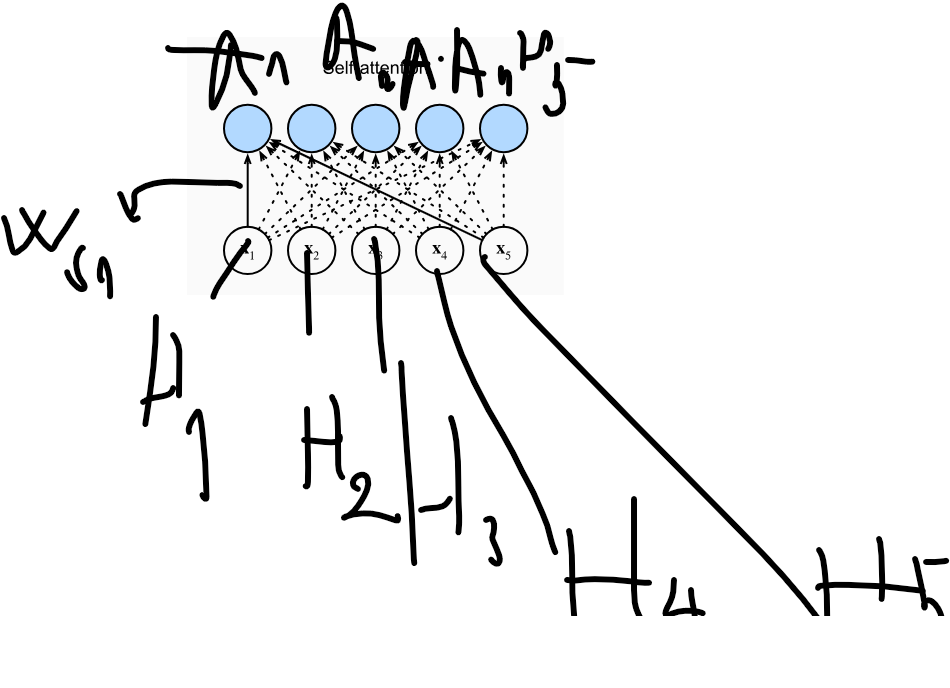

## Positional Encoding

Không giống như RNN, xử lý định kỳ từng mã thông báo của một chuỗi, tính năng tự chú ý loại bỏ các hoạt động tuần tự để chuyển sang tính toán song song. Lưu ý rằng bản thân sự chú ý không bảo toàn thứ tự của trình tự. Chúng ta phải làm gì nếu việc mô hình biết trình tự đầu vào đến theo thứ tự nào thực sự quan trọng?

Việc lưu trữ thông tin về thứ tự đặc biệt rất quan đối với việc tính toán song song, việc mã hóa vị trí cố định dựa trên hàm sin và cos được gọi là positional encoding

**Dịch nội dung:**

Vì mô hình của chúng ta không có sự lặp lại (recurrence) và không sử dụng tích chập (convolution), để mô hình có thể sử dụng được thứ tự của chuỗi, chúng ta phải thêm một số thông tin về vị trí tương đối hoặc tuyệt đối của các token trong chuỗi. Để làm điều này, chúng ta thêm "mã hóa vị trí" (positional encodings) vào các embedding đầu vào ở dưới cùng của các khối mã hóa (encoder) và giải mã (decoder). Mã hóa vị trí có cùng kích thước với embedding \(d_{\text{model}}\) để có thể cộng chúng lại với nhau. Có nhiều lựa chọn cho mã hóa vị trí, có thể là học được hoặc cố định [9].

Trong nghiên cứu này, chúng ta sử dụng các hàm sine và cosine với các tần số khác nhau:
\[
PE(\text{pos}, 2i) = \sin(\frac{\text{pos}}{10000^{2i / d_{\text{model}}}})
\]
\[
PE(\text{pos}, 2i+1) = \cos(\frac{\text{pos}}{10000^{2i / d_{\text{model}}}})
\]
trong đó \(\text{pos}\) là vị trí và \(i\) là chiều của vector. Mỗi chiều của mã hóa vị trí tương ứng với một sóng sin. Bước sóng có sự tiến triển hình học từ \(2\pi\) đến \(10000 \cdot 2\pi\). Chúng tôi đã chọn hàm này vì chúng tôi giả thuyết rằng nó sẽ giúp mô hình dễ dàng học cách chú ý đến các vị trí tương đối, bởi vì với bất kỳ độ lệch cố định \(k\), \(PE_{\text{pos}+k}\) có thể được biểu diễn như một hàm tuyến tính của \(PE_{\text{pos}}\).

Chúng tôi cũng đã thử nghiệm với việc sử dụng embedding vị trí học được [9] thay thế và nhận thấy rằng hai phiên bản cho ra kết quả gần như giống hệt nhau (xem bảng 3 hàng (E)). WHY (**Chúng tôi chọn phiên bản dạng sóng sin vì nó có thể giúp mô hình ngoại suy đến các chuỗi có độ dài lớn hơn những chuỗi gặp phải trong quá trình huấn luyện.**)

**Tóm tắt:**

Để giúp mô hình không có sự lặp lại (recurrence) và tích chập (convolution) tận dụng thứ tự của chuỗi, người ta thêm mã hóa vị trí vào các embedding đầu vào của encoder và decoder. Tác giả sử dụng hàm sine và cosine với các tần số khác nhau để tạo ra các mã hóa vị trí và nhận thấy chúng cho kết quả gần như tương tự với các embedding vị trí học được. Mã hóa vị trí dạng sóng sin được chọn vì khả năng ngoại suy với các chuỗi có độ dài lớn hơn.

Giả sử rằng biểu diễn đầu vào 𝑋 ∈ 𝑅 𝑛 × 𝑑 chứa các phần nhúng 𝑑 chiều cho 𝑛 mã thông báo của một chuỗi. Đầu ra mã hóa vị trí 𝑋 + 𝑃 sử dụng ma trận nhúng vị trí 𝑃 ∈ 𝑅 𝑛 × 𝑑 có cùng hình dạng, có phần tử trên hàng thứ 𝑖 và cột thứ ( 2 𝑗 ) hoặc cột thứ ( 2 𝑗 + 1 ) là

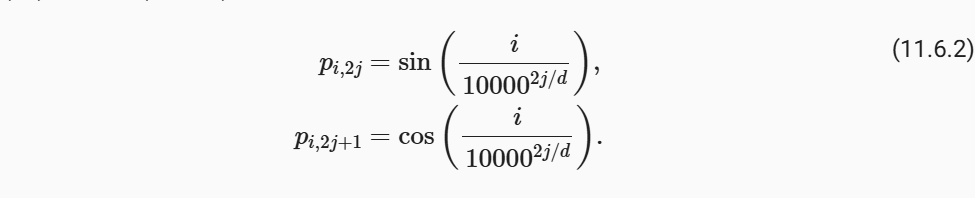

i là position, j là chiều của vector. . Mỗi chiều của mã hóa vị trí tương ứng với một sóng sin. Bước sóng có sự tiến triển hình học từ
2π đến
10000x2π


In [ ]:
!pip install d2l

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.9/58.9 kB 1.7 MB/s eta 0:00:00
  Using cached jedi-0.19.1-py2.py3-none-any.whl.metadata (22 kB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 111.7/111.7 kB 6.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.6/11.6 MB 25.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.1/17.1 MB 41.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.3/12.3 MB 52.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.6/62.6 kB 5.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 34.4/34.4 MB 12.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 98.3/98.3 kB 5.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 124.7/124.7 kB 11.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 93.5/93.5 kB 5.2 MB/s eta 0:00:00
Using cached jedi-0.19.1-py2.py3-none-any.whl (1.6 MB)
  Attempting uninstall: requests
    Found existing installation: requests 2.32.3
    Uni

sử dụng hàm sine và cosine với các tần số khác nhau để tạo ra các mã hóa vị trí và nhận thấy chúng cho kết quả gần như tương tự với các embedding vị trí học được. Mã hóa vị trí dạng sóng sin được chọn vì khả năng ngoại suy với các chuỗi có độ dài lớn hơn

In [ ]:
from d2l import torch as d2l
import math
import torch
from torch import nn

ModuleNotFoundError: No module named 'd2l'

In [ ]:
class PositionalEncoding(nn.Module):
    """Positional encoding."""
    def __init__(self, num_hiddens, dropout, max_len=1000):
        super().__init__()
        self.dropout = nn.Dropout(dropout)
        # Create a long enough P shape
        # n = max_len sequence , d = dimension = num_hiddens
        self.P = torch.zeros((1, max_len, num_hiddens))
        X = torch.arange(max_len, dtype=torch.float32).reshape(
            -1, 1) / torch.pow(10000, torch.arange(
            0, num_hiddens, 2, dtype=torch.float32) / num_hiddens)
        # i is position , j is dimension
        self.P[:, :, 0::2] = torch.sin(X) # j chan la sin
        self.P[:, :, 1::2] = torch.cos(X) # j le la cos

    def forward(self, X):
        X = X + self.P[:, :X.shape[1], :].to(X.device)
        return self.dropout(X)

NameError: name 'nn' is not defined

`
Giả sử bạn có một chuỗi gồm \( n \) tokens (num_steps) với mỗi token được biểu diễn bằng một embedding có chiều \( d \) (encoding_dim). Bạn muốn thêm thông tin vị trí (positional encoding) vào các embeddings để mô hình có thể nhận biết được vị trí tương đối của các token.

Công thức mã hóa vị trí \( P \) được xác định cho từng phần tử \( i \) (dòng thứ \( i \)) và cột thứ \( 2j \) hoặc \( 2j+1 \):

- \( p_{i, 2j} = \sin\left(\frac{i}{10000^{2j/d}}\right) \)
- \( p_{i, 2j+1} = \cos\left(\frac{i}{10000^{2j/d}}\right) \)

Trong đó:
- \( i \) là chỉ số của token (vị trí trong chuỗi).
- \( d \) là kích thước của embedding.
- \( j \) là chỉ số của thành phần trong embedding.

 Minh họa cách positional encoding hoạt động:

Giả sử bạn có một chuỗi gồm 3 tokens với kích thước embedding \( d = 4 \). Chúng ta sẽ tính positional encoding cho từng token trong chuỗi.

 Các bước tính toán positional encoding:

 Token 1 (vị trí 0):
- \( p_{0,0} = \sin\left(\frac{0}{10000^{0/4}}\right) = \sin(0) = 0 \)
- \( p_{0,1} = \cos\left(\frac{0}{10000^{0/4}}\right) = \cos(0) = 1 \)
- \( p_{0,2} = \sin\left(\frac{0}{10000^{2/4}}\right) = \sin(0) = 0 \)
- \( p_{0,3} = \cos\left(\frac{0}{10000^{2/4}}\right) = \cos(0) = 1 \)

Positional encoding cho token 1 là: \( [0, 1, 0, 1] \)

 Token 2 (vị trí 1):
- \( p_{1,0} = \sin\left(\frac{1}{10000^{0/4}}\right) = \sin(1) \approx 0.841 \)
- \( p_{1,1} = \cos\left(\frac{1}{10000^{0/4}}\right) = \cos(1) \approx 0.540 \)
- \( p_{1,2} = \sin\left(\frac{1}{10000^{2/4}}\right) \approx 0.0001 \)
- \( p_{1,3} = \cos\left(\frac{1}{10000^{2/4}}\right) \approx 1 \)

Positional encoding cho token 2 là: \( [0.841, 0.540, 0.0001, 1] \)

 Token 3 (vị trí 2):
- \( p_{2,0} = \sin\left(\frac{2}{10000^{0/4}}\right) = \sin(2) \approx 0.909 \)
- \( p_{2,1} = \cos\left(\frac{2}{10000^{0/4}}\right) = \cos(2) \approx -0.416 \)
- \( p_{2,2} = \sin\left(\frac{2}{10000^{2/4}}\right) \approx 0.0002 \)
- \( p_{2,3} = \cos\left(\frac{2}{10000^{2/4}}\right) \approx 1 \)

Positional encoding cho token 3 là: \( [0.909, -0.416, 0.0002, 1] \)

 Tổng kết:

Chuỗi positional encoding cho ba tokens có embedding kích thước \( d = 4 \) sẽ là:

\[
\begin{bmatrix}
[0, 1, 0, 1] \\
[0.841, 0.540, 0.0001, 1] \\
[0.909, -0.416, 0.0002, 1]
\end{bmatrix}
\]

Những vector này sẽ được cộng vào embeddings của các token tương ứng trước khi đưa vào mô hình.

60


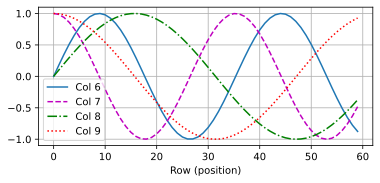

In [ ]:
encoding_dim, num_steps = 32, 60 # num_steps = chieu dai cua chuoi tuong ung (so luong tokens) vs 60 position, encoding_dim = so dim cua mot position
pos_encoding = PositionalEncoding(encoding_dim, 0)
X = pos_encoding(torch.zeros((1, num_steps, encoding_dim)))
print(X.shape[1])

P = pos_encoding.P[:, :X.shape[1], :]
d2l.plot(torch.arange(num_steps), P[0, :, 6:10].T, xlabel='Row (position)',
         figsize=(6, 2.5), legend=["Col %d" % d for d in torch.arange(6, 10)])

### Absolute Positional Information

To see how the monotonically decreased frequency along the encoding dimension relates to absolute positional information, let's print out the binary representations of 0 , 1 , … , 7 . As we can see, the lowest bit, the second-lowest bit, and the third-lowest bit alternate on every number, every two numbers, and every four numbers, respectively.

Để xem tần số giảm đơn điệu dọc theo chiều mã hóa có liên quan như thế nào đến thông tin vị trí tuyệt đối, hãy in ra các biểu diễn nhị phân của 0 , 1 , … , 7 . Như chúng ta có thể thấy, bit thấp nhất, bit thấp thứ hai và bit thấp thứ ba lần lượt xen kẽ trên mọi số, cứ hai số và cứ bốn số.

In [ ]:
for i in range(8):
    print(f'{i} in binary is {i:>03b}')

0 in binary is 000
1 in binary is 001
2 in binary is 010
3 in binary is 011
4 in binary is 100
5 in binary is 101
6 in binary is 110
7 in binary is 111


Từ ví dụ cho thấy được các bit ở 000 001 (bit ở đầu 0 là bit cao hơn vị trí cao) thì tần số thấp hơn tức là no ít thay đổi và ngược lại cái bit ở vị trí thứ 3 ở cuối thì nó thường xuyên thay đổi hơn tức tần số cao hơn

In binary representations, a higher bit has a lower frequency than a lower bit. Similarly, as demonstrated in the heat map below, the positional encoding decreases frequencies along the encoding dimension by using trigonometric functions. Since the outputs are float numbers, such continuous representations are more space-efficient than binary representations.

Trong biểu diễn nhị phân, bit cao hơn có tần số thấp hơn bit thấp hơn. Tương tự, như được minh họa trong bản đồ nhiệt bên dưới, mã hóa vị trí giảm tần số dọc theo chiều mã hóa bằng cách sử dụng các hàm lượng giác. Vì đầu ra là số float nên các biểu diễn liên tục như vậy sẽ tiết kiệm không gian hơn so với các biểu diễn nhị phân.

In [ ]:
P = P[0, :, :].unsqueeze(0).unsqueeze(0)
d2l.show_heatmaps(P, xlabel='Column (encoding dimension)',
                  ylabel='Row (position)', figsize=(3.5, 4), cmap='Blues')

NameError: name 'P' is not defined

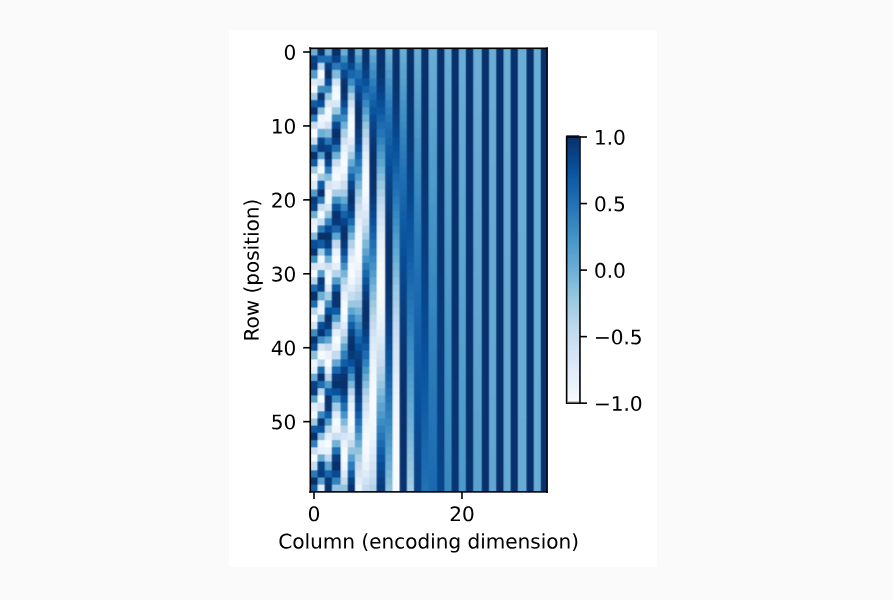

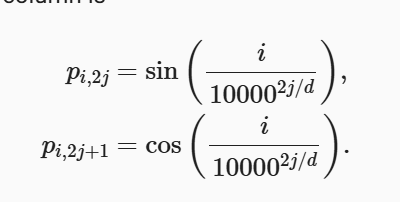

Từ kết luận Trong biểu diễn nhị phân, bit cao hơn có tần số thấp hơn bit thấp hơn. Nên khi đầu vào trở nên quá lớn thì việc sử dụng nhị phân có tần số cao.ì vậy việc mã hóa giảm dần với tần số f = 1/10000 theo (encoding dimension) của một chuỗi với sin và cos một cách liên tục. Các kết quả sẽ là số thực nên sẽ tiết kiệm hơn về không gian, khi mà i (position) trở nên quá lớn khi chuỗi dài   

### Relative Positional Information


Thông tin vị trí tương đối

Bên cạnh việc nắm bắt thông tin vị trí tuyệt đối, mã hóa vị trí (positional encoding) ở trên còn cho phép mô hình dễ dàng học cách chú ý đến các vị trí tương đối. Điều này là do đối với bất kỳ độ lệch vị trí cố định nào 𝛿, mã hóa vị trí tại vị trí 𝑖 + 𝛿 có thể được biểu diễn bằng một phép chiếu tuyến tính của mã hóa tại vị trí 𝑖. Phép chiếu này có thể được giải thích một cách toán học. Gọi 𝜔𝑗 = 1 / 10000^(2𝑗/𝑑), bất kỳ cặp nào của (𝑝𝑖, 2𝑗, 𝑝𝑖, 2𝑗 + 1) trong (11.6.2) đều có thể được chiếu tuyến tính sang (𝑝𝑖 + 𝛿, 2𝑗, 𝑝𝑖 + 𝛿, 2𝑗 + 1) với bất kỳ độ lệch cố định 𝛿 nào: (11.6.3).

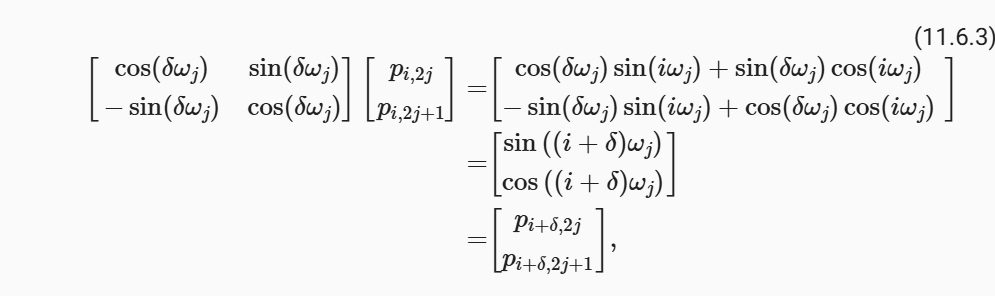

trong đó ma trận chiếu 2 × 2 không phụ thuộc vào bất kỳ chỉ số vị trí nào 𝑖 .


What is Relative Positional Encoding
How does it work and differ from absolute positional encoding? : https://medium.com/@ngiengkianyew/what-is-relative-positional-encoding-7e2fbaa3b510

Understanding Rotary Positional Encoding
Why is it better than absolute or relative positional encoding? : https://medium.com/@ngiengkianyew/understanding-rotary-positional-encoding-40635a4d078e

Self-Attention with Relative Position Representations : https://aclanthology.org/N18-2074.pdf

**Exercise** : https://pandalab.me/archives/self-attention_and_positional_encoding`

2. Can you design a learnable positional encoding method?

What is the purpose of positional embeddings?

In transformers (BERT included) the only interaction between the different tokens is done via self-attention layers. If you look closely at the mathematical operation implemented by these layers you will notice that these layers are permutation equivariant: That is, the representation of
"I do like coding"
and
"Do I like coding"
is the same, because the words (=tokens) are the same in both sentences, only their order is different.
As you can see, this "permutation equivariance" is not a desired property in many cases.
To break this symmetry/equivariance one can simply "code" the actual position of each word/token in the sentence. For example:
"I_1 do_2 like_3 coding_4"
is no longer identical to
"Do_1 I_2 like_3 coding_4"

This is the purpose of positional encoding/embeddings -- to make self-attention layers sensitive to the order of the tokens.

Now to your questions:

learnable position encoding is indeed implemented with a simple single nn.Parameter. The position encoding is just a "code" added to each token marking its position in the sequence. Therefore, all it requires is a tensor of the same size as the input sequence with different values per position.
Is it enough to introduce position encoding once in a transformer architecture? Yes! Since transformers stack multiple self-attention layers it is enough to add positional embeddings once at the beginning of the processing. The position information is "fused" into the semantic representation learned per token.
A nice visualization of this effect in Vision Transformers (ViT) can be found in this work:
Shir Amir, Yossi Gandelsman, Shai Bagon and Tali Dekel Deep ViT Features as Dense Visual Descriptors (arXiv 2021).
In sec. 3.1 and fig. 3 they show how the position information dominates the representation of tokens at early layers, but as you go deeper in a transformer, semantic information takes over.

https://stackoverflow.com/questions/73113261/the-essence-of-learnable-positional-embedding-does-embedding-improve-outcomes-b

Learnable Fourier Features for Multi-Dimensional Spatial Positional Encoding : https://arxiv.org/pdf/2106.02795

Một cách khả thi để thiết kế một phương pháp mã hóa vị trí có thể học được là sử dụng mạng thần kinh để ánh xạ chỉ mục vị trí thành một vectơ có cùng chiều với nhúng từ. Ví dụ: chúng ta có thể sử dụng perceptron nhiều lớp (MLP) với lớp đầu ra tuyến tính để tạo mã hóa vị trí cho từng vị trí. MLP có thể được đào tạo cùng với phần còn lại của mô hình, hoặc được đào tạo trước về một số nhiệm vụ phụ trợ.

Ưu điểm của việc sử dụng phương pháp mã hóa vị trí có thể học được là nó có thể thích ứng với nhiệm vụ và dữ liệu cụ thể và có khả năng nắm bắt các mẫu vị trí phức tạp hơn các phương pháp cố định. Nhược điểm là nó có thể yêu cầu nhiều tham số và tính toán hơn, và có thể không khái quát hóa tốt cho các chuỗi dài hơn so với thấy trong quá trình đào tạo.

3. Can we assign different learned embeddings according to different offsets between queries and keys that are compared in self-attention? Hint: you may refer to **relative position embeddings** (Huang et al., 2018, Shaw et al., 2018).

#### Learn Relative Position Representations

xem bài báo : https://arxiv.org/pdf/1809.04281, https://medium.com/@ngiengkianyew/what-is-relative-positional-encoding-7e2fbaa3b510, https://arxiv.org/pdf/1803.02155

Đầu tiên chúng ta hiểu về self-attention tuyệt đối với position embedding

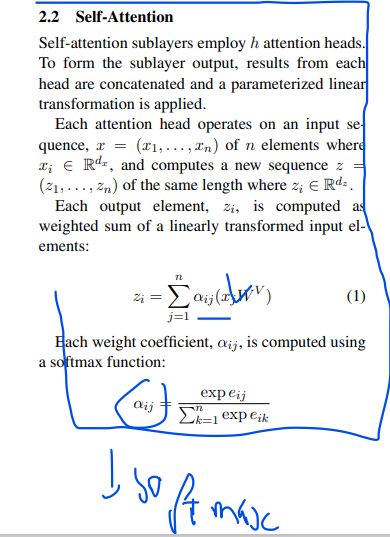

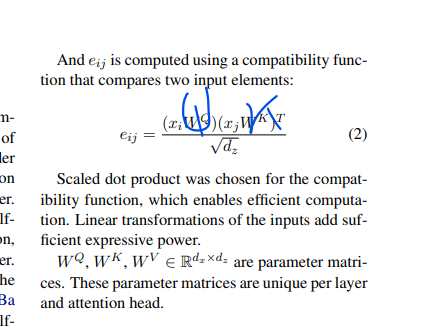

Ở Ralative Position Chúng ta sẽ thêm một cặp trọng số vào self-attention

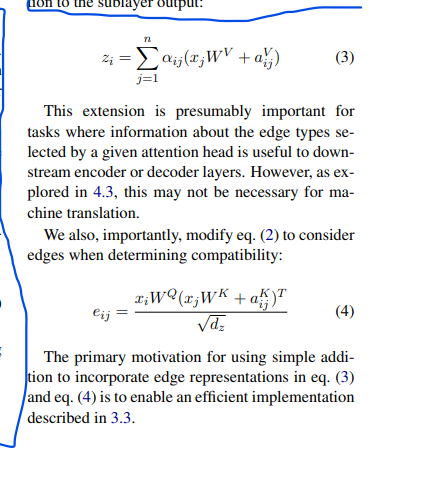

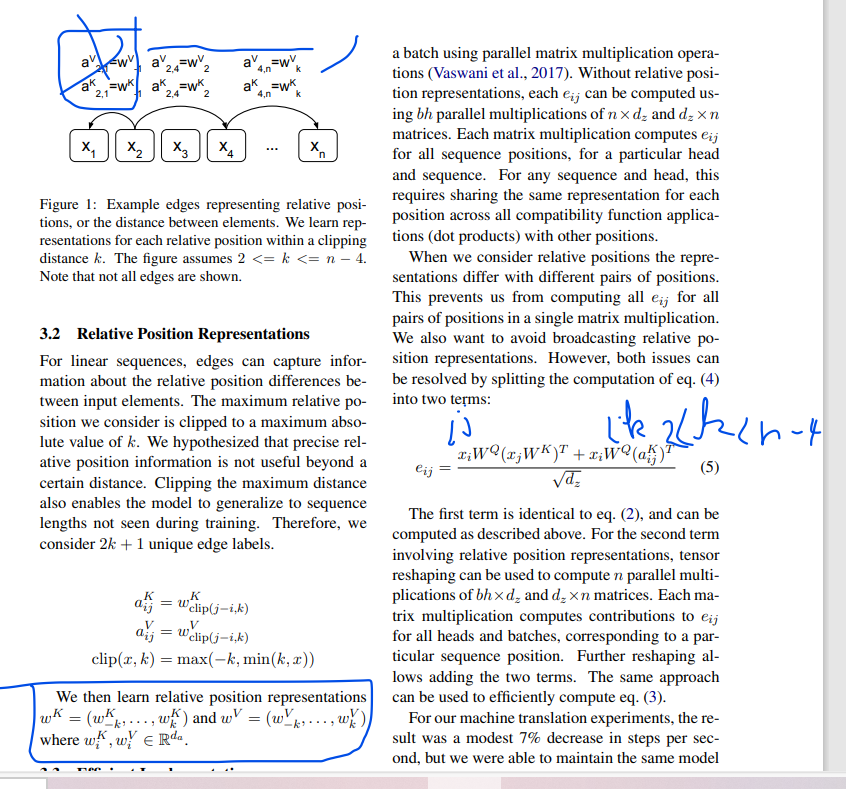

tại một self-attention cụ thể eij chúng sẽ thêm một cặp trọng số aij K và aij V, tại sao lại cặp K và V, ở self-attention chúng ta có f(Q,(K,V)). Việc được biểu diễn bên trên với

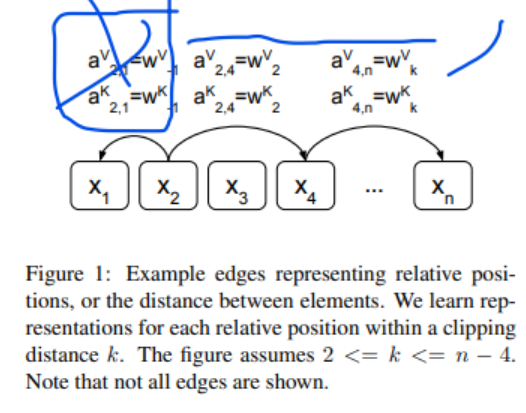

với một ij chúng sẽ có một trọng số ở quá khứ

Code Relative Position Embedding with Tranformer

In [ ]:
class RelativePosition(nn.Module):

    def __init__(self, num_units, max_relative_position):
        super().__init__()
        self.num_units = num_units
        self.max_relative_position = max_relative_position
        self.embeddings_table = nn.Parameter(torch.Tensor(max_relative_position * 2 + 1, num_units))
        nn.init.xavier_uniform_(self.embeddings_table)

    def forward(self, length_q, length_k):
        range_vec_q = torch.arange(length_q)
        range_vec_k = torch.arange(length_k)
        distance_mat = range_vec_k[None, :] - range_vec_q[:, None]
        distance_mat_clipped = torch.clamp(distance_mat, -self.max_relative_position, self.max_relative_position)
        final_mat = distance_mat_clipped + self.max_relative_position
        final_mat = torch.LongTensor(final_mat).cuda()
        embeddings = self.embeddings_table[final_mat].cuda()

        return embeddings

class MultiHeadAttentionLayer(nn.Module):
    def __init__(self, hid_dim, n_heads, dropout, device):
        super().__init__()

        assert hid_dim % n_heads == 0

        self.hid_dim = hid_dim
        self.n_heads = n_heads
        self.head_dim = hid_dim // n_heads
        self.max_relative_position = 2

        self.relative_position_k = RelativePosition(self.head_dim, self.max_relative_position)
        self.relative_position_v = RelativePosition(self.head_dim, self.max_relative_position)

        self.fc_q = nn.Linear(hid_dim, hid_dim)
        self.fc_k = nn.Linear(hid_dim, hid_dim)
        self.fc_v = nn.Linear(hid_dim, hid_dim)

        self.fc_o = nn.Linear(hid_dim, hid_dim)

        self.dropout = nn.Dropout(dropout)

        self.scale = torch.sqrt(torch.FloatTensor([self.head_dim])).to(device)

    def forward(self, query, key, value, mask = None):
        #query = [batch size, query len, hid dim]
        #key = [batch size, key len, hid dim]
        #value = [batch size, value len, hid dim]
        batch_size = query.shape[0]
        len_k = key.shape[1]
        len_q = query.shape[1]
        len_v = value.shape[1]

        query = self.fc_q(query)
        key = self.fc_k(key)
        value = self.fc_v(value)

        r_q1 = query.view(batch_size, -1, self.n_heads, self.head_dim).permute(0, 2, 1, 3)
        r_k1 = key.view(batch_size, -1, self.n_heads, self.head_dim).permute(0, 2, 1, 3)
        attn1 = torch.matmul(r_q1, r_k1.permute(0, 1, 3, 2))

        r_q2 = query.permute(1, 0, 2).contiguous().view(len_q, batch_size*self.n_heads, self.head_dim)
        r_k2 = self.relative_position_k(len_q, len_k)
        attn2 = torch.matmul(r_q2, r_k2.transpose(1, 2)).transpose(0, 1)
        attn2 = attn2.contiguous().view(batch_size, self.n_heads, len_q, len_k)
        attn = (attn1 + attn2) / self.scale

        if mask is not None:
            attn = attn.masked_fill(mask == 0, -1e10)

        attn = self.dropout(torch.softmax(attn, dim = -1))

        #attn = [batch size, n heads, query len, key len]
        r_v1 = value.view(batch_size, -1, self.n_heads, self.head_dim).permute(0, 2, 1, 3)
        weight1 = torch.matmul(attn, r_v1)
        r_v2 = self.relative_position_v(len_q, len_v)
        weight2 = attn.permute(2, 0, 1, 3).contiguous().view(len_q, batch_size*self.n_heads, len_k)
        weight2 = torch.matmul(weight2, r_v2)
        weight2 = weight2.transpose(0, 1).contiguous().view(batch_size, self.n_heads, len_q, self.head_dim)

        x = weight1 + weight2

        #x = [batch size, n heads, query len, head dim]

        x = x.permute(0, 2, 1, 3).contiguous()

        #x = [batch size, query len, n heads, head dim]

        x = x.view(batch_size, -1, self.hid_dim)

        #x = [batch size, query len, hid dim]

        x = self.fc_o(x)

        #x = [batch size, query len, hid dim]

        return x

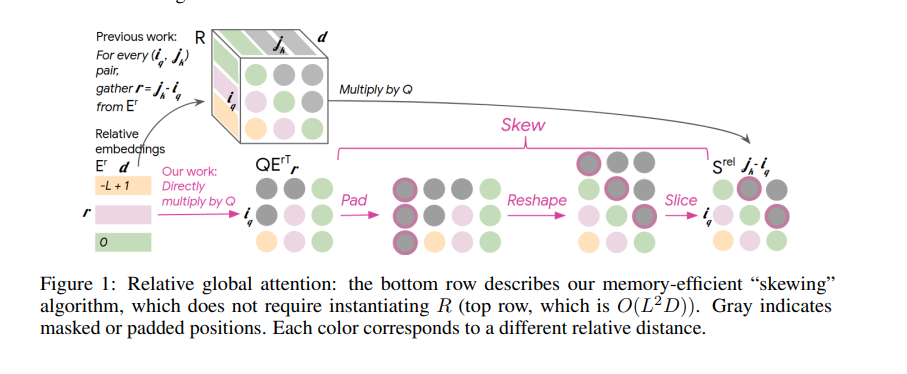

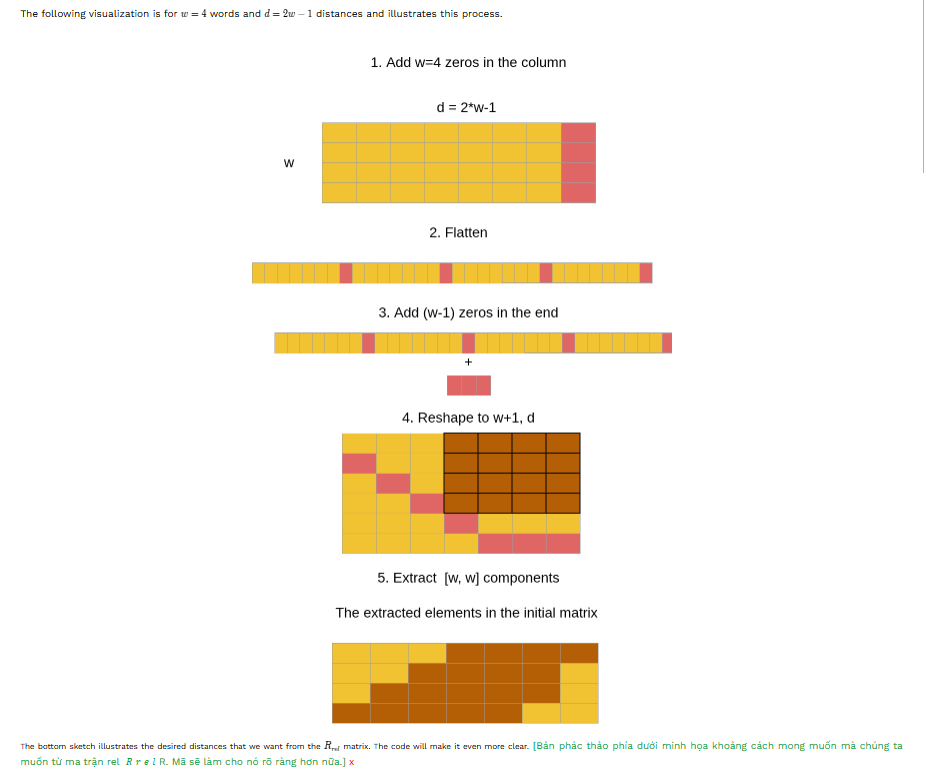

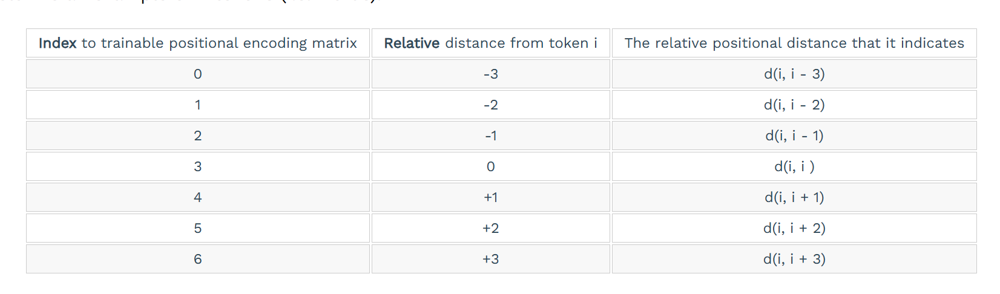

Trực quan nó bằng code

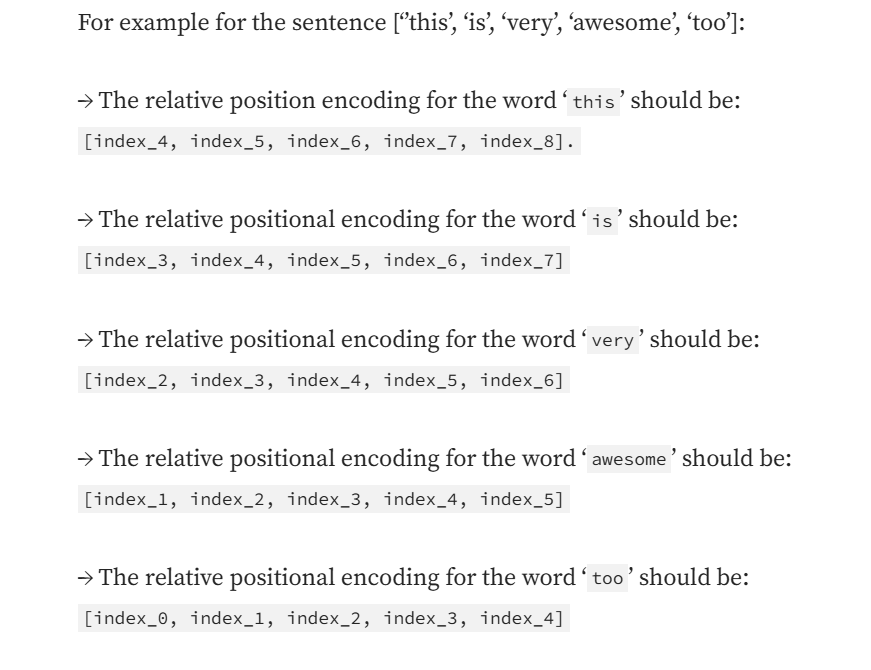

In [ ]:
import torch
from torch import nn

batch_size, num_steps, num_hiddens = 2, 5, 11 # num_steps is length of sequence , num_hiddens is dimenstion embedding
positional_embedding = torch.nn.Parameter(torch.rand(2*num_steps- 1, num_hiddens)) # relative position encoding (Rrel)
assert positional_embedding.shape == (2 * num_steps - 1, num_hiddens)

# X Ouery or Key vectors of shape (B, T, D)

X = torch.randn(batch_size, num_steps, num_hiddens) # Q
print(X.shape)
print(positional_embedding.transpose(0,1).shape)
relative_positional_encoding = torch.matmul(X, positional_embedding.transpose(0,1)) # Q*R.T
print(relative_positional_encoding.shape)
assert relative_positional_encoding.shape == (batch_size, num_steps, 2* num_steps -1)


torch.Size([2, 5, 11])
torch.Size([11, 9])
torch.Size([2, 5, 9])


In [ ]:
relative_positional_encoding[0]

tensor([[ 2.6498,  3.5160,  0.8140,  2.8113,  1.7243,  2.3733,  3.5281,  1.5469,
          1.5721],
        [-1.7039, -1.6552,  0.8441, -1.4890, -1.2651, -1.9887, -2.0607,  0.3843,
          0.3150],
        [ 3.3083,  1.4610,  0.7564, -0.1161, -0.0613,  1.9379,  0.5878,  0.2948,
          0.4440],
        [-1.9757, -2.7713, -2.8069, -2.9502, -3.2598, -3.8393, -2.7306, -2.4208,
         -3.2546],
        [-1.3562, -2.1865,  1.2114, -2.0853, -0.0598, -0.6279, -1.8334,  0.5605,
          0.1136]], grad_fn=<SelectBackward0>)

For example for the sentence [‘’this’, ‘is’, ‘very’, ‘awesome’, ‘too’]:

→ The relative position encoding for the word ‘this’ should be:
[index_4, index_5, index_6, index_7, index_8].

→ The relative positional encoding for the word ‘is’ should be:
[index_3, index_4, index_5, index_6, index_7]

→ The relative positional encoding for the word ‘very’ should be:
[index_2, index_3, index_4, index_5, index_6]

→ The relative positional encoding for the word ‘awesome’ should be:
[index_1, index_2, index_3, index_4, index_5]

→ The relative positional encoding for the word ‘too’ should be:
[index_0, index_1, index_2, index_3, index_4]

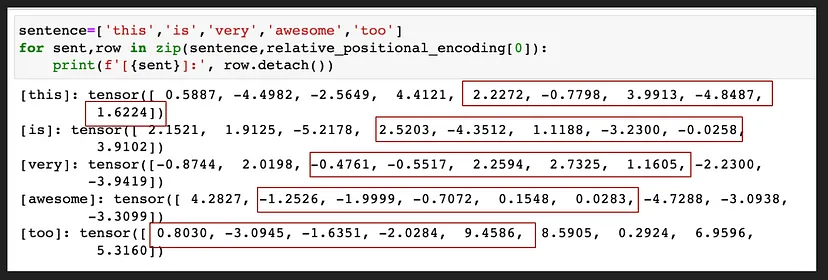

In [ ]:
sentence = ['this', 'is', 'very', 'awesome', 'too']
for sent, row in zip(sentence,  relative_positional_encoding[0]):
    print(f'[{sent}]', row.detach())

[this] tensor([2.6498, 3.5160, 0.8140, 2.8113, 1.7243, 2.3733, 3.5281, 1.5469, 1.5721])
[is] tensor([-1.7039, -1.6552,  0.8441, -1.4890, -1.2651, -1.9887, -2.0607,  0.3843,
         0.3150])
[very] tensor([ 3.3083,  1.4610,  0.7564, -0.1161, -0.0613,  1.9379,  0.5878,  0.2948,
         0.4440])
[awesome] tensor([-1.9757, -2.7713, -2.8069, -2.9502, -3.2598, -3.8393, -2.7306, -2.4208,
        -3.2546])
[too] tensor([-1.3562, -2.1865,  1.2114, -2.0853, -0.0598, -0.6279, -1.8334,  0.5605,
         0.1136])


1. Add padding 2*tokens - 1 + (padding = 1) = 2 *tokens

  The reason why we add padding is to create **a step-wise pattern**

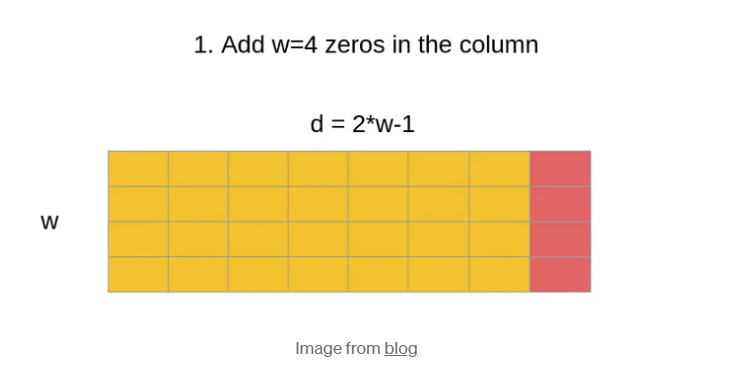

In [ ]:
padding = torch.zeros((batch_size, num_steps, 1)) # B, T , 1
rpe = torch.cat((relative_positional_encoding,padding), dim=-1)
rpe

tensor([[[ 2.6498,  3.5160,  0.8140,  2.8113,  1.7243,  2.3733,  3.5281,
           1.5469,  1.5721,  0.0000],
         [-1.7039, -1.6552,  0.8441, -1.4890, -1.2651, -1.9887, -2.0607,
           0.3843,  0.3150,  0.0000],
         [ 3.3083,  1.4610,  0.7564, -0.1161, -0.0613,  1.9379,  0.5878,
           0.2948,  0.4440,  0.0000],
         [-1.9757, -2.7713, -2.8069, -2.9502, -3.2598, -3.8393, -2.7306,
          -2.4208, -3.2546,  0.0000],
         [-1.3562, -2.1865,  1.2114, -2.0853, -0.0598, -0.6279, -1.8334,
           0.5605,  0.1136,  0.0000]],

        [[ 1.3151, -0.0620, -0.3466,  0.1884,  0.3951,  0.9992,  1.4839,
           0.5656, -0.1729,  0.0000],
         [ 1.2975,  2.6987,  2.1718,  2.2199,  1.7191,  2.1102,  2.3622,
           2.3122,  2.4268,  0.0000],
         [-0.7630, -1.1494,  1.7407,  0.8697, -1.7832, -2.3467, -4.9439,
          -0.9709,  0.9320,  0.0000],
         [ 0.6427, -0.5076, -0.3985,  0.3831,  1.0069,  1.5911,  0.7716,
           0.3677,  0.6498,  0.0000],

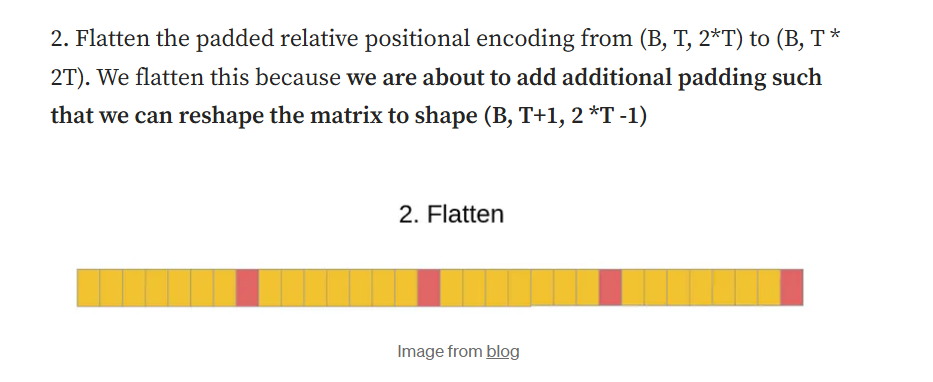

In [ ]:
rpe = rpe.flatten(start_dim=1)
rpe # B, 2*T*T

tensor([[ 2.6498,  3.5160,  0.8140,  2.8113,  1.7243,  2.3733,  3.5281,  1.5469,
          1.5721,  0.0000, -1.7039, -1.6552,  0.8441, -1.4890, -1.2651, -1.9887,
         -2.0607,  0.3843,  0.3150,  0.0000,  3.3083,  1.4610,  0.7564, -0.1161,
         -0.0613,  1.9379,  0.5878,  0.2948,  0.4440,  0.0000, -1.9757, -2.7713,
         -2.8069, -2.9502, -3.2598, -3.8393, -2.7306, -2.4208, -3.2546,  0.0000,
         -1.3562, -2.1865,  1.2114, -2.0853, -0.0598, -0.6279, -1.8334,  0.5605,
          0.1136,  0.0000],
        [ 1.3151, -0.0620, -0.3466,  0.1884,  0.3951,  0.9992,  1.4839,  0.5656,
         -0.1729,  0.0000,  1.2975,  2.6987,  2.1718,  2.2199,  1.7191,  2.1102,
          2.3622,  2.3122,  2.4268,  0.0000, -0.7630, -1.1494,  1.7407,  0.8697,
         -1.7832, -2.3467, -4.9439, -0.9709,  0.9320,  0.0000,  0.6427, -0.5076,
         -0.3985,  0.3831,  1.0069,  1.5911,  0.7716,  0.3677,  0.6498,  0.0000,
         -1.6835, -1.8512,  0.0338, -2.6691, -1.6793, -2.1288, -3.4099, -1.8222,


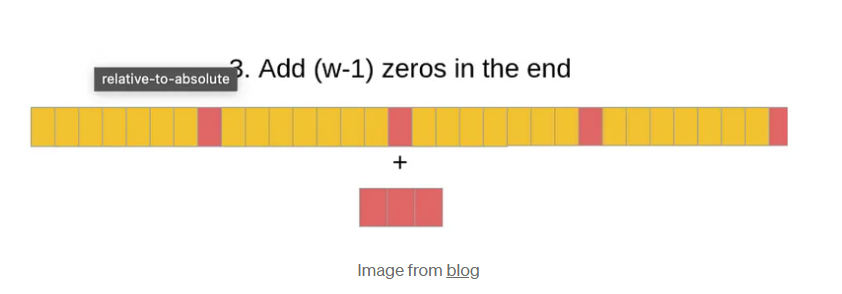

In [ ]:
rpe = torch.cat([rpe, torch.zeros(batch_size, num_steps -1)], dim=-1) # B, 2*T*T + (T-1)

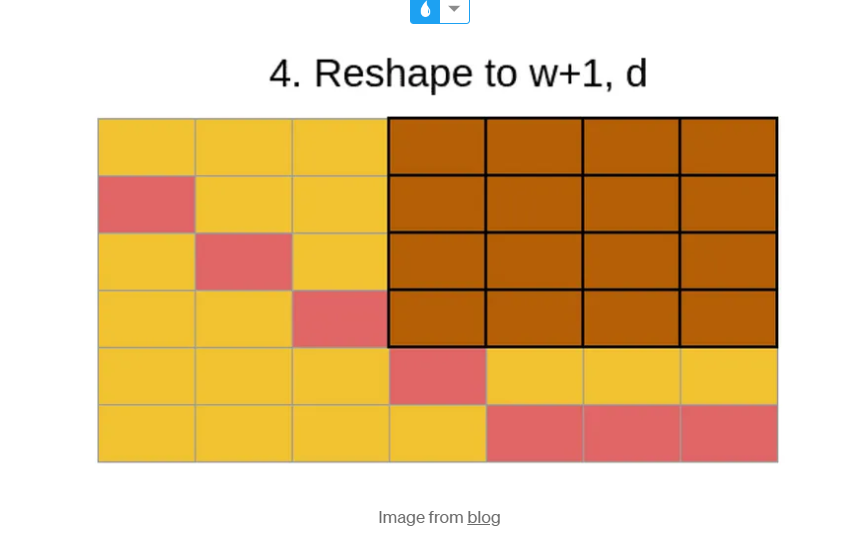

In [ ]:
rpe = rpe.reshape(batch_size, num_steps + 1, 2*num_steps - 1) # (B, 2 * T**2 + T-1) thành (B, T+1, 2*T-1)

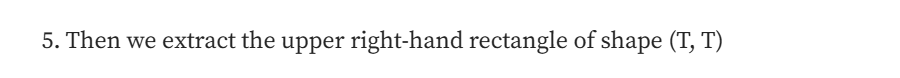

In [ ]:
rpe = rpe[:,:-1, -num_steps:]
rpe

tensor([[[ 1.7243,  2.3733,  3.5281,  1.5469,  1.5721],
         [-1.4890, -1.2651, -1.9887, -2.0607,  0.3843],
         [ 0.7564, -0.1161, -0.0613,  1.9379,  0.5878]],

        [[ 0.3951,  0.9992,  1.4839,  0.5656, -0.1729],
         [ 2.2199,  1.7191,  2.1102,  2.3622,  2.3122],
         [ 1.7407,  0.8697, -1.7832, -2.3467, -4.9439]]],
       grad_fn=<SliceBackward0>)

In [ ]:
relative_positional_encoding

tensor([[[ 2.6498,  3.5160,  0.8140,  2.8113,  1.7243,  2.3733,  3.5281,
           1.5469,  1.5721],
         [-1.7039, -1.6552,  0.8441, -1.4890, -1.2651, -1.9887, -2.0607,
           0.3843,  0.3150],
         [ 3.3083,  1.4610,  0.7564, -0.1161, -0.0613,  1.9379,  0.5878,
           0.2948,  0.4440],
         [-1.9757, -2.7713, -2.8069, -2.9502, -3.2598, -3.8393, -2.7306,
          -2.4208, -3.2546],
         [-1.3562, -2.1865,  1.2114, -2.0853, -0.0598, -0.6279, -1.8334,
           0.5605,  0.1136]],

        [[ 1.3151, -0.0620, -0.3466,  0.1884,  0.3951,  0.9992,  1.4839,
           0.5656, -0.1729],
         [ 1.2975,  2.6987,  2.1718,  2.2199,  1.7191,  2.1102,  2.3622,
           2.3122,  2.4268],
         [-0.7630, -1.1494,  1.7407,  0.8697, -1.7832, -2.3467, -4.9439,
          -0.9709,  0.9320],
         [ 0.6427, -0.5076, -0.3985,  0.3831,  1.0069,  1.5911,  0.7716,
           0.3677,  0.6498],
         [-1.6835, -1.8512,  0.0338, -2.6691, -1.6793, -2.1288, -3.4099,
       

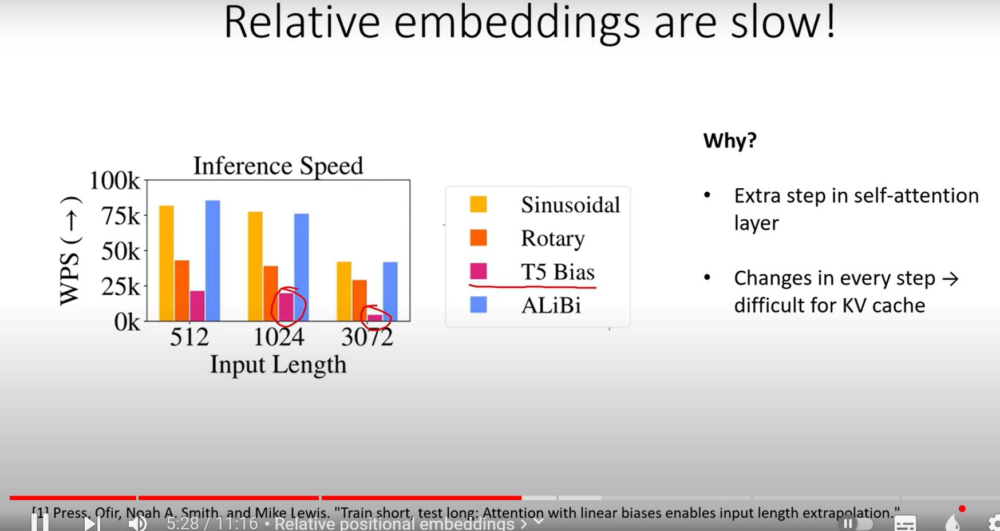

Hình ảnh trên hiển thị biểu đồ về tốc độ suy luận (inference speed) của các phương pháp nhúng vị trí tương đối (relative embeddings) so với độ dài đầu vào (input length). Trục y của biểu đồ biểu thị "WPS" (words per second), trong khi trục x biểu thị độ dài đầu vào (512, 1024, 3072).

Có bốn phương pháp nhúng được so sánh:
1. **Sinusoidal** (màu cam)
2. **Rotary** (màu đỏ cam)
3. **T5 Bias** (màu hồng)
4. **ALiBi** (màu xanh dương)

Dựa vào biểu đồ:
- **ALiBi** (màu xanh dương) có tốc độ suy luận nhanh nhất ở tất cả các độ dài đầu vào.
- **T5 Bias** (màu hồng) có tốc độ suy luận thấp nhất, đặc biệt khi độ dài đầu vào là 512.
- **Rotary** và **Sinusoidal** cũng có tốc độ khá tốt, nhưng kém hơn **ALiBi**.

**Lý do tại sao nhúng vị trí tương đối (relative embeddings) chậm hơn**:
- Cần một bước bổ sung trong lớp tự chú ý (self-attention).
- Các thay đổi trong mỗi bước khiến việc lưu trữ bộ đệm KV cache trở nên khó khăn.

Biểu đồ này minh họa rằng các phương pháp như **ALiBi** không yêu cầu các bước bổ sung và thích ứng tốt hơn với các độ dài đầu vào lớn.

KV cache memory usage in tranformer  :  https://www.youtube.com/watch?v=80bIUggRJf4

### Rotary Positional Encoding

Nội dung bạn đã cung cấp giải thích về cách sử dụng ma trận xoay 2-D trong **Rotary Positional Encoding** (mã hóa vị trí xoay) trong mô hình Transformer, cụ thể là cách chúng giúp mã hóa thông tin về vị trí của các từ trong chuỗi.

**Dịch nội dung:**

Ma trận xoay sử dụng trong Rotary Positional Encoding là các khối ma trận xoay 2 chiều (2-D rotation matrix), như hình trên.

Câu hỏi đầu tiên mà tôi tự hỏi là "Tại sao?". Khi tìm hiểu về ma trận xoay trong các không gian nhiều chiều hơn, tôi phát hiện rằng việc tính toán ma trận xoay ở các không gian lớn hơn 2 chiều có thể rất phức tạp.

Vì các chiều ẩn (hidden dimensions) của các vector nhúng token thường lớn hơn 2 chiều, nên chúng ta cần một cách dễ hơn để tạo ra ma trận xoay.

Tôi thấy rất thông minh khi các tác giả đã quyết định sử dụng ma trận xoay 2-D (dễ hiểu và trực quan) để tạo ra ma trận xoay tổng thể.

Vì vector của chúng ta thường có nhiều hơn 2 chiều và dễ hiểu ma trận xoay 2-D, các tác giả đã nghĩ ra một cách thông minh để sử dụng ma trận xoay 2-D để xoay toàn bộ vector D chiều. Ý tưởng là sử dụng các ma trận xoay 2-D khác nhau cho mỗi cặp chiều (mỗi tập hợp vector kích thước 2) với một góc nào đó. Vì chúng ta sử dụng "cặp chiều", chúng ta sẽ yêu cầu ‘D’ phải chia hết cho 2, điều này không phải là vấn đề vì trong deep learning, D thường được chọn là một lũy thừa của 2, và như vậy chia hết cho 2.

**Giải thích ký hiệu toán học trong hình:**

- **m** là vị trí của từ trong chuỗi.
  → Lưu ý rằng **m** giống nhau cho tất cả các cặp vector 2-D.

- **Theta** là một giá trị vô hướng được chọn để xoay vector.
  → Lưu ý rằng **Theta** được đánh dấu chỉ số theo cặp vector 2-D tương ứng.

- Góc để xoay mỗi cặp vector 2-D là **m * Theta_i**, trong đó **i** là chỉ số của cặp vector 2-D tương ứng.
  → Điều này có nghĩa là mỗi cặp vector 2-D sẽ được xoay với một góc khác nhau.

**Ví dụ:**

Cho câu **[this, is, awesome]**, chúng ta hãy xem cách nó xoay mã hóa vị trí cho từ **this** và **is**.

Giả sử rằng các vector nhúng cho các từ là các vector 6 chiều:
  → **this**: **[x1, x2, x3, x4, x5, x6]**
  → **is**: **[x7, x8, x9, x10, x11, x12]**

Chúng ta biết rằng:
  → Từ **this** ở vị trí **0**, do đó **m = 0**. (Lưu ý rằng điều này sẽ giống nhau trên tất cả các ma trận xoay của từ **this**)
  → Từ **is** ở vị trí **1**, do đó **m = 1**. (Lưu ý rằng điều này sẽ giống nhau trên tất cả các ma trận xoay của từ **is**)

Vì chúng ta có các vector 6 chiều, điều này có nghĩa là chúng ta có 3 cặp vector 2-D cho mỗi từ (cũng là 3 ma trận xoay) **(6/2) = 3**.

Đối với mỗi từ, vì chúng ta có 3 cặp vector 2-D, chúng ta sẽ có 3 giá trị **Theta** được chia sẻ giữa các từ:
  → Giả sử **Theta** là **[0.1, 0.4, 0.6]**.

Các tác giả đã đề xuất các giá trị **Theta** dưới đây cho các từ **this** và **is**.

Vì chúng ta có 3 cặp vector 2-D (trong ví dụ này là các vector nhúng 6 chiều), chúng ta sẽ có:
1. 3 ma trận xoay cho mỗi từ, do đó
2. 3 góc cho mỗi từ (tính bằng **m * Theta_i**) để xoay.

  → 3 góc cho **this**: **[0, 0, 0] = [m=0 * Theta_0=0.1, m=0 * Theta_1=0.4, m=0 * Theta_2=0.6]**.
  → 3 góc cho **is**: **[0.1, 0.4, 0.6] = [m=1 * Theta_0=0.1, m=1 * Theta_1=0.4, m=1 * Theta_2=0.6]**.

Nếu chúng ta thay các giá trị này vào ma trận xoay và nhân với vector 6 chiều của từ **this**:
  → Chúng ta sẽ xoay với góc **0** cho các cặp vector **[x1, x2]**, **[x3, x4]**, **[x5, x6]**.

Nếu chúng ta thay các giá trị này vào ma trận xoay và nhân với vector 6 chiều của từ **is**:
  → Chúng ta sẽ xoay với góc **0.1** cho cặp vector **[x7, x8]**,
  → Chúng ta sẽ xoay với góc **0.4** cho cặp vector **[x9, x10]**,
  → Chúng ta sẽ xoay với góc **0.6** cho cặp vector **[x11, x12]**.

Điều này có nghĩa là mỗi vector nhúng của từ sẽ được xoay bởi 3 cặp ma trận xoay, mỗi cặp có góc xoay khác nhau bị ảnh hưởng bởi vị trí của từng từ. Kết quả là, mã hóa vị trí sẽ phản ánh vị trí của từ và nhờ đó chúng ta có thể tạo ra các kết quả attention khác nhau cho cùng một từ ở các vị trí khác nhau.

**Rotary Positional Encoding khắc phục những nhược điểm của Absolute và Relative Positional Encoding bằng cách kết hợp cả hai.**

**Đầu tiên, hãy xem cách nó kết hợp cả hai:**

**Absolute positional encoding trong Rotary Positional Encoding:**  
Lưu ý trong ví dụ của chúng ta về rotary positional encoding cho từ **this** và **is**, rằng ma trận xoay chỉ phụ thuộc vào \( m * \Theta_i \), trong đó \( \Theta_i \) được chia sẻ giữa tất cả các từ, và \( m \) chỉ là vị trí của từ (không quan tâm đến các vị trí của những từ khác).

Tương tự như absolute positional encoding, chúng ta có một mã hóa vị trí cho mỗi vị trí mà không phụ thuộc vào vị trí của các từ khác.

**Relative Positional Encoding trong Rotary Positional Encoding:**  
Vì góc xoay phụ thuộc vào \( m * \Theta_i \), các từ ở đầu câu sẽ có góc xoay nhỏ hơn, và các từ cuối câu sẽ có góc xoay lớn hơn, làm cho khoảng cách giữa các từ trở thành tương đối.

→ Nhớ rằng \( \Theta_i \) giống nhau cho tất cả các từ, và chỉ có vị trí \( m \) là thay đổi. Giá trị \( m \) càng cao thì \( m * \Theta_i \) càng lớn, nghĩa là góc xoay lớn hơn.

Tương tự như relative positional encoding, có mối quan hệ giữa mã hóa vị trí của các vị trí khác nhau.

**Tại sao Rotary Positional Encoding khắc phục nhược điểm của cả hai phương pháp?**

Để giải thích điều này, chúng ta hãy xem xét lại các nhược điểm của từng phương pháp:

1. **Absolute Positional Encoding**: Không bao gồm thông tin vị trí tương đối.
2. **Relative Positional Encoding**: Hiệu suất tính toán kém và không phù hợp cho quá trình suy luận (inference).

Do đó, Rotary Positional Encoding cần đảm bảo các tính chất sau:

1. Bao gồm thông tin vị trí tương đối.
2. Hiệu suất tính toán cao.
3. Phù hợp cho quá trình suy luận.

**(Tính chất 1) Rotary Positional Encoding bao gồm thông tin vị trí tương đối**  
Rotary Positional Encoding bao gồm thông tin vị trí tương đối bằng cách làm cho các góc trong ma trận xoay phụ thuộc vào vị trí hiện tại của từ, và nhờ các tính chất của ma trận xoay, nó cho biết khoảng cách giữa hai từ là bao xa.

Ví dụ, trong Hình 4, góc giữa từ "pig" và "dog" là giống nhau mặc dù chúng (1) xuất hiện trong 2 câu có độ dài khác nhau, và (2) xuất hiện ở các vị trí khác nhau trong câu!  
→ (Nếu bạn tính tích vô hướng giữa “pig” và “dog” trong cả hai câu, kết quả sẽ giống nhau).  
→ Góc giữa “pig” và “dog” luôn giống nhau dù khoảng cách giữa chúng là 2 từ (có “chased the” giữa “pig” và “dog”).

Nhớ rằng góc xoay của từ là \( m * \Theta_i \), và góc giữa "pig" và "dog" là \( (m_{\text{dog}} - m_{\text{pig}}) = 2 * \Theta_i \).

Một cách khác để nhìn nhận là vẽ biểu đồ góc trong ma trận xoay cho các vị trí khác nhau:

→ Trục y biểu thị góc xoay.  
→ Trục x biểu thị chiều ẩn của vector nhúng.  
Đối với biểu đồ dưới đây, bạn nên chú ý đến sự thay đổi của toàn bộ biểu đồ khi tăng \( m \) (vị trí của từ).

**Biểu đồ góc trong ma trận xoay cho các vị trí từ 1 đến 7**  
1. Từ biểu đồ, ta thấy một mẫu đều đặn khi \( m \) tăng từ 1 đến 7, góc xoay cũng tăng theo. Điều này có nghĩa là mã hóa vị trí của một từ có góc xoay lớn hơn thì từ đó nằm xa hơn trong câu.

2. Khoảng cách giữa \( t = 1 \) và \( t = 3 \) lớn hơn khoảng cách giữa \( t = 1 \) và \( t = 2 \).

3. Độ lớn của sự khác biệt giữa hai cặp vị trí liên tiếp là như nhau.  
→ Điều này có nghĩa là thay đổi một bước thời gian dẫn đến sự thay đổi tương đối giống nhau về góc xoay.

**Một cách nhìn khác về Tính chất 1:**  
1. Cho đến nay chúng ta chỉ nói về “góc xoay”, nhưng phần nào mã hóa khoảng cách tương đối từ một từ đến các vị trí khác? Câu trả lời nằm trong định nghĩa của tích vô hướng:

→ “Tích vô hướng của hai vector A và B bằng với độ dài của A nhân với độ dài của B nhân với cosine của góc giữa chúng: \( A \cdot B = |A||B| \cos(\theta) \).”

2. Nếu ta tính tích vô hướng giữa rotary positional encoding của vị trí 1 và các vị trí khác, kết quả nhận được sẽ chỉ phụ thuộc vào góc xoay (cụ thể hơn là sự khác biệt về góc xoay giữa vị trí 1 và các vị trí khác).

3. Góc xoay cho vị trí 1 nhỏ hơn các góc xoay cho các vị trí lớn hơn 1. Điều này có nghĩa là (1) khoảng cách giữa các góc xoay lớn hơn, (2) tích vô hướng nhỏ hơn, và (3) từ càng xa vị trí 1 thì tích vô hướng càng nhỏ.

**Tính chất 2: Rotary Positional Encoding có hiệu suất tính toán cao**  
Mặc dù có vẻ như việc tạo ma trận xoay cho Rotary Positional Encoding không hiệu quả về mặt tính toán, nhưng các nhà nghiên cứu đã tìm ra một công thức tối ưu để thực hiện điều này.

**Tính chất 3: Rotary Positional Encoding phù hợp cho quá trình suy luận**  
Rotary Positional Encoding tương tự như absolute positional encoding ở chỗ các mã hóa vị trí chỉ phụ thuộc vào vị trí hiện tại của từ, do đó các mã hóa vị trí của những từ đã được tạo ra trước đó không thay đổi. Điều này cho phép sử dụng bộ nhớ KV trong quá trình suy luận.



Rotary Positional Encoding (Mã hóa vị trí quay) bao gồm thông tin về vị trí tương đối bằng cách làm cho các góc trong ma trận quay phụ thuộc vào vị trí hiện tại của từ, và theo tính chất của ma trận quay, nó cho chúng ta biết khoảng cách giữa hai từ.

Ví dụ trong Hình 4, góc giữa “pig” và “dog” là như nhau mặc dù chúng (1) xuất hiện trong 2 câu có độ dài khác nhau, và (2) “pig” và “dog” xuất hiện ở các vị trí khác nhau trong câu!
→ (Nếu bạn tính tích vô hướng giữa “pig” và “dog” trong cả hai câu, chúng sẽ giống nhau).
→ Góc này giống nhau vì các từ “pig” và “dog” luôn cách nhau 2 từ (với “chased the” nằm giữa “pig” và “dog”).
→ Hãy nhớ rằng góc quay của một từ là θ, và góc giữa “pig” và “dog” cách nhau 2 từ là \(m * \Theta_i\) (với \(m_{\text{dog}} - m_{\text{pig}} = 2 * \Theta_i\)).

Understanding Rotary Positional Encoding
Why is it better than absolute or relative positional encoding? : https://medium.com/@ngiengkianyew/understanding-rotary-positional-encoding-40635a4d078e

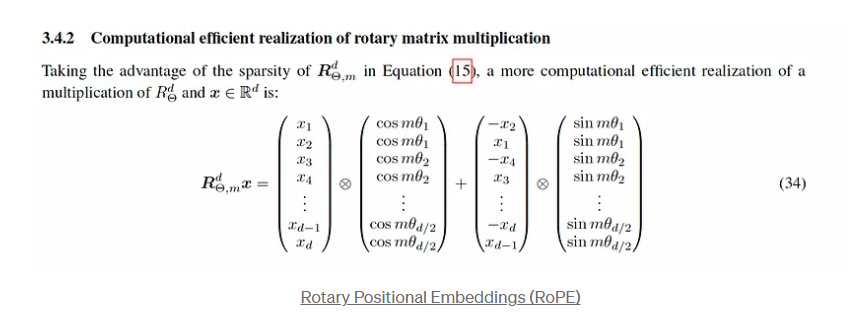

code : chttps://nn.labml.ai/transformers/rope/index.html

In [ ]:
import torch
from torch import nn


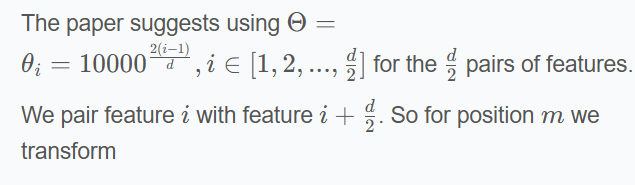

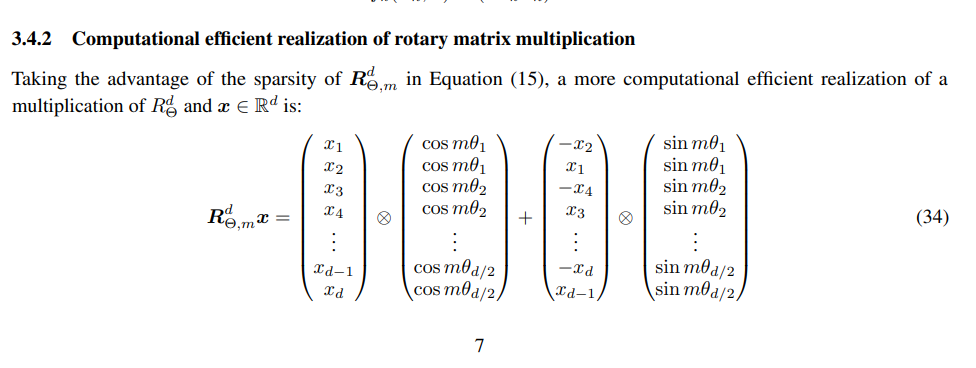

từ bài báo : https://arxiv.org/pdf/2104.09864

In [ ]:
class RotaryPositionalEmbeddings(nn.Module):
  def __init__(self, d: int, base: int = 10_000): # hinh tren bieu cho 10000
       super().__init__() # ket thua tu lop cha Module
       self.base = base
       self.d = d
       self.cos_cached = True
       self.sin_cached = True

  def _build_cache(self, x: torch.Tensor):
    if self.cos_cached is not None and X.shape[0] <= self.cos_cached.shape[0]:
      return

    seq_len = x.shape[0]
    theta = 1. / (self.base **(torch.arange(0, self.d, 2).float() / self.d)).to(x.device)
    seq_idx = torch.arange(seq_len, device=x.device).float().to(x.device)
    idx_theta = torch.einsum('n,d ->nd', seq_idx, theta)
    idx_theta2 = torch.cat([idx_theta, idx_theta], dim=1)

    self.cos_cached = idx_theta2.cos()[..., None, :]
    self.sin_cached = idx_theta2.sin()[..., None, :]

  def _neg_haft(self, x: torch.Tensor):
    d_2 = self.d // 2
    return torch.cat([-x[..., :d_2], x[..., d_2:]], dim=-1)

  def forward(self, x: torch.Tensor):
    self._build_cache(x)
    x_rope, x_pass = x[..., :self.d], x[..., self.d:]
    neg_haft_x = self._neg_haft(x_rope)
    x_rope = (x_rope * self.cos_cached[:x.shape[0]]) + (neg_haft_x * self.sin_cached[:x.shape[0]])
    return torch.cat((x_rope, x_pass), dim=-1)

Dưới đây là bản dịch của nội dung:

**Phép nhúng vị trí tương đối**

Các tác giả Shaw và cộng sự [2018] đã áp dụng các thiết lập khác nhau của Phương trình (1) như sau:
$$
f_q(x_m) := W_q x_m
$$
$$
f_k(x_n, n) := W_k(x_n + \tilde{p}_r^k)
$$
$$
f_v(x_n, n) := W_v(x_n + \tilde{p}_r^v)
$$
trong đó $ \tilde{p}_r^k $ và $ \tilde{p}_r^v \in \mathbb{R}^d $ là các phép nhúng vị trí tương đối có thể huấn luyện. Lưu ý rằng $ r = \text{clip}(m - n, r_{\text{min}}, r_{\text{max}}) $ biểu diễn khoảng cách tương đối giữa vị trí $ m $ và $ n $. Họ đã cắt ngắn khoảng cách tương đối với giả thiết rằng thông tin vị trí tương đối chính xác là không cần thiết khi vượt quá một khoảng cách nhất định. Giữ nguyên dạng của Phương trình (3), các tác giả Dai và cộng sự [2019] đã đề xuất phân tách $ q_m^\top k_n $ trong Phương trình (2) thành:

$$
q_m^\top k_n = x_m^\top W_q^\top W_k x_n + x_m^\top W_q^\top W_k p_n + p_m^\top W_q^\top W_k x_n + p_m^\top W_q^\top W_k p_n
$$

Ý chính là thay thế phép nhúng vị trí tuyệt đối $ p_n $ bằng phép nhúng dạng sin/cos tương đối $ \tilde{p}_{m-n} $, trong khi thay vị trí tuyệt đối $ p_m $ ở các hạng tử thứ ba và thứ tư bằng hai vector có thể huấn luyện $ u $ và $ v $ độc lập với các vị trí truy vấn. Hơn nữa, $ W_k $ được phân biệt cho các vector khoá dựa trên nội dung và dựa trên vị trí $ x_n $ và $ p_n $, được ký hiệu là $ W_k $ và $ W_k $, kết quả là:

$$
q_m^\top k_n = x_m^\top W_q^\top W_k x_n + x_m^\top W_q^\top W_k \tilde{p}_{m-n} + u^\top W_q^\top W_k x_n + v^\top W_q^\top W_k \tilde{p}_{m-n}
$$

Lưu ý rằng thông tin vị trí trong hạng tử giá trị đã bị loại bỏ bằng cách đặt $ f_v(x_j) := W_v x_j $. Các công trình sau đó của Raffel và cộng sự [2020], He và cộng sự [2020], Ke và cộng sự [2020], Huang và cộng sự [2020] đã áp dụng các thiết lập này bằng cách chỉ mã hóa thông tin vị trí tương đối vào trọng số chú ý. Tuy nhiên, các tác giả Raffel và cộng sự [2020] đã điều chỉnh Phương trình (6) thành:

$$
q_m^\top k_n = x_m^\top W_q^\top W_k x_n + b_{i,j}
$$

trong đó $ b_{i,j} $ là một tham số bù có thể huấn luyện. Các tác giả Ke và cộng sự [2020] đã nghiên cứu hai hạng tử ở giữa của Phương trình (6) và nhận thấy mối tương quan không cao giữa vị trí tuyệt đối và các từ. Các tác giả Raffel và cộng sự [2020] đã đề xuất mô hình hóa một cặp từ hoặc vị trí bằng các ma trận chiếu khác nhau.

$$
q_m^\top k_n = x_m^\top W_q^\top W_k x_n + p_m^\top U_q^\top U_k p_n + b_{i,j}
$$

**RoFormer**

Các tác giả He và cộng sự [2020] cho rằng vị trí tương đối của hai token chỉ có thể được mô hình hóa đầy đủ bằng hai hạng tử ở giữa của Phương trình (6). Do đó, các phép nhúng vị trí tuyệt đối $ p_m $ và $ p_n $ đã được thay thế đơn giản bằng các phép nhúng vị trí tương đối $ \tilde{p}_{m-n} $:

$$
q_m^\top k_n = x_m^\top W_q^\top W_k x_n + x_m^\top W_q^\top W_k \tilde{p}_{m-n} + \tilde{p}_{m-n}^\top W_q^\top W_k x_n
$$

So sánh giữa bốn biến thể của các phép nhúng vị trí tương đối được Radford và Narasimhan [2018] cho thấy rằng biến thể tương tự Phương trình (10) là hiệu quả nhất trong số ba biến thể còn lại. Nhìn chung, tất cả các cách tiếp cận này đều cố gắng sửa đổi Phương trình (6) dựa trên sự phân tách của Phương trình (3) trong bối cảnh tự chú ý của Phương trình (2), ban đầu được đề xuất bởi Vaswani và cộng sự [2017]. Các cách tiếp cận này thường thêm trực tiếp thông tin vị trí vào các biểu diễn ngữ cảnh. Ngược lại, cách tiếp cận của chúng tôi nhằm mục đích dẫn xuất mã hóa vị trí tương đối từ Phương trình (1) dưới một số ràng buộc. Tiếp theo, chúng tôi sẽ chứng minh rằng cách tiếp cận này dễ diễn giải hơn khi kết hợp thông tin vị trí tương đối với sự quay của các biểu diễn ngữ cảnh.

# The Transformer Architecture

## Module

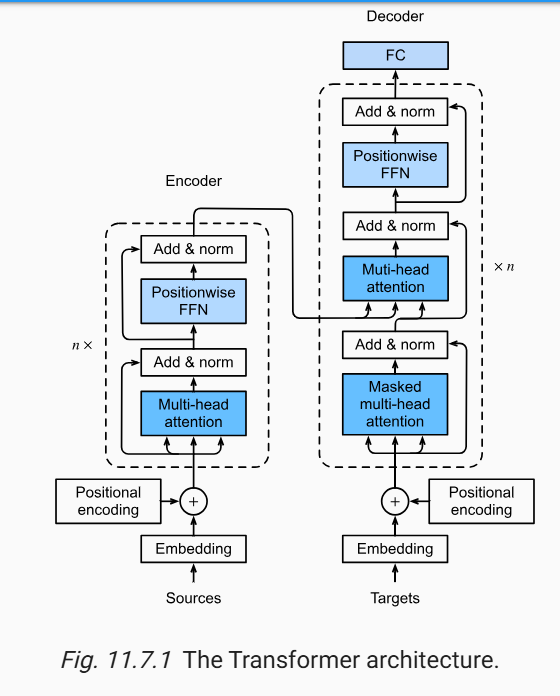

## Positionwise Feed-Forward Networks

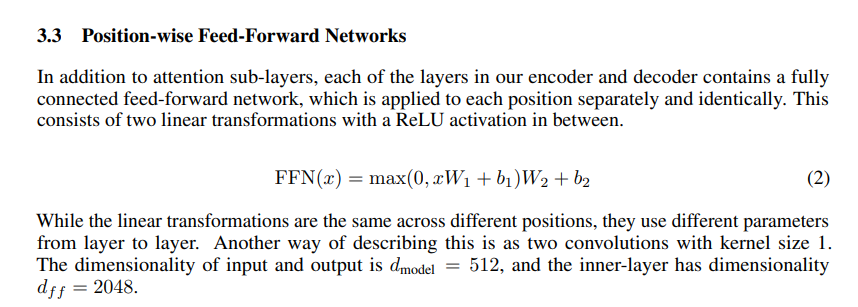

Nội dung này mô tả về một mạng feed-forward (FFN) được sử dụng trong từng lớp của bộ mã hóa (encoder) và bộ giải mã (decoder) trong mô hình Transformer. Cụ thể, ở mỗi vị trí của chuỗi đầu vào, mạng FFN này được áp dụng một cách riêng biệt và giống hệt nhau. Nó bao gồm hai phép biến đổi tuyến tính (linear transformation) và một hàm kích hoạt ReLU ở giữa:

FFN(x) = max(0, xW₁ + b₁)W₂ + b₂

Mặc dù các phép biến đổi tuyến tính giống nhau cho các vị trí khác nhau, nhưng chúng sử dụng các tham số khác nhau cho từng lớp. Một cách diễn tả khác về FFN là hai phép tích chập (convolution) với kích thước kernel bằng 1.

Kích thước đầu vào và đầu ra là \(d_{model} = 512\), và kích thước của lớp ẩn bên trong là \(d_{ff} = 2048\).

Why ? tại nó được sử dụng

https://nlp.seas.harvard.edu/2018/04/03/attention.html

Lý do  được gọi là Position wise:

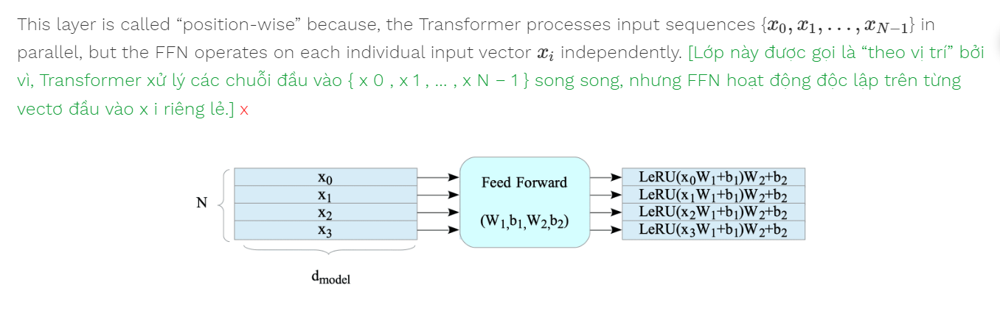

Lý do Layer position wise được sử dung :
  1. Tăng tính phi tuyến vì sử dụng relu (Hàm kích hoạt ReLU, max(0, X), được sử dụng giữa các lớp. Mọi giá trị lớn hơn 0 vẫn giữ nguyên và mọi giá trị nhỏ hơn hoặc bằng 0 đều trở thành 0. Nó tạo ra tính phi tuyến tính và giúp ngăn chặn sự biến mất của gradient.)

  2. Theo d2l, nó được gọi là mạng "khôn ngoan về vị trí" vì nó "biến đổi biểu diễn ở tất cả các vị trí chuỗi bằng cách sử dụng **cùng một MLP**." Nói cách khác, FNN có kích thước (d_model, d_ffn) trong lớp đầu tiên, có nghĩa là nó phải được phát trên mỗi chuỗi trong quá trình nhân tensor. Điều này có nghĩa là mỗi chuỗi được nhân với cùng trọng số. Nếu các chuỗi giống nhau được nhập vào thì các đầu ra cũng sẽ giống hệt nhau. Logic tương tự này áp dụng cho lớp kích thước dày đặc thứ hai (d_ffn, d_model), trả về tensor về kích thước ban đầu.

  3. Tôi cũng muốn trích dẫn từ cuốn sách Natural Language Processing with Transformers:


**Lưu ý** rằng một lớp feed-forward như nn.Linear thường được áp dụng cho một tensor có hình dạng (batch_size, input_dim), nơi nó **hoạt động độc lập** trên mỗi phần tử của batch. Điều này thực sự đúng với bất kỳ chiều nào ngoại trừ chiều cuối cùng, vì vậy khi chúng ta truyền một tensor có hình dạng (batch_size, seq_len, hidden_dim), lớp này được **áp dụng cho tất cả các embedding của token trong batch và chuỗi một cách độc lập**.

Cuối cùng, điều quan trọng là quan sát rằng bằng cách này bạn sẽ thu được một trạng thái ẩn cho mỗi token trong batch, **điều này làm cho kiến trúc rất linh hoạt.**
  4. Mạng chuyển tiếp nguồn cấp dữ liệu thông minh theo vị trí (FFN) bao gồm hai lớp dày đặc được kết nối đầy đủ hoặc một perceptron nhiều lớp (MLP). Lớp ẩn, được gọi là d_ffn, thường được đặt thành giá trị gấp khoảng bốn lần so với d_model. Đây là lý do tại sao đôi khi nó được gọi là mạng mở rộng và hợp đồng.

L

In [ ]:
from torch import nn
import torch

Mạng feed-forward positionwise biến đổi các biểu diễn tại tất cả các vị trí trong chuỗi sử dụng cùng một MLP (Multi-Layer Perceptron). Đây là lý do tại sao nó được gọi là positionwise. Trong triển khai dưới đây, đầu vào X với hình dạng (kích thước batch, số bước thời gian hoặc độ dài chuỗi theo token, số đơn vị ẩn hoặc số chiều đặc trưng) sẽ được biến đổi bởi một MLP hai lớp thành một tensor đầu ra có hình dạng (kích thước batch, số bước thời gian, số đầu ra của ffn).

In [ ]:
class PositionWiseFFN(nn.Module):
    """The positionwise feed-forward network."""
    def __init__(self, ffn_num_hiddens, ffn_num_outputs):
        super().__init__()
        self.dense1 = nn.LazyLinear(ffn_num_hiddens)
        self.relu = nn.ReLU()
        self.dense2 = nn.LazyLinear(ffn_num_outputs)

    def forward(self, X):
        return self.dense2(self.relu(self.dense1(X)))

Ví dụ sau đây cho thấy kích thước trong cùng của tensor thay đổi theo số lượng đầu ra trong mạng truyền tiếp theo vị trí. Vì cùng một MLP biến đổi ở tất cả các vị trí nên khi đầu vào ở tất cả các vị trí này giống nhau thì đầu ra của chúng cũng giống nhau.

In [ ]:
ffn = PositionWiseFFN(4, 8)
ffn.eval()
X = torch.ones((2, 3, 4)) # batch, num_steps (x1, x2, x3), dimension or num_hiddens
print(X.shape)
ffn(X).shape # batch, num_steps,  ffn_num_outputs

torch.Size([2, 3, 4])


torch.Size([2, 3, 8])

In [ ]:
import torch
from torch import nn as nn



class FeedForward(nn.Module):
    """
    ## FFN module
    """

    def __init__(self, d_model: int, d_ff: int,
                 dropout: float = 0.1,
                 activation=nn.ReLU(),
                 is_gated: bool = False,
                 bias1: bool = True,
                 bias2: bool = True,
                 bias_gate: bool = True):
        """
        * `d_model` is the number of features in a token embedding
        * `d_ff` is the number of features in the hidden layer of the FFN
        * `dropout` is dropout probability for the hidden layer
        * `is_gated` specifies whether the hidden layer is gated
        * `bias1` specified whether the first fully connected layer should have a learnable bias
        * `bias2` specified whether the second fully connected layer should have a learnable bias
        * `bias_gate` specified whether the fully connected layer for the gate should have a learnable bias
        """
        super().__init__()
        # Layer one parameterized by weight $W_1$ and bias $b_1$
        self.layer1 = nn.Linear(d_model, d_ff, bias=bias1)
        # Layer one parameterized by weight $W_1$ and bias $b_1$
        self.layer2 = nn.Linear(d_ff, d_model, bias=bias2)
        # Hidden layer dropout
        self.dropout = nn.Dropout(dropout)
        # Activation function $f$
        self.activation = activation
        # Whether there is a gate
        self.is_gated = is_gated
        if is_gated:
            # If there is a gate the linear layer to transform inputs to
            # be multiplied by the gate, parameterized by weight $V$ and bias $c$
            self.linear_v = nn.Linear(d_model, d_ff, bias=bias_gate)

    def forward(self, x: torch.Tensor):
        # $f(x W_1 + b_1)$
        g = self.activation(self.layer1(x))
        # If gated, $f(x W_1 + b_1) \otimes (x V + b) $
        if self.is_gated:
            x = g * self.linear_v(x)
        # Otherwise
        else:
            x = g
        # Apply dropout
        x = self.dropout(x)
        # $(f(x W_1 + b_1) \otimes (x V + b)) W_2 + b_2$ or $f(x W_1 + b_1) W_2 + b_2$
        # depending on whether it is gated
        return self.layer2(x)


In [ ]:
ffn = FeedForward(4, 8)
ffn.eval()
X = torch.ones((2, 3, 4)) # batch, num_steps (x1, x2, x3), dimension or num_hiddens
print(X.shape)
ffn(X).shape # batch, num_steps,  ffn_num_outputs

torch.Size([2, 3, 4])


torch.Size([2, 3, 4])

## Residual Connection and Layer Normalization

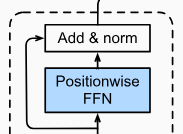

Phần "add & norm" trong Hình 11.7.1 (Transformer) bao gồm một **kết nối dư thừa (residual connection)** ngay sau đó là **layer normalization**. Cả hai đều rất quan trọng trong việc tối ưu hóa các kiến trúc sâu.

Trong Mục 8.5, ta đã giải thích cách **batch normalization** tái chuẩn hóa và điều chỉnh tỷ lệ (recenter and rescale) các giá trị qua các mẫu trong một minibatch. Tuy nhiên, như đã thảo luận trong Mục 8.5.2.3, **layer normalization** có cách hoạt động tương tự batch normalization, nhưng thay vì chuẩn hóa theo các mẫu, nó chuẩn hóa theo **chiều đặc trưng** (feature dimension) theo chiều dimension. Điều này mang lại những lợi ích về tính độc lập với tỷ lệ và kích thước batch, đặc biệt phù hợp với các nhiệm vụ **xử lý ngôn ngữ tự nhiên (NLP)**, nơi đầu vào thường là các chuỗi có độ dài biến đổi. Mặc dù batch normalization thường rất hữu ích trong các bài toán thị giác máy tính (computer vision), nó lại ít hiệu quả hơn so với layer normalization trong các tác vụ NLP.

Phần code ví dụ dưới đây minh họa sự khác nhau giữa **layer normalization** và **batch normalization** qua việc chuẩn hóa trên các chiều khác nhau.

In [ ]:
import torch
from torch import nn as nn



In [ ]:
X = torch.tensor([[1, 2], [2, 3]], dtype=torch.float32)
ln = nn.LayerNorm(2)
bn = nn.LazyBatchNorm1d()
print('layer norm:', ln(X), '\nbatch norm:', bn(X))

layer norm: tensor([[-1.0000,  1.0000],
        [-1.0000,  1.0000]], grad_fn=<NativeLayerNormBackward0>) 
batch norm: tensor([[-1.0000, -1.0000],
        [ 1.0000,  1.0000]], grad_fn=<NativeBatchNormBackward0>)


In stead used Batchnorm1d in cnn, tranformer used layerNorm

why ?


Question 1: Why do we perform normalization?

Answer: Covariate shift

“Internal Covariate Shift is the change in the distribution of network activations due to the change in network parameters during training” — Ioffe & Szegedy [3].

During the training process in the transformer, the outputs produced by neurons in a layer after applying activation function to the weighted sum of inputs is called as activations. The distribution of these activations changes over time due to changes in network parameters.

Normalization mitigate this shift by maintaining stable distribution of activations, which makes the training process smooth!

Question 2: Why not use batch normalization but use Layer Normalization?
Answer: Due to varying length of sentences.

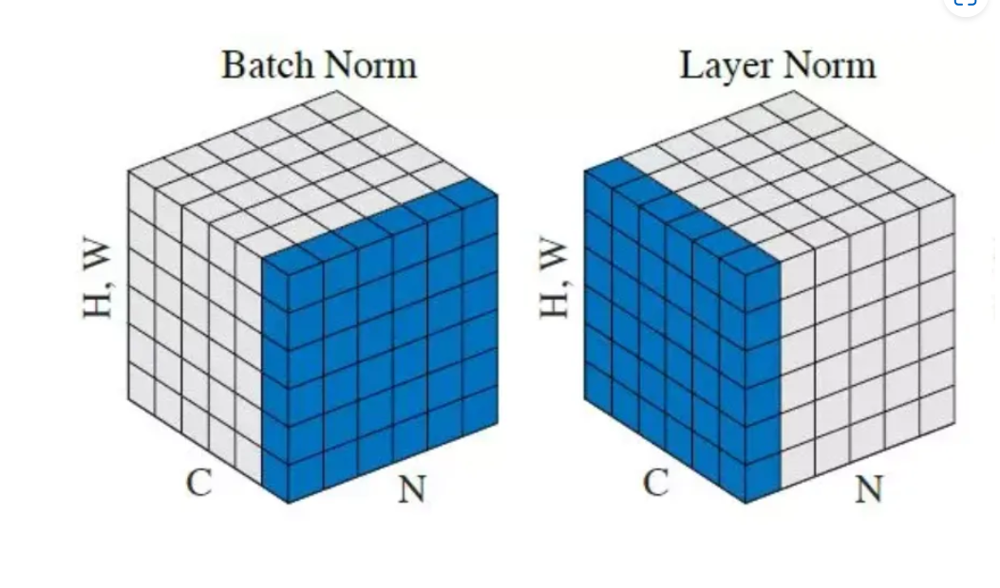

When dealing with sequential data, batch normalization is a not usually recommended because of variable length of the sentences. Batch normalization is applied across a mini-batch. If sequences have a varying length this may require padding or truncation which may introduce noise in the data.

For example lets consider following sentences [4]:
1. I am a boy
2. I love swimming
3. I am a graduate student from a pristine university and currently majoring Data Science.

These sentences will be converted into:

I am a boy [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD]
I love swimming [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD]
I am a graduate student from a pristine university and currently majoring Data Science.
As we can see that the padding tokens are dominating in some sentences, which will result in skewed statistics. This padding issue affects the computation of mean and variances across the mini-batch and thereby introduces noise into the normalization process.

NLP một token có d (tức d đặc trưng) vì vậy việc chuẩn hóa này phụ thuộc vào các đặc được xác định trước(tính độc lập với tỷ lệ và kích thước batch). Đặc biệt phù hợp với các nhiệm vụ xử lý ngôn ngữ tự nhiên (NLP), **nơi đầu vào thường là các chuỗi có độ dài biến đổi**

In [ ]:
class AddNorm(nn.Module):
    """The residual connection followed by layer normalization."""
    def __init__(self, norm_shape, dropout):
        super().__init__()
        self.dropout = nn.Dropout(dropout)
        self.ln = nn.LayerNorm(norm_shape)

    def forward(self, X, Y):
        return self.ln(self.dropout(Y) + X)

In [ ]:
add_norm = AddNorm(4, 0.5)
shape = (2, 3, 4) # batch, num_step, num_hidden = dimension of token
d2l.check_shape(add_norm(torch.ones(shape), torch.ones(shape)), shape)

AttributeError: 'AddNorm' object has no attribute 'norm_shape'

## Encoder

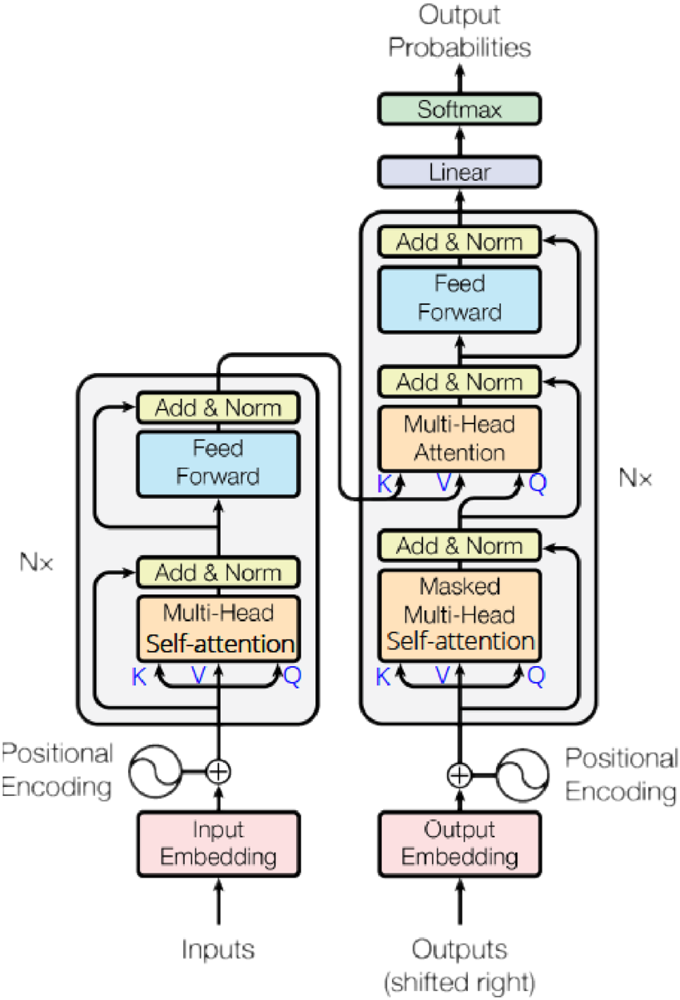

In [ ]:
class TransformerEncoderBlock(nn.Module):
    """The Transformer encoder block."""
    def __init__(self, num_hiddens, ffn_num_hiddens, num_heads, dropout,
                 use_bias=False):
        super().__init__()
        self.attention = d2l.MultiHeadAttention(num_hiddens, num_heads,
                                                dropout, use_bias)
        self.addnorm1 = AddNorm(num_hiddens, dropout)
        self.ffn = PositionWiseFFN(ffn_num_hiddens, num_hiddens)
        self.addnorm2 = AddNorm(num_hiddens, dropout)

    def forward(self, X, valid_lens):
        Y = self.addnorm1(X, self.attention(X, X, X, valid_lens))
        return self.addnorm2(Y, self.ffn(Y))

In [ ]:
X = torch.ones((2, 100, 24))
valid_lens = torch.tensor([3, 2])
encoder_blk = TransformerEncoderBlock(24, 48, 8, 0.5)
encoder_blk.eval()
d2l.check_shape(encoder_blk(X, valid_lens), X.shape)

## Decoder

### Masked Multi-Head Attention

Một layer tương tự như Multi-Head Attention, điểm khác biệt là ở lúc train, khi đã biết rõ output mong muốn để đưa vào làm input của time-step tiếp theo. Để hiểu rõ điều này trước tiên bạn cần biết cách Decoder vận hành, tôi sẽ lấy ví dụ trong bài toán text generate với câu “Tall house with wide door”:

Cũng giống như RNN, Decoder sử dụng output của time-step trước làm input của time-step hiện tại. Tức với ví dụ trên ta sẽ có các bước decode sau:

input = “” qua Masked Multi-Head Attention, nhận thêm thông tin từ Encoder để đưa ra thông tin đầu tiên output = “Tall”.
input = “Tall” → output = “Tall house”.
input = “Tall house” → output = “Tall house with”.
input = “Tall house with” → output = “Tall house with wide”.
input = “Tall house with wide” → output = “Tall house with wide door”.
Mọi thứ sẽ như trên nếu mô hình đã được train xong , nhưng trong quá trình train output ở time-step trước có thể sai khiến output của time-step hiện tại cụng có thể sai theo. Và đương nhiên việc này có thể dần cải thiện trong quá trình train, nhưng sẽ rất tốn tài nguyên. Vị vậy giải pháp được đưa ra là sử dụng output mà chúng ta muốn đưa vào làm input của từng time-step.

Mỗi time-step sẽ nhập input tương ứng nên có ở thời điểm đó, tức sẽ cho biết các từ nên được generate ở thời đó và che đi phần còn lại. Để máy tính hiểu được cách làm trên ta sử dụng Look-ahead Mask là ma trận tam giác dưới với các giá trị 1 biểu thị từ không muốn che, và 0 cho từ muốn che.

Câu trả lời ngắn gọn là: **chúng ta cần che giấu (masking) để giúp quá trình huấn luyện diễn ra song song. Việc song song hóa là tốt vì nó cho phép mô hình huấn luyện nhanh hơn.**

Ví dụ dưới đây giải thích ý tưởng này. Giả sử chúng ta đang huấn luyện để dịch câu "I love you" sang tiếng Đức. Bộ mã hóa (encoder) hoạt động theo chế độ song song - nó có thể tạo ra biểu diễn vector của chuỗi đầu vào ("I love you") trong một số bước cố định (tức là số bước này không phụ thuộc vào độ dài của chuỗi đầu vào).

Giả sử bộ mã hóa tạo ra các số 11, 12, 13 như là các biểu diễn vector của chuỗi đầu vào. Trong thực tế, các vector này sẽ dài hơn nhiều, nhưng để đơn giản hóa, chúng ta sử dụng các số ngắn. Cũng để đơn giản, chúng ta bỏ qua các token phục vụ, như là - bắt đầu chuỗi, - kết thúc chuỗi và các token khác.

Trong quá trình huấn luyện, chúng ta biết rằng bản dịch phải là "Ich liebe dich" (chúng ta luôn biết đầu ra mong muốn trong quá trình huấn luyện). Giả sử biểu diễn vector mong muốn của các từ "Ich liebe dich" lần lượt là 21, 22, 23.

Nếu chúng ta huấn luyện bộ giải mã (decoder) theo chế độ tuần tự, nó sẽ giống như quá trình huấn luyện của Mạng Nơ-ron Tái phát (RNN). Các bước tuần tự sau sẽ được thực hiện:

- Bước tuần tự #1: Đầu vào: 11, 12, 13. Dự đoán 21. Đầu ra dự đoán sẽ không chính xác hoàn toàn là 21, giả sử nó sẽ là 21.1.
- Bước tuần tự #2: Đầu vào: 11, 12, 13, và 21.1 là đầu ra trước đó. Dự đoán 22. Đầu ra dự đoán sẽ không chính xác hoàn toàn là 22, giả sử nó sẽ là 22.3.
- Bước tuần tự #3: Đầu vào: 11, 12, 13, và 22.3 là đầu ra trước đó. Dự đoán 23. Đầu ra dự đoán sẽ không chính xác hoàn toàn là 23, giả sử nó sẽ là 23.5.

Điều này có nghĩa là chúng ta sẽ cần thực hiện 3 bước tuần tự (trong trường hợp tổng quát, một bước tuần tự cho mỗi đầu vào). Ngoài ra, chúng ta sẽ gặp phải lỗi tích lũy ở mỗi lần dự đoán tiếp theo và không sử dụng attention vì chỉ xem xét đầu ra liền trước.

Tuy nhiên, vì chúng ta thực sự biết các đầu ra mong muốn, nên có thể điều chỉnh quá trình và thực hiện nó song song. Không cần phải chờ kết quả từ bước trước.

- Thao tác song song #A: Đầu vào: 11, 12, 13. Dự đoán 21.
- Thao tác song song #B: Đầu vào: 11, 12, 13, và 21. Dự đoán 22.
- Thao tác song song #C: Đầu vào: 11, 12, 13, và 21, 22. Dự đoán 23.

Thuật toán này có thể được thực hiện song song và không tích lũy lỗi. Ngoài ra, nó sử dụng attention (tức là xem xét tất cả các đầu vào trước đó) nên có nhiều thông tin về ngữ cảnh hơn để xem xét trong quá trình dự đoán.

Và đây là lý do chúng ta cần masking. Thuật toán huấn luyện biết toàn bộ đầu ra mong muốn (21, 22, 23). Nó sẽ che giấu (mask) một phần của chuỗi đầu ra đã biết này trong mỗi lần thao tác song song.

- **Khi thực hiện thao tác #A - nó sẽ che giấu toàn bộ đầu ra.**
- **Khi thực hiện thao tác #B - nó che giấu đầu ra thứ 2 và thứ 3.**
- **Khi thực hiện thao tác #C - nó che giấu đầu ra thứ 3.**

Masking được triển khai bằng cách đặt giá trị -∞ cho tất cả các giá trị đầu vào của softmax mà tương ứng với các kết nối không hợp lệ.

Lưu ý: Trong quá trình suy luận (inference), bộ giải mã hoạt động ở chế độ tuần tự (không song song) vì nó không biết chuỗi đầu ra ban đầu. Tuy nhiên, nó khác với cách tiếp cận của RNN vì Transformer vẫn sử dụng self-attention và xem xét tất cả các đầu ra trước đó (không chỉ xem xét đầu ra liền trước).

Lưu ý 2: Masking có thể được sử dụng theo cách khác cho các ứng dụng không phải là dịch thuật. Ví dụ, trong mô hình ngôn ngữ, masking có thể được sử dụng để che giấu một số từ trong câu đầu vào và mô hình sẽ cố gắng dự đoán chúng trong quá trình huấn luyện bằng cách sử dụng các từ khác không bị che giấu (tức là học cách hiểu ngữ cảnh).

Như được minh họa trong Hình 11.7.1, bộ giải mã (decoder) của Transformer bao gồm nhiều lớp giống hệt nhau. Mỗi lớp được triển khai trong lớp TransformerDecoderBlock sau đây, bao gồm ba lớp con: self-attention của bộ giải mã, attention giữa bộ mã hóa và bộ giải mã, và mạng truyền thẳng theo vị trí (positionwise feed-forward networks). Các lớp con này sử dụng kết nối dư (residual connection) xung quanh chúng, sau đó là chuẩn hóa theo lớp (layer normalization).

Như chúng tôi đã mô tả trước đó trong phần này, trong cơ chế self-attention đa đầu bị che (masked multi-head self-attention) của bộ giải mã (lớp con đầu tiên), các truy vấn (queries), khóa (keys), và giá trị (values) đều xuất phát từ các đầu ra của lớp giải mã trước đó. Khi huấn luyện các mô hình sequence-to-sequence, các token ở tất cả các vị trí (các bước thời gian) của chuỗi đầu ra đều đã biết. Tuy nhiên, trong quá trình dự đoán, chuỗi đầu ra được tạo từng token một; do đó, tại mỗi bước thời gian của bộ giải mã, chỉ các token đã được tạo ra mới có thể được sử dụng trong cơ chế self-attention của bộ giải mã. Để duy trì tính tự hồi quy (autoregression) trong bộ giải mã, self-attention bị che của nó chỉ định dec_valid_lens để bất kỳ truy vấn nào cũng chỉ tham chiếu đến tất cả các vị trí trong bộ giải mã cho đến vị trí truy vấn.

https://towardsdatascience.com/illustrated-guide-to-transformers-step-by-step-explanation-f74876522bc0

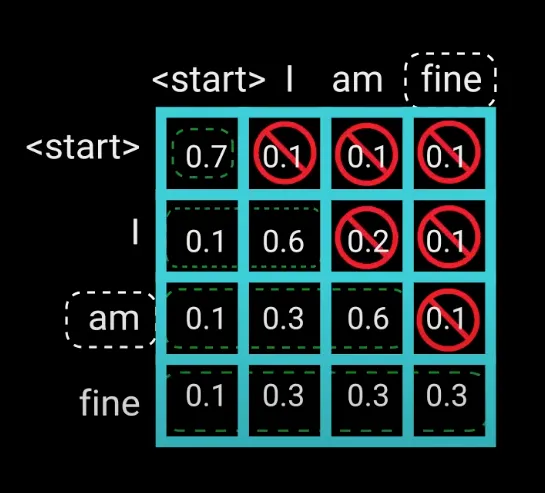

Decoder có được thực hiện như một model autogression tức là lấy chỉ có thể chú ý và tìm các từ trước đó, để dự đoán một từ tương lai.

Từ hình trên có thể minh họa từ 'am' chỉ có thể nhận chú ý từ các từ trước đó, và nó không thể nhận được từ tương lai ở một model augression,vì vậy để từ 'am' có thể học được từ những từ prev để dự đoán từ tiếp theo cần phải mask (che giấu) từ 'fine'. Ngoài che giấu (masking) để giúp quá trình huấn luyện diễn ra song song. Việc song song hóa là tốt vì nó cho phép mô hình huấn luyện nhanh hơn.

Cách Masked Multi-Head Attention hoạt động : bằng method Look-Ahead Mask

The mask is a matrix that’s the same size as the attention scores filled with values of 0’s and negative infinities. When you add the mask to the scaled attention scores, you get a matrix of the scores, with the top right triangle filled with negativity infinities. [Mặt nạ là một ma trận có cùng kích thước với điểm chú ý chứa đầy các giá trị 0 và vô số âm. Khi bạn thêm mặt nạ vào điểm chú ý được chia tỷ lệ, bạn sẽ nhận được ma trận điểm số, với hình tam giác trên cùng bên phải chứa đầy vô số tiêu cực.]

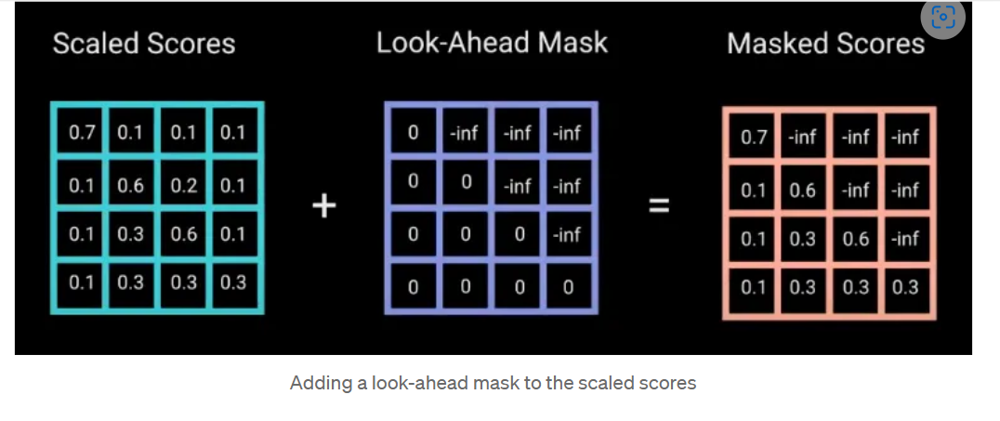

The reason for the mask is because once you take the softmax of the masked scores, the negative infinities get zeroed out, leaving zero attention scores for future tokens. As you can see in the figure below, the attention scores for “am”, has values for itself and all words before it but is zero for the word “fine”. This essentially tells the model to put no focus on those words. [Lý do cho mặt nạ là vì một khi bạn lấy softmax của các điểm bị che, các giá trị âm vô cực sẽ bị loại bỏ, để lại điểm chú ý bằng 0 cho các mã thông báo trong tương lai. Như bạn có thể thấy trong hình bên dưới, điểm chú ý đối với “am”, có giá trị cho chính nó và tất cả các từ trước nó nhưng bằng 0 đối với từ “ổn”. Về cơ bản, điều này yêu cầu mô hình không tập trung vào những từ đó.]

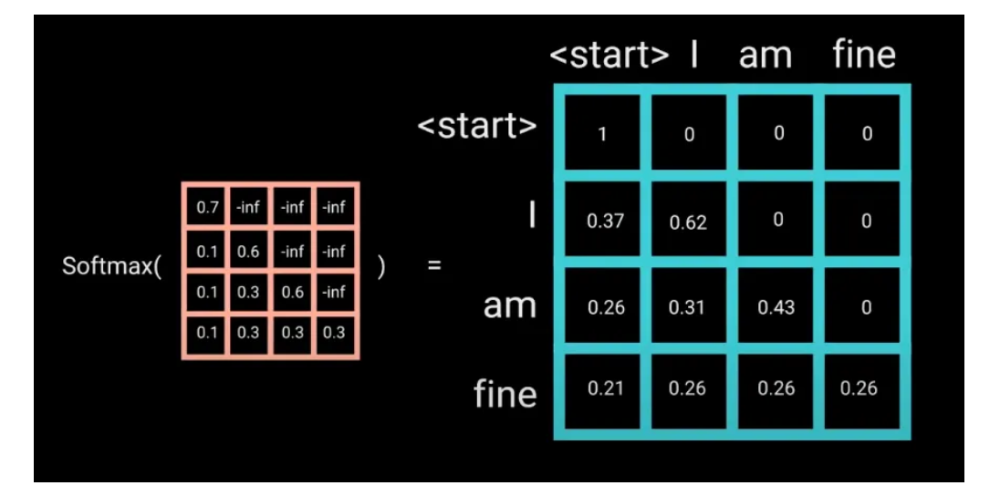

This masking is the only difference in how the attention scores are calculated in the first multi-headed attention layer. This layer still has multiple heads, that the mask is being applied to, before getting concatenated and fed through a linear layer for further processing. The output of the first multi-headed attention is a masked output vector with information on how the model should attend on the decoder’s input. [Việc che giấu này là điểm khác biệt duy nhất trong cách tính điểm chú ý trong lớp chú ý nhiều đầu đầu tiên. Lớp này vẫn có nhiều đầu mà mặt nạ đang được áp dụng trước khi được nối và đưa qua một lớp tuyến tính để xử lý tiếp. Đầu ra của sự chú ý nhiều đầu đầu tiên là một vectơ đầu ra được che dấu với thông tin về cách mô hình sẽ tham gia vào đầu vào của bộ giải mã.]

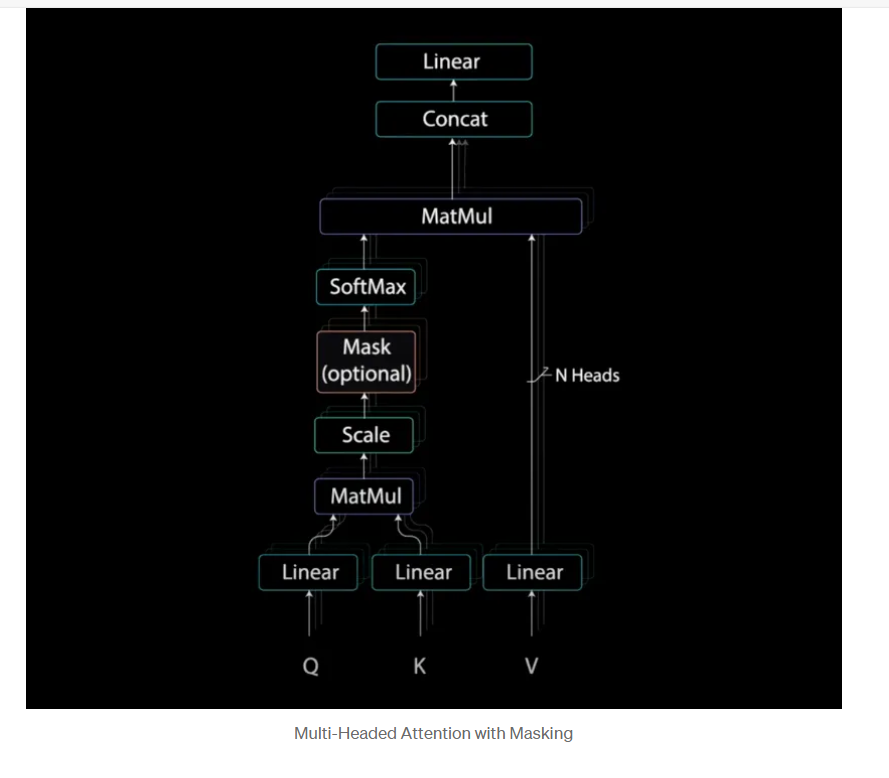

Kiến trúc của một Masked Multi- Headed Attention

In [ ]:
class TransformerDecoderBlock(nn.Module):
    # The i-th block in the Transformer decoder
    def __init__(self, num_hiddens, ffn_num_hiddens, num_heads, dropout, i):
        super().__init__()
        self.i = i
        self.attention1 = d2l.MultiHeadAttention(num_hiddens, num_heads,
                                                 dropout)
        self.addnorm1 = AddNorm(num_hiddens, dropout)
        self.attention2 = d2l.MultiHeadAttention(num_hiddens, num_heads,
                                                 dropout)
        self.addnorm2 = AddNorm(num_hiddens, dropout)
        self.ffn = PositionWiseFFN(ffn_num_hiddens, num_hiddens)
        self.addnorm3 = AddNorm(num_hiddens, dropout)

    def forward(self, X, state):
        enc_outputs, enc_valid_lens = state[0], state[1]
        # During training, all the tokens of any output sequence are processed
        # at the same time, so state[2][self.i] is None as initialized. When
        # decoding any output sequence token by token during prediction,
        # state[2][self.i] contains representations of the decoded output at
        # the i-th block up to the current time step
        if state[2][self.i] is None:
            key_values = X
        else:
            key_values = torch.cat((state[2][self.i], X), dim=1)
        state[2][self.i] = key_values
        if self.training:
            batch_size, num_steps, _ = X.shape
            # Shape of dec_valid_lens: (batch_size, num_steps), where every
            # row is [1, 2, ..., num_steps]
            dec_valid_lens = torch.arange(
                1, num_steps + 1, device=X.device).repeat(batch_size, 1)
        else:
            dec_valid_lens = None
        # Self-attention
        X2 = self.attention1(X, key_values, key_values, dec_valid_lens)
        Y = self.addnorm1(X, X2)
        # Encoder-decoder attention. Shape of enc_outputs:
        # (batch_size, num_steps, num_hiddens)
        Y2 = self.attention2(Y, enc_outputs, enc_outputs, enc_valid_lens)
        Z = self.addnorm2(Y, Y2)
        return self.addnorm3(Z, self.ffn(Z)), state

In [ ]:
decoder_blk = TransformerDecoderBlock(24, 48, 8, 0.5, 0)
X = torch.ones((2, 100, 24))
state = [encoder_blk(X, valid_lens), valid_lens, [None]]
d2l.check_shape(decoder_blk(X, state)[0], X.shape)

In [ ]:
class TransformerDecoder(d2l.AttentionDecoder):
    def __init__(self, vocab_size, num_hiddens, ffn_num_hiddens, num_heads,
                 num_blks, dropout):
        super().__init__()
        self.num_hiddens = num_hiddens
        self.num_blks = num_blks
        self.embedding = nn.Embedding(vocab_size, num_hiddens)
        self.pos_encoding = d2l.PositionalEncoding(num_hiddens, dropout)
        self.blks = nn.Sequential()
        for i in range(num_blks):
            self.blks.add_module("block"+str(i), TransformerDecoderBlock(
                num_hiddens, ffn_num_hiddens, num_heads, dropout, i))
        self.dense = nn.LazyLinear(vocab_size)

    def init_state(self, enc_outputs, enc_valid_lens):
        return [enc_outputs, enc_valid_lens, [None] * self.num_blks]

    def forward(self, X, state):
        X = self.pos_encoding(self.embedding(X) * math.sqrt(self.num_hiddens))
        self._attention_weights = [[None] * len(self.blks) for _ in range (2)]
        for i, blk in enumerate(self.blks):
            X, state = blk(X, state)
            # Decoder self-attention weights
            self._attention_weights[0][
                i] = blk.attention1.attention.attention_weights
            # Encoder-decoder attention weights
            self._attention_weights[1][
                i] = blk.attention2.attention.attention_weights
        return self.dense(X), state

    @property
    def attention_weights(self):
        return self._attention_weights

## Traninng

In [ ]:
data = d2l.MTFraEng(batch_size=128)
num_hiddens, num_blks, dropout = 256, 2, 0.2
ffn_num_hiddens, num_heads = 64, 4
encoder = TransformerEncoder(
    len(data.src_vocab), num_hiddens, ffn_num_hiddens, num_heads,
    num_blks, dropout)
decoder = TransformerDecoder(
    len(data.tgt_vocab), num_hiddens, ffn_num_hiddens, num_heads,
    num_blks, dropout)
model = d2l.Seq2Seq(encoder, decoder, tgt_pad=data.tgt_vocab['<pad>'],
                    lr=0.001)
trainer = d2l.Trainer(max_epochs=30, gradient_clip_val=1, num_gpus=1)
trainer.fit(model, data)

In [ ]:
engs = ['go .', 'i lost .', 'he\'s calm .', 'i\'m home .']
fras = ['va !', 'j\'ai perdu .', 'il est calme .', 'je suis chez moi .']
preds, _ = model.predict_step(
    data.build(engs, fras), d2l.try_gpu(), data.num_steps)
for en, fr, p in zip(engs, fras, preds):
    translation = []
    for token in data.tgt_vocab.to_tokens(p):
        if token == '<eos>':
            break
        translation.append(token)
    print(f'{en} => {translation}, bleu,'
          f'{d2l.bleu(" ".join(translation), fr, k=2):.3f}')

In [ ]:
_, dec_attention_weights = model.predict_step(
    data.build([engs[-1]], [fras[-1]]), d2l.try_gpu(), data.num_steps, True)
enc_attention_weights = torch.cat(model.encoder.attention_weights, 0)
shape = (num_blks, num_heads, -1, data.num_steps)
enc_attention_weights = enc_attention_weights.reshape(shape)
d2l.check_shape(enc_attention_weights,
                (num_blks, num_heads, data.num_steps, data.num_steps))

In [ ]:
dec_attention_weights_2d = [head[0].tolist()
                            for step in dec_attention_weights
                            for attn in step for blk in attn for head in blk]
dec_attention_weights_filled = torch.tensor(
    pd.DataFrame(dec_attention_weights_2d).fillna(0.0).values)
shape = (-1, 2, num_blks, num_heads, data.num_steps)
dec_attention_weights = dec_attention_weights_filled.reshape(shape)
dec_self_attention_weights, dec_inter_attention_weights = \
    dec_attention_weights.permute(1, 2, 3, 0, 4)

d2l.check_shape(dec_self_attention_weights,
                (num_blks, num_heads, data.num_steps, data.num_steps))
d2l.check_shape(dec_inter_attention_weights,
                (num_blks, num_heads, data.num_steps, data.num_steps))

In [ ]:
d2l.show_heatmaps(
    dec_self_attention_weights[:, :, :, :],
    xlabel='Key positions', ylabel='Query positions',
    titles=['Head %d' % i for i in range(1, 5)], figsize=(7, 3.5))

In [ ]:
d2l.show_heatmaps(
    dec_inter_attention_weights, xlabel='Key positions',
    ylabel='Query positions', titles=['Head %d' % i for i in range(1, 5)],
    figsize=(7, 3.5))

## Exercise :

https://pandalab.me/archives/transformer_architecture

Cải thiện hiệu quả transformer : https://arxiv.org/pdf/2009.06732